<a href="https://colab.research.google.com/github/TAFFI98/Real2Sim_ROS_Doosan/blob/main/Learn%20to%20See/Autoencoders_AE_CVAE/ae_burr_to_contour.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Convolutional Autoencoder

*(In this script you'll find references to VAE for some variables, but the structure of the autoencoder is not variational, it's just a to distinguish from the GAN variables)*

## Setup

In [ ]:
import glob
import imageio
import numpy as np
from sklearn.decomposition import PCA
import cv2
from IPython.display import display, clear_output, HTML, Image as Image_display
import base64
import PIL
from PIL import Image
import tensorflow as tf
from tensorflow.keras.layers import (InputLayer, Conv2D, Conv2DTranspose,
            BatchNormalization,ReLU, LeakyReLU, Dropout, MaxPooling2D, UpSampling2D,
            Reshape, GlobalAveragePooling2D, Layer, Conv2D, Dense, Flatten)
from tensorflow.keras.models import Model
from tensorflow.keras.losses import binary_crossentropy
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt
import time
import gc
import os
import io
from functools import reduce
import ipywidgets as widgets
import math as m

## Loading the datasets

In [ ]:
# Mount drive
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


### Loading functions and datset management

In [ ]:
def parse_tfrecord_fn(example_proto):
    feature_description = {
        'image1': tf.io.FixedLenFeature([], tf.string),
        'image2': tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example_proto, feature_description)

    # Decode the JPEG images
    image1 = tf.io.decode_jpeg(example['image1'], channels=1)  # Assuming grayscale images
    image2 = tf.io.decode_jpeg(example['image2'], channels=1)  # Assuming grayscale images

    # Normalize the images if needed
    image1 = tf.cast(image1, tf.float32) / 255.0
    image2 = tf.cast(image2, tf.float32) / 255.0

    # Expand the dimensions
    image1 = tf.expand_dims(image1, axis=0)
    image2 = tf.expand_dims(image2, axis=0)

    return image1, image2
def parse_tfrecord_fn_cgan(example_proto):
    feature_description = {
        'image1': tf.io.FixedLenFeature([], tf.string),
        'image2': tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example_proto, feature_description)

    # Decode the JPEG images
    image1 = tf.io.decode_jpeg(example['image1'], channels=3)  # Assuming rgb images
    image2 = tf.io.decode_jpeg(example['image2'], channels=1)  # Assuming grayscale images

    # Normalize the images if needed
    image1 = tf.cast(image1, tf.float32) / 255.0
    image2 = tf.cast(image2, tf.float32) / 255.0

    # Expand the dimensions
    image1 = tf.expand_dims(image1, axis=0)
    image2 = tf.expand_dims(image2, axis=0)

    return image1, image2
def load_dataset_from_tfrecord(filename, type):
    dataset = tf.data.TFRecordDataset(filename)
    if type == 'cgan':
      dataset = dataset.map(parse_tfrecord_fn_cgan, num_parallel_calls=tf.data.AUTOTUNE)
    elif type == 'vae':
      dataset = dataset.map(parse_tfrecord_fn, num_parallel_calls=tf.data.AUTOTUNE)
    return dataset

In [ ]:
# Check dataset info
def check_dataset_info(dataset, name_dataset, return_length=False):
  dataset_length = dataset.reduce(0, lambda x, _: x + 1) # to avoid long time due to iteration
  dataset_length = dataset_length.numpy()
  # Get image resolution
  for input, tar in dataset.take(1):
    image_h = input[0].shape[0]
    image_w = input[0].shape[1]
    image_resol = (image_h, image_w)
  # Get the element spec of the dataset
  element_spec = dataset.element_spec
  # Extract the shape information from the element spec
  batch_size = element_spec[0].shape[0]
  print(f'\033[1mDataset\033[0m:\033[4m{name_dataset}\033[0m | Size: {dataset_length}, Image resol.:{image_resol}, Batch_size: {batch_size}')
  print('____________________________________________________________________________________________________________')
  if return_length:
    return dataset_length

### Load the original dataset for cGAN
This dataset was created for the cGAN that proficiently segmented the burrs form the rgb soles of the image.

In [ ]:
#512x512 images
# Simulation images datasets
cgan_train_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_train_dataset_sim.tfrecord', type='cgan') # 20000 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_val_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_val_dataset_sim.tfrecord', type='cgan') # 500 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_test_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_test_dataset_sim.tfrecord', type='cgan') # 40 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_test_dataset_sim_from_gazebo = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/sim/cgan_test_dataset_sim_from_gazebo.tfrecord', type='cgan') # 50 (rgb sole images, ground-truth binary burr images), batch_size=1, taken directly from gazebo camera

# Real images datasets
cgan_train_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/real/cgan_train_dataset_real.tfrecord', type='cgan') # 500 (rgb sole images, ground-truth binary burr images), batch_size=1
cgan_test_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/cgan/real/cgan_test_dataset_real.tfrecord', type='cgan') # 46 (rgb sole images, ground-truth binary burr images), batch_size=1


In [ ]:
# Check loaded cgan datasets info
check_dataset_info(cgan_train_dataset_sim, 'Training sim dataset for CGAN (cgan_train_dataset_sim)')
check_dataset_info(cgan_val_dataset_sim, 'Validation sim dataset for CGAN (cgan_val_dataset_sim)')
check_dataset_info(cgan_test_dataset_sim, 'Test sim dataset for CGAN (cgan_test_dataset_sim)')
check_dataset_info(cgan_test_dataset_sim_from_gazebo, 'Test sim from gazebo dataset for CGAN (cgan_test_dataset_sim_from_gazebo)')

check_dataset_info(cgan_train_dataset_real, 'Training real dataset for CGAN (cgan_train_dataset_real)')
check_dataset_info(cgan_test_dataset_real, 'Test real dataset for CGAN (cgan_test_dataset_real)')

Dataset:Training sim dataset for CGAN (cgan_train_dataset_sim) | Size: 20000, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Validation sim dataset for CGAN (cgan_val_dataset_sim) | Size: 500, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim dataset for CGAN (cgan_test_dataset_sim) | Size: 40, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim from gazebo dataset for CGAN (cgan_test_dataset_sim_from_gazebo) | Size: 50, Image resol.:(512, 512), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Training real dataset for CGAN (cgan_train_dataset_real) | Size: 500, Image resol.

### Collect the processed dataset for vae

This dataset was created from procesing with the cGAN that proficiently segmented the burrs form the rgb soles of the image. In this context the input images will be the predicted one with the trained cGAN (processed binary burrs). While the ground truth will be the external edges of these burrs obtained through image processing.

In [ ]:
#240x320 images
# Simulation images datasets
vae_train_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_train_dataset_sim.tfrecord', type='vae') # 20000 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_val_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_val_dataset_sim.tfrecord', type='vae') # 500 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_test_dataset_sim = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_test_dataset_sim.tfrecord', type='vae') # 40 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_test_dataset_sim_from_gazebo = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/sim/vae_test_dataset_sim_from_gazebo.tfrecord', type='vae') # 50 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1, taken directly from gazebo camera

# Real images datasets
vae_train_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/real/vae_train_dataset_real.tfrecord', type='vae') # 500 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1
vae_test_dataset_real = load_dataset_from_tfrecord('drive/MyDrive/Colab_Notebooks/datasets/vae/real/vae_test_dataset_real.tfrecord', type='vae') # 46 (processed binary burr images, ground-truth extracted burr contour binary images), batch_size=1


Concatenate simulation and real vae datasets for training

In [ ]:
vae_val_dataset = vae_val_dataset_sim # 500 sim images processed
vae_train_dataset = tf.data.Dataset.concatenate(vae_train_dataset_sim, vae_train_dataset_real) # overall dtrainig datset with processed images (sim+real)

In [ ]:
# Check loaded cvae datasets info
dataset_length = check_dataset_info(vae_train_dataset, 'Training dataset for CVAE (vae_train_dataset)', return_length=True)
check_dataset_info(vae_val_dataset, 'Validation (sim) dataset for CVAE (vae_val_dataset)')
check_dataset_info(vae_test_dataset_sim, 'Test sim dataset for CVAE (vae_test_dataset_sim)')
check_dataset_info(vae_test_dataset_sim_from_gazebo, 'Test sim from gazebo dataset for CVAE (vae_test_dataset_sim_from_gazebo)')
check_dataset_info(vae_test_dataset_real, 'Test real dataset for CVAE (vae_test_dataset_real)')

Dataset:Training dataset for CVAE (vae_train_dataset) | Size: 20500, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Validation (sim) dataset for CVAE (vae_val_dataset) | Size: 500, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim dataset for CVAE (vae_test_dataset_sim) | Size: 40, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test sim from gazebo dataset for CVAE (vae_test_dataset_sim_from_gazebo) | Size: 50, Image resol.:(240, 320), Batch_size: 1
____________________________________________________________________________________________________________
Dataset:Test real dataset for CVAE (vae_test_dataset_real) | Size: 46, Image resol.:(240, 320), Batch_si

Create combined dataset for test plots

In [ ]:
combined_test_sim = tf.data.Dataset.zip((cgan_test_dataset_sim, vae_test_dataset_sim))
combined_test_sim_from_gazebo =  tf.data.Dataset.zip((cgan_test_dataset_sim_from_gazebo, vae_test_dataset_sim_from_gazebo))
combined_test_real =  tf.data.Dataset.zip((cgan_test_dataset_real, vae_test_dataset_real))

Test the loaded dataset (processed images)

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


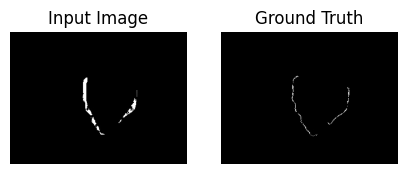

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


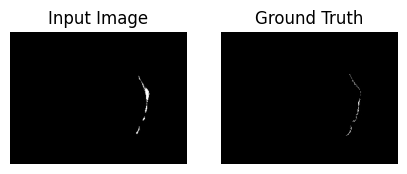

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


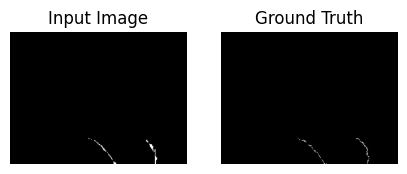

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


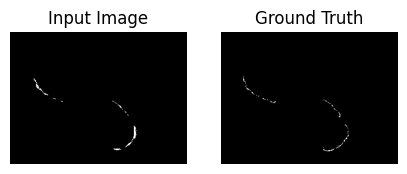

Input_shape (1, 240, 320, 1)
Gt shape (1, 240, 320, 1)


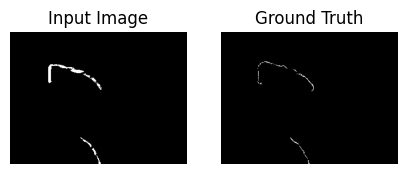

In [ ]:
for test_input, tar in vae_train_dataset.take(5):
  plt.figure(figsize=(5,5))
  print('Input_shape', test_input.shape)
  print('Gt shape',tar.shape)
  display_list = [test_input[0], tar[0]]

  title = ['Input Image', 'Ground Truth']
  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i], cmap='gray')
    plt.axis('off')
  plt.show()

## CAE

### Define the encoder and decoder networks with *tf.keras.Sequential*


In [ ]:
IMG_HEIGHT_VAE = 240
IMG_WIDTH_VAE = 320
input_shape = (IMG_HEIGHT_VAE, IMG_WIDTH_VAE,  1)
def ConvLRelu(filters, kernelSize, strides=1):
    # Define Convolutional layer followed by LeakyReLU
    return tf.keras.Sequential([
        Conv2D(filters, kernelSize, strides=strides, padding='same'),
        LeakyReLU()
    ])

def ConvTranspose(filters, kernelSize, strides=1, dropout_rate=0.5, activation=None):
    # Define Convolutional Transpose layer followed by dropout
    return tf.keras.Sequential([
        UpSampling2D(size=(2, 2)),
        Conv2D(filters, kernelSize, strides=strides, padding='same', activation=activation),
        Dropout(dropout_rate)
    ])

class CAE(tf.keras.Model):
    """Convolutional autoencoder."""

    def __init__(self, dropout_rate=0.5):
        super(CAE, self).__init__()

        self.dropout_rate = dropout_rate
        # Encoder structure
        self.encoder = tf.keras.Sequential(
            [

                tf.keras.layers.InputLayer(input_shape=input_shape),
                ConvLRelu(filters=32, kernelSize=7, strides=2), #( IMG_HEIGHT/2,IMG_WIDTH/2, 32) # Use at thebeginning big kernels, since the shapes are fine. White pixels at the strict center would give more weight and only zeros around it would give it more weight as well
                ConvLRelu(filters=64, kernelSize=7, strides=2), #(IMG_HEIGHT/4, IMG_WIDTH/4, 128)
                ConvLRelu(filters=128, kernelSize=5, strides=2), #(IMG_HEIGHT/8, IMG_WIDTH/8, 128)
                ConvLRelu(filters=64, kernelSize=3), #(IMG_HEIGHT/8, IMG_WIDTH/8, 64)
                ConvLRelu(filters=128, kernelSize=5), #(IMG_HEIGHT/8, IMG_WIDTH/8, 128)
                ConvLRelu(filters=256, kernelSize=5, strides=2), #(IMG_HEIGHT/16, IMG_WIDTH/16, 256)
                ConvLRelu(filters=128, kernelSize=3), #(IMG_HEIGHT/16, IMG_WIDTH/16, 128)
                ConvLRelu(filters=256, kernelSize=5), #(IMG_HEIGHT/16, IMG_WIDTH/16, 256)
                ConvLRelu(filters=128, kernelSize=5), #(IMG_HEIGHT/16, IMG_WIDTH/16, 128)
                ConvLRelu(filters=64, kernelSize=3), #(IMG_HEIGHT/16, IMG_WIDTH/16, 64)
                ConvLRelu(filters=32, kernelSize=3), #(IMG_HEIGHT/16, IMG_WIDTH/16, 32)
                Conv2D(filters=1, kernel_size=3, strides=1, padding='same'), #(IMG_HEIGHT/16, IMG_WIDTH/16, 1)
                tf.keras.layers.Flatten()
            ]
        )

        self.decoder = tf.keras.Sequential(
            [
              InputLayer(input_shape=(IMG_HEIGHT_VAE//16* IMG_WIDTH_VAE//16*  1)),
              tf.keras.layers.Reshape(target_shape=(IMG_HEIGHT_VAE//16, IMG_WIDTH_VAE//16, 1)),
              ConvTranspose(filters=256, kernelSize=3, activation='relu'),
              ConvTranspose(filters=128, kernelSize=3, activation='relu'),
              ConvTranspose(filters=64, kernelSize=3, activation='relu'),
              ConvTranspose(filters=32, kernelSize=3, activation='relu'),
              Conv2DTranspose(filters=1, kernel_size=3, strides=1, padding='same')
            ]
        )

    def encode(self, x):
        return self.encoder(x)


    def decode(self, z):
        return self.decoder(z)


#### Loss implementation

In [ ]:
# Learning rate decay schedule
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-5)

# Loss for the encoder-decoder (CAE)
def compute_loss(model, x, y):
    z = model.encode(x)
    y_pred = model.decode(z)
    reconstruction_loss = tf.keras.losses.mean_squared_error(y, y_pred)
    return tf.reduce_mean(reconstruction_loss)

@tf.function
def train_step(model, x, y, optimizer):
  """Executes one training step and returns the loss.

  This function computes the loss and gradients, and uses the latter to
  update the model's parameters.
  """
  with tf.GradientTape() as tape:
    loss = compute_loss(model, x, y)
  gradients = tape.gradient(loss, model.trainable_variables)
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  # Apply gradient clipping
  #clipped_gradients, _ = tf.clip_by_global_norm(gradients, clip_norm=1.0)

  #optimizer.apply_gradients(zip(clipped_gradients, model.trainable_variables))


### Build model

In [ ]:

# model
model = CAE()


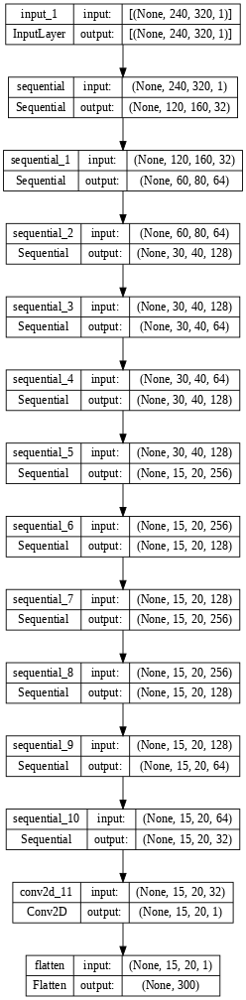

In [ ]:
encoder = model.encoder
tf.keras.utils.plot_model(encoder, show_shapes=True, dpi=64)

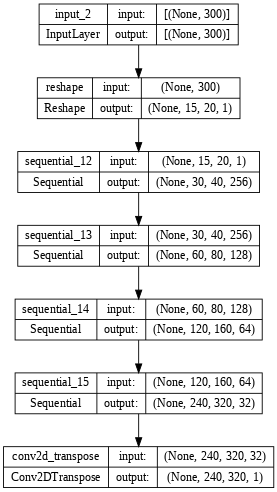

In [ ]:
decoder = model.decoder
tf.keras.utils.plot_model(decoder, show_shapes=True, dpi=64)

## TRAINING

### Training configuration

* Start by iterating over the dataset
* During each iteration, pass the image to the encoder to obtain a set of mean and log-variance parameters of the approximate posterior $q(z|x)$
* then apply the *reparameterization trick* to sample from $q(z|x)$
* Finally, pass the reparameterized samples to the decoder to obtain the logits of the generative distribution $p(x|z)$


### Generating images

* Start by sampling a set of latent vectors from the unit Gaussian prior distribution $p(z)$
* The generator will then convert the latent sample $z$ to logits of the observation, giving a distribution $p(x|z)$



In [ ]:
def generate_images(model,cgan_input_image, cgan_target, burr, cont):
  z = model.encode(burr)
  decoded_example = model.decode(z)


  # show the input of cgan (rgb image), the ground-truth binary burr area for cgan, the processed burr (input for vae), the ground truth contour for vae, the decoded image with trained vae
  plt.figure(figsize=(15, 15))
  display_list = [cgan_input_image[0], cgan_target[0], burr[0], cont[0], decoded_example[0]]
  title = ['Input cGAN image', 'GT cGAN', 'AE Input Image', 'AE Ground Truth', 'AE Predicted Image']

  for i in range(5):
    plt.subplot(1, 5, i+1)
    plt.title(title[i])
    if i>0:
      plt.imshow(display_list[i], cmap='gray')
    else:
      plt.imshow(display_list[i] )
    plt.axis('off')
  plt.show()

def generate_composite_images(model,test_cgan_sim, test_vae_sim, test_cgan_sim_gaz, test_vae_sim_gaz,test_cgan_real, test_vae_real):

  cgan_input_image, cgan_target = test_cgan_sim
  burr, cont = test_vae_sim
  generate_images(model,cgan_input_image, cgan_target, burr, cont)
  cgan_input_image, cgan_target = test_cgan_sim_gaz
  burr, cont = test_vae_sim_gaz
  generate_images(model,cgan_input_image, cgan_target, burr, cont)
  cgan_input_image, cgan_target = test_cgan_real
  burr, cont = test_vae_real
  generate_images(model,cgan_input_image, cgan_target, burr, cont)

In [ ]:
def fit(train_ds, val_dataset, combined_test_sim, combined_test_sim_from_gazebo, combined_test_real, steps, epochs, checkpoint_dir, checkpoint_prefix):

  start = time.time()

  # Tests images for plotting
  test_cgan_sim, test_vae_sim = next(iter(combined_test_sim.take(1)))
  test_cgan_sim_gaz, test_vae_sim_gaz = next(iter(combined_test_sim_from_gazebo.take(1)))
  test_cgan_real, test_vae_real = next(iter(combined_test_real.take(1)))
  val_inp_img, val_target = next(iter(val_dataset.take(1)))
  train_losses = []
  val_losses = []
  gazebo_losses = []
  real_losses = []
  loss = tf.keras.metrics.Mean()
  loss_val = tf.keras.metrics.Mean()
  loss_gaz = tf.keras.metrics.Mean()
  loss_real = tf.keras.metrics.Mean()
  ds_len = steps//epochs
  for step, (input_image, target) in train_ds.repeat().take(tf.cast(steps, tf.int64)).enumerate():

    if (step) % 1000 == 0:
      #display.clear_output(wait=True)
      # Loss for training images
      loss(compute_loss(model, input_image, target))
      elbo = loss.result()
      train_losses.append(elbo)
      # Loss for validation images
      loss_val(compute_loss(model, val_inp_img, val_target))
      val_elbo = loss_val.result()
      val_losses.append(val_elbo)
      # Loss for sim gazebo images
      inp_gaz, tar_gaz = test_vae_sim_gaz
      loss_gaz(compute_loss(model, inp_gaz, tar_gaz))
      gaz_elbo = loss_gaz.result()
      gazebo_losses.append(gaz_elbo)
      # Loss for real images
      inp_real, tar_real = test_vae_real
      loss_real(compute_loss(model, inp_real, tar_real))
      real_elbo = loss_real.result()
      real_losses.append(real_elbo)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')
      epoch = step//ds_len + 1
      print(f"[Epochs-interval: {epoch}/{epochs}]__Step: {step//1000}k/{steps//1000}k")
      print('Train set ELBO: {}'.format(-elbo))

      generate_composite_images(model,test_cgan_sim, test_vae_sim, test_cgan_sim_gaz, test_vae_sim_gaz,test_cgan_real, test_vae_real) # plot some test images

      # SAVE MODEL AND PARTIAL LOSSES
      save_list_to_pickle(train_losses, checkpoint_dir+"/loss_tot.pickle")
      save_list_to_pickle(val_losses, checkpoint_dir+"/val_loss_tot.pickle")
      save_list_to_pickle(gazebo_losses, checkpoint_dir+"/gazebo_loss_tot.pickle")
      save_list_to_pickle(real_losses, checkpoint_dir+"/real_loss_tot.pickle")



      # Save weights and optimizer's state
      model.save_weights(checkpoint_prefix)

    train_step(model, input_image, target, optimizer)

    # Training step
    if (step+1) % 10 == 0:

      print('.', end='', flush=True)


  return train_losses, val_losses, gazebo_losses, real_losses


In [ ]:
import pickle

def save_list_to_pickle(my_list, filename):
    """
    Save a list to a pickle file.

    Parameters:
    my_list (list): The list to be saved.
    filename (str): The filename to save the pickle file.

    Returns:
    None
    """
    # Open the file in binary write mode
    with open(filename, 'wb') as file:
        # Dump the list into the file using pickle.dump()
        pickle.dump(my_list, file)

def load_list_from_pickle(file_path):
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
    return data


### Run Training

In [ ]:
# TRAINING settings
epochs = 6
STEPS = dataset_length*epochs
# CHECKPOINTS
# =================
checkpoint_dir = 'drive/MyDrive/Colab_Notebooks/v8_extra/checkpoints_cae/ckpt_cae_flatten'
if not os.path.exists(checkpoint_dir):
    # Create the directory
    os.makedirs(checkpoint_dir)
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt"+"_cvae_epoch"+ str(epochs))

[Epochs-interval: 1/6]__Step: 0k/123k
Train set ELBO: -0.0026810590643435717


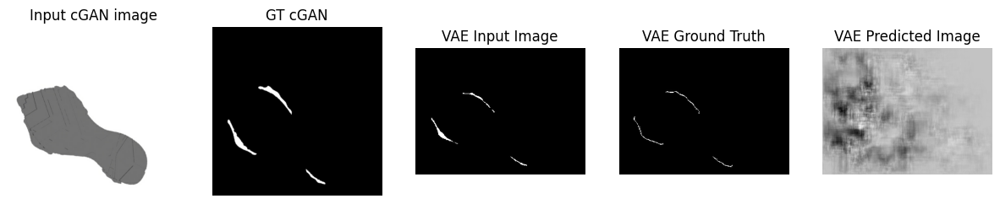

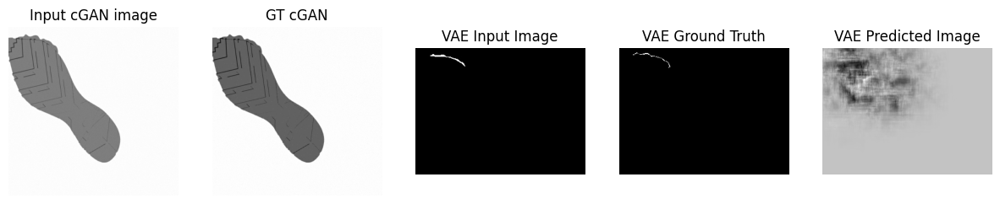

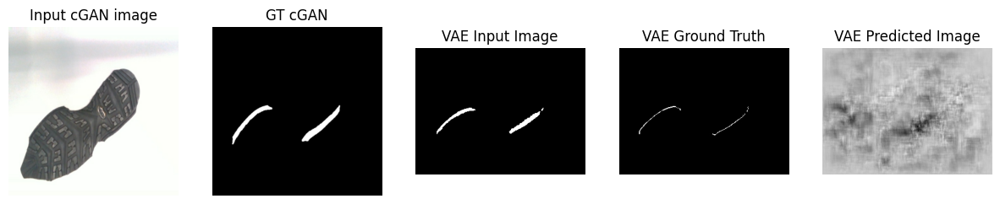

....................................................................................................Time taken for 1000 steps: 24.62 sec

[Epochs-interval: 1/6]__Step: 1k/123k
Train set ELBO: -0.002859257161617279


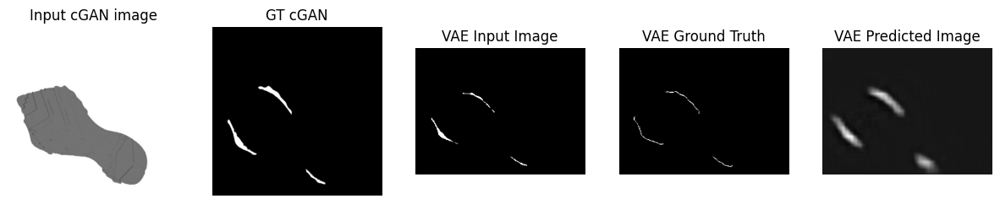

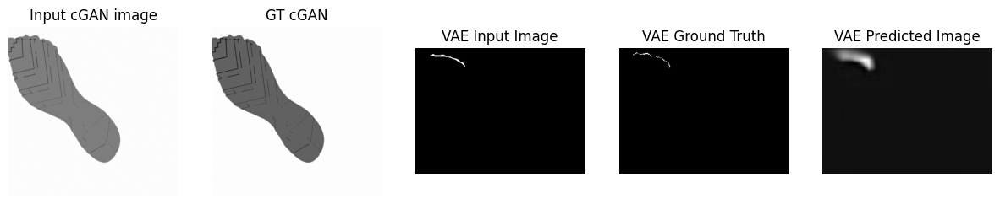

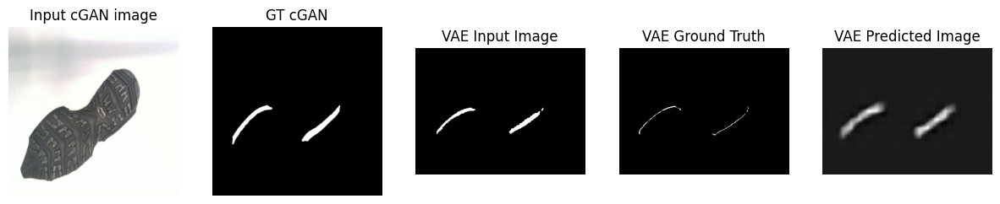

....................................................................................................Time taken for 1000 steps: 43.44 sec

[Epochs-interval: 1/6]__Step: 2k/123k
Train set ELBO: -0.002367687178775668


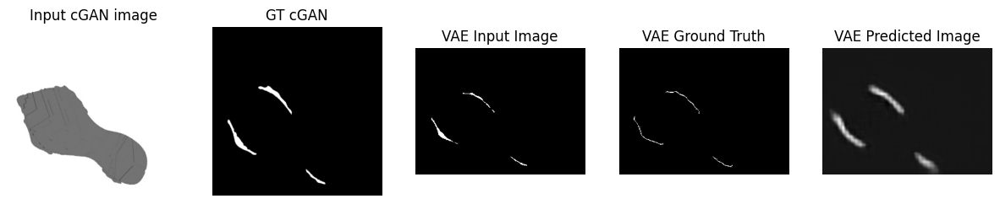

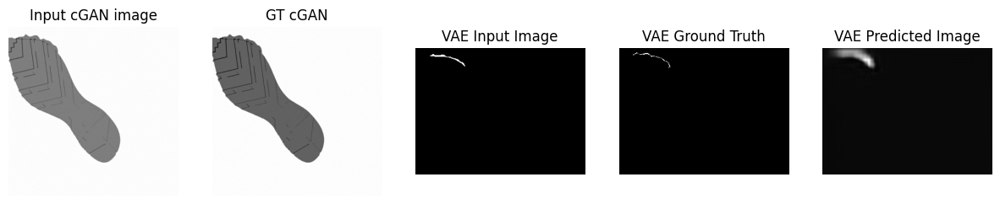

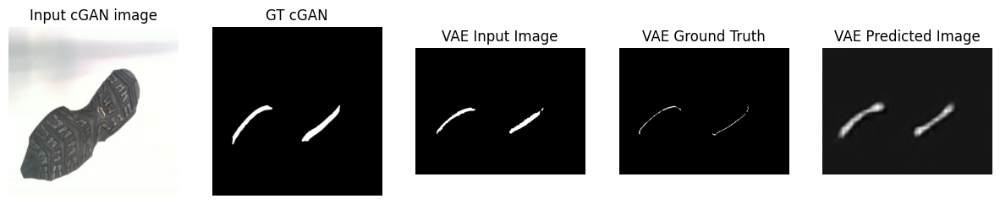

....................................................................................................Time taken for 1000 steps: 62.77 sec

[Epochs-interval: 1/6]__Step: 3k/123k
Train set ELBO: -0.00229087402112782


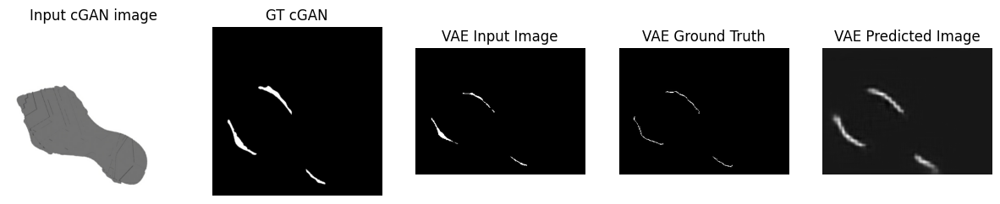

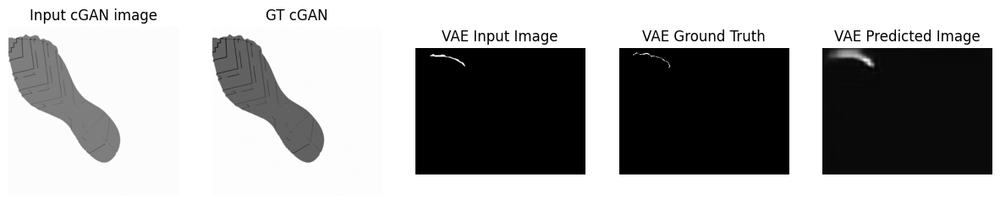

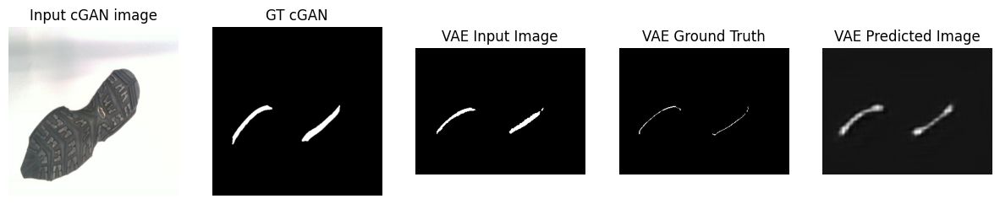

....................................................................................................Time taken for 1000 steps: 81.47 sec

[Epochs-interval: 1/6]__Step: 4k/123k
Train set ELBO: -0.001927474862895906


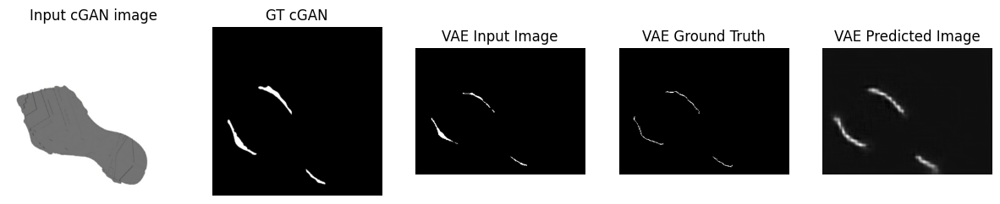

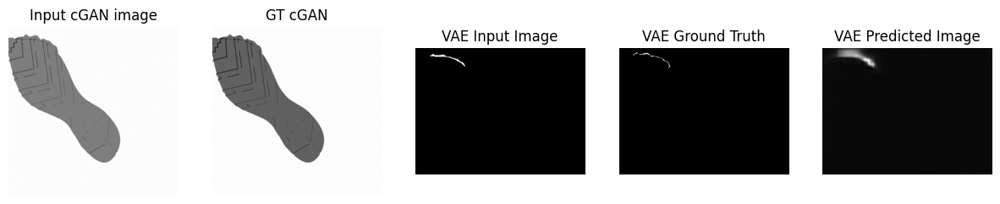

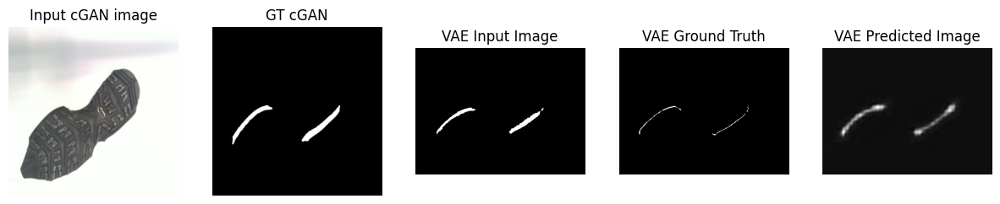

....................................................................................................Time taken for 1000 steps: 100.78 sec

[Epochs-interval: 1/6]__Step: 5k/123k
Train set ELBO: -0.0018318440997973084


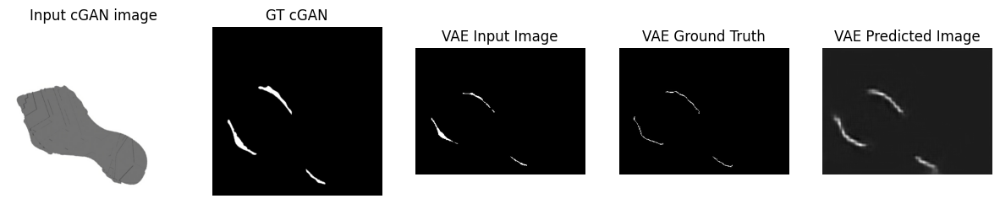

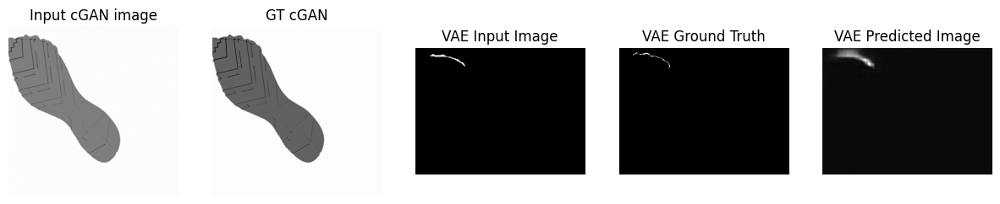

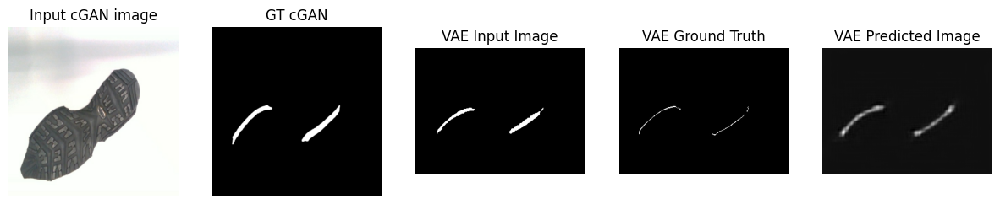

....................................................................................................Time taken for 1000 steps: 120.57 sec

[Epochs-interval: 1/6]__Step: 6k/123k
Train set ELBO: -0.0018256482435390353


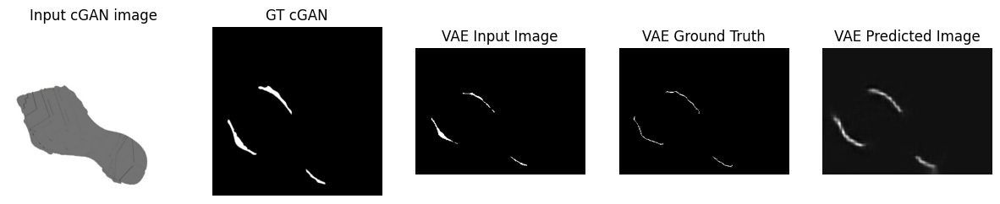

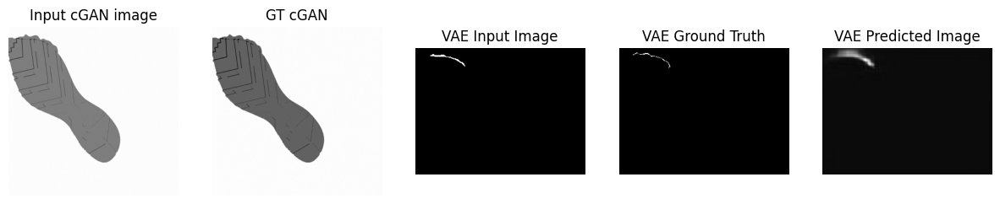

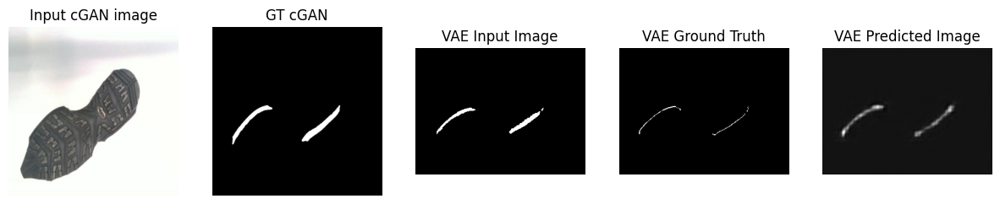

....................................................................................................Time taken for 1000 steps: 140.18 sec

[Epochs-interval: 1/6]__Step: 7k/123k
Train set ELBO: -0.001755104516632855


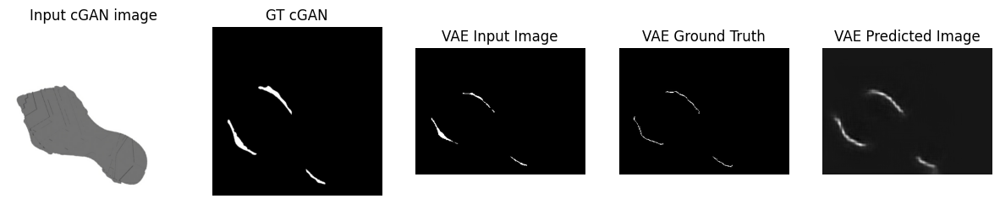

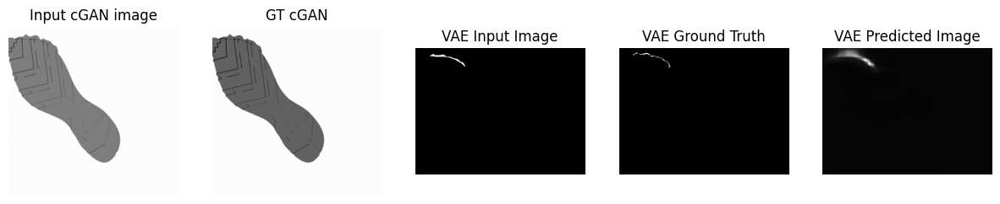

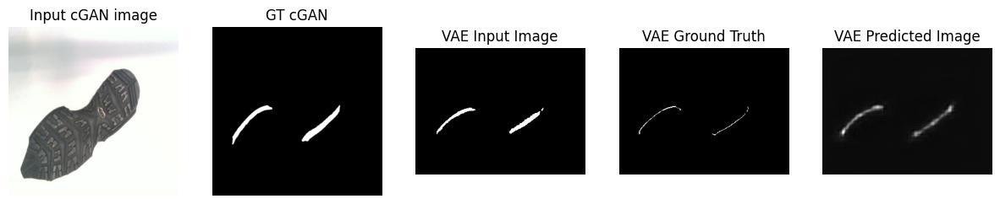

....................................................................................................Time taken for 1000 steps: 159.00 sec

[Epochs-interval: 1/6]__Step: 8k/123k
Train set ELBO: -0.0015601027989760041


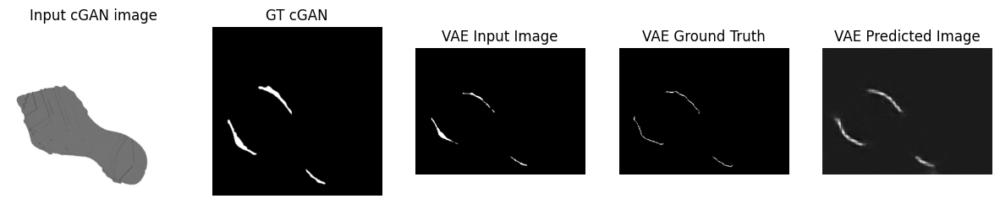

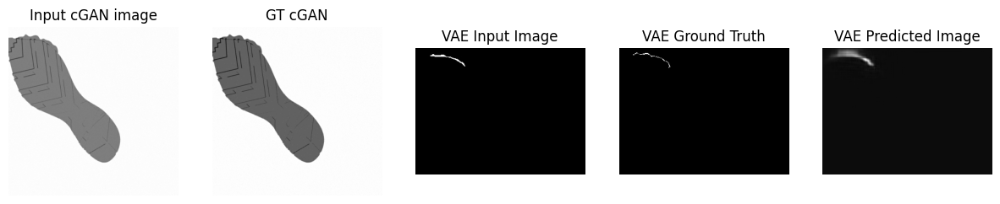

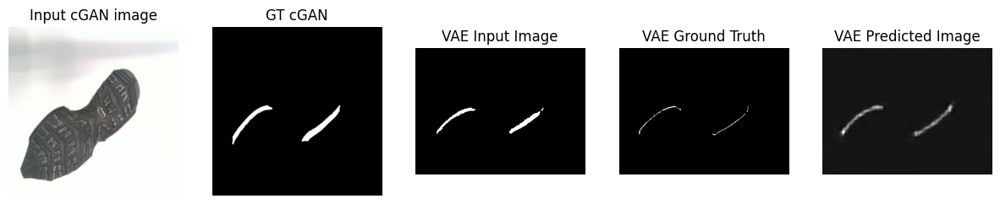

....................................................................................................Time taken for 1000 steps: 177.96 sec

[Epochs-interval: 1/6]__Step: 9k/123k
Train set ELBO: -0.0014705939684063196


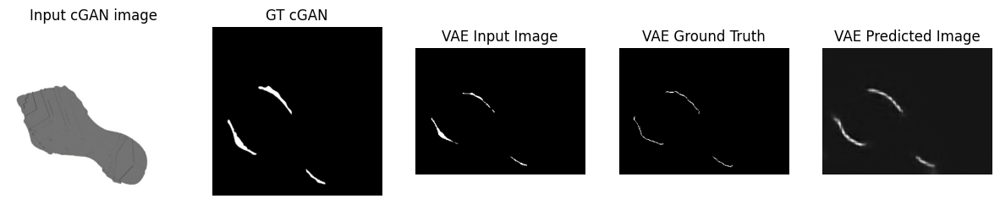

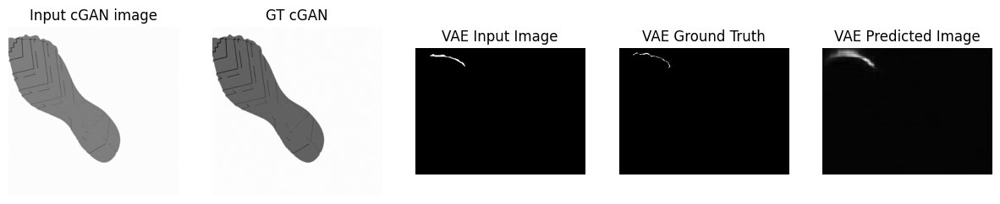

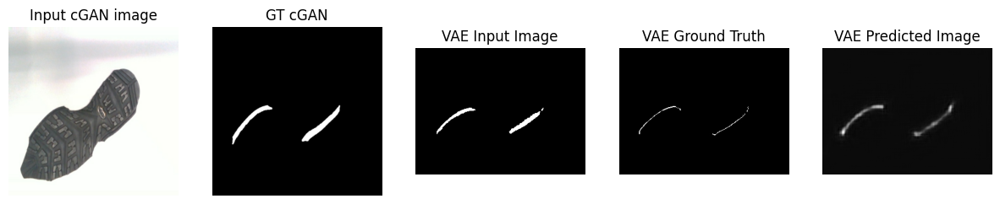

....................................................................................................Time taken for 1000 steps: 197.60 sec

[Epochs-interval: 1/6]__Step: 10k/123k
Train set ELBO: -0.0015038811834529042


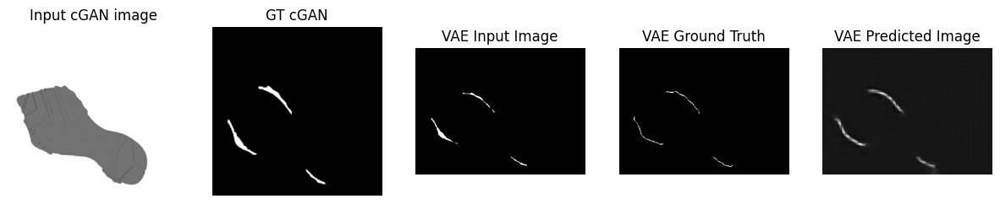

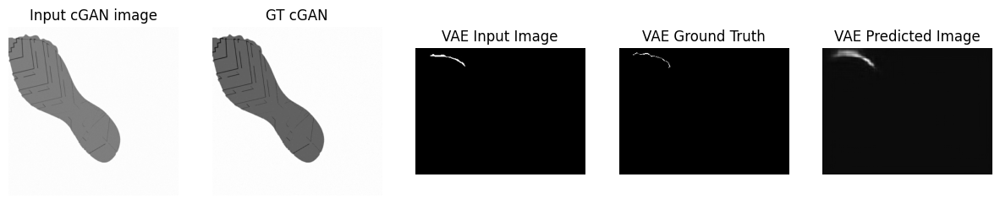

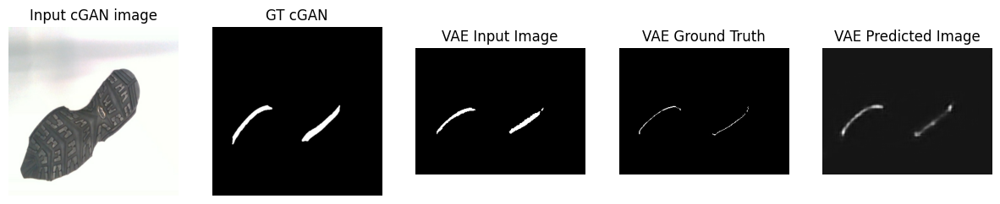

....................................................................................................Time taken for 1000 steps: 216.94 sec

[Epochs-interval: 1/6]__Step: 11k/123k
Train set ELBO: -0.001555323600769043


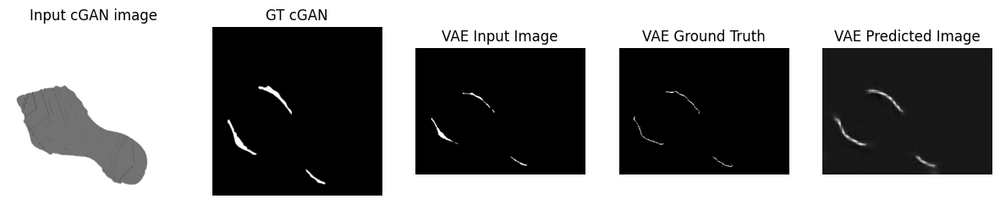

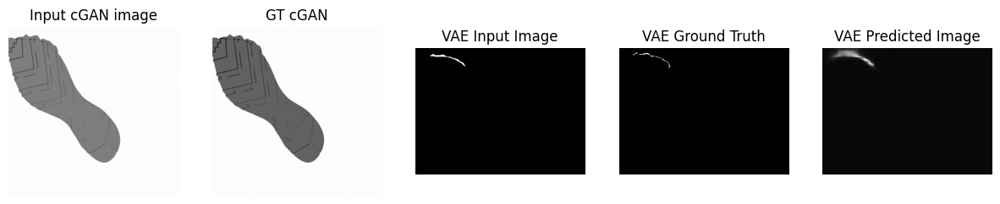

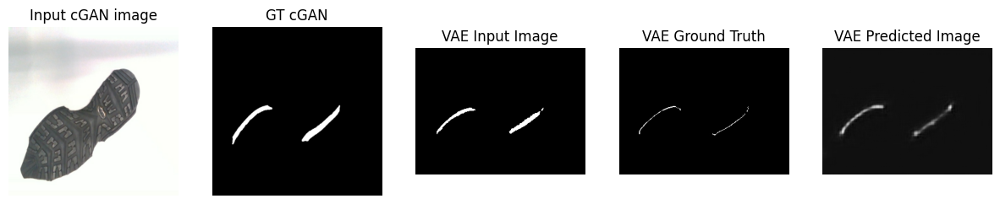

....................................................................................................Time taken for 1000 steps: 236.63 sec

[Epochs-interval: 1/6]__Step: 12k/123k
Train set ELBO: -0.001467981724999845


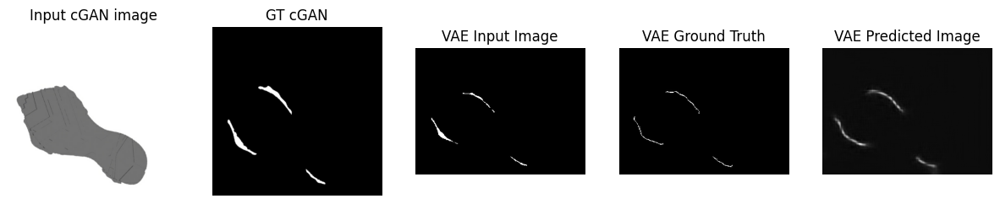

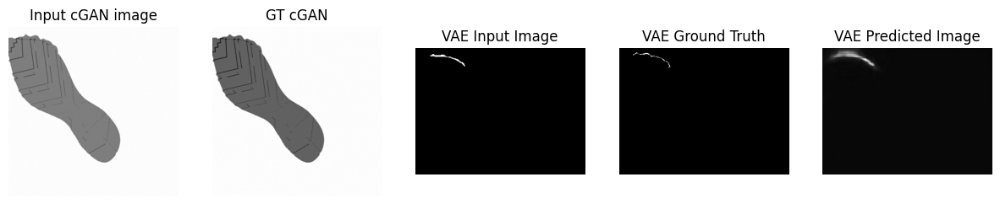

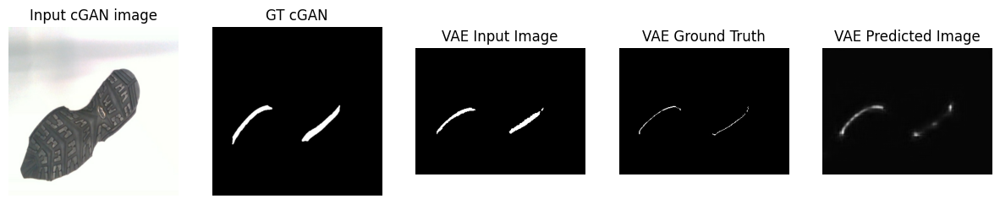

....................................................................................................Time taken for 1000 steps: 255.53 sec

[Epochs-interval: 1/6]__Step: 13k/123k
Train set ELBO: -0.0015628489200025797


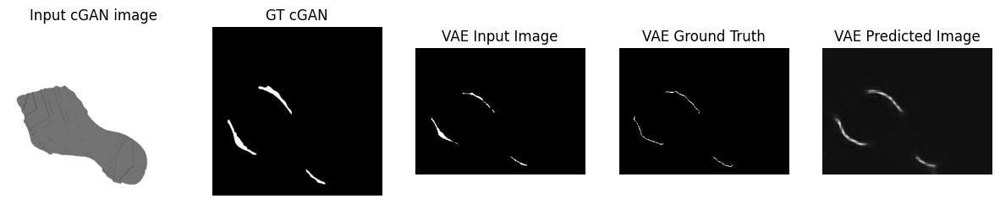

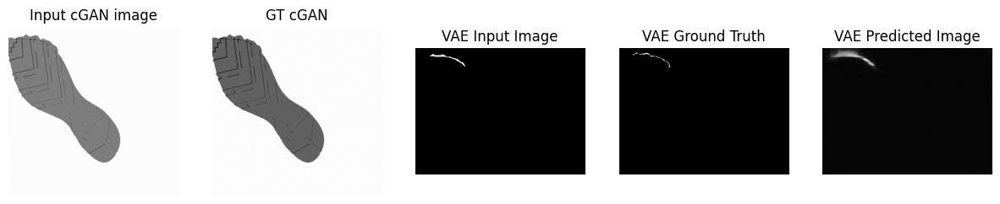

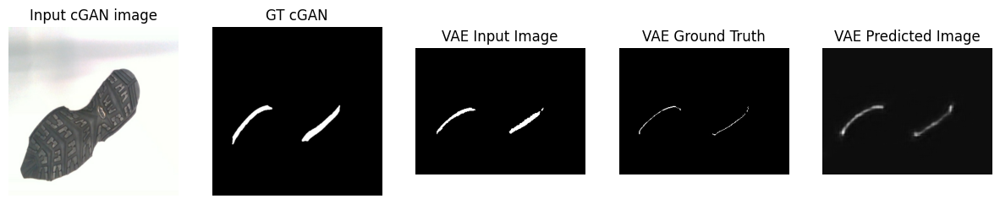

....................................................................................................Time taken for 1000 steps: 274.66 sec

[Epochs-interval: 1/6]__Step: 14k/123k
Train set ELBO: -0.0016476233722642064


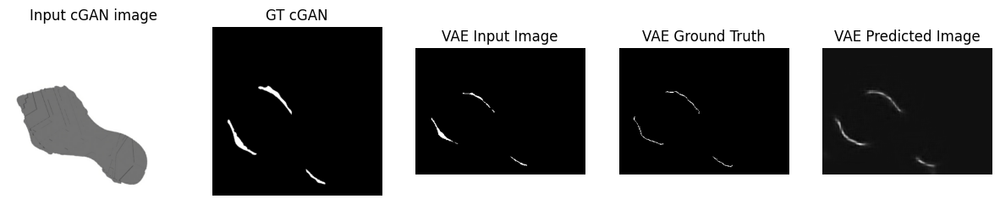

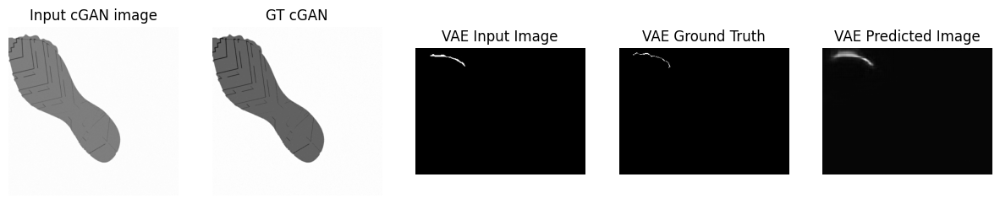

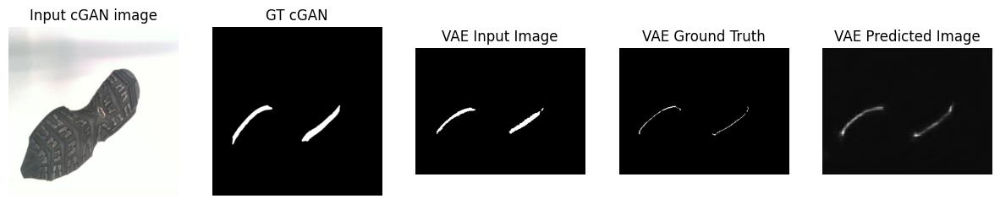

....................................................................................................Time taken for 1000 steps: 293.62 sec

[Epochs-interval: 1/6]__Step: 15k/123k
Train set ELBO: -0.001601861440576613


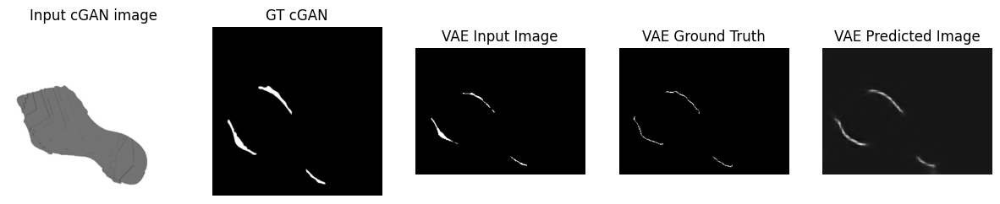

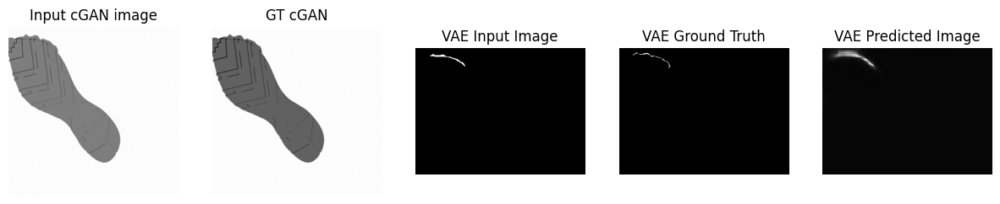

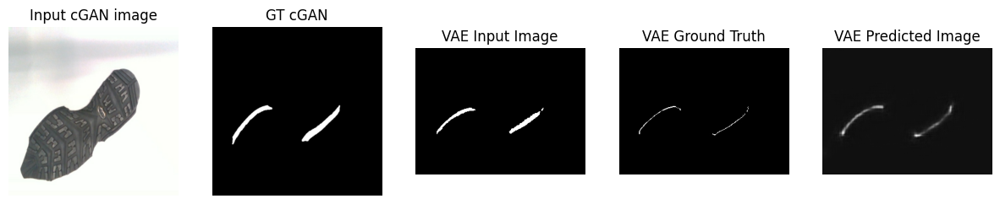

....................................................................................................Time taken for 1000 steps: 313.42 sec

[Epochs-interval: 1/6]__Step: 16k/123k
Train set ELBO: -0.0015738348010927439


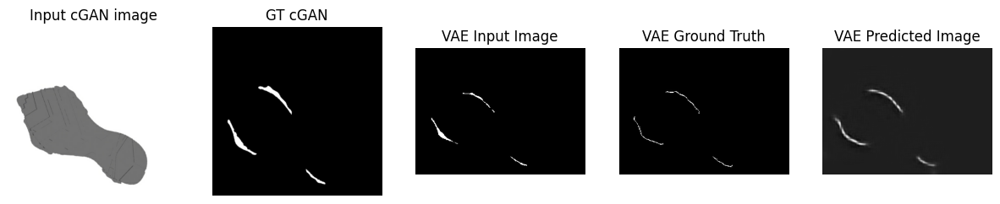

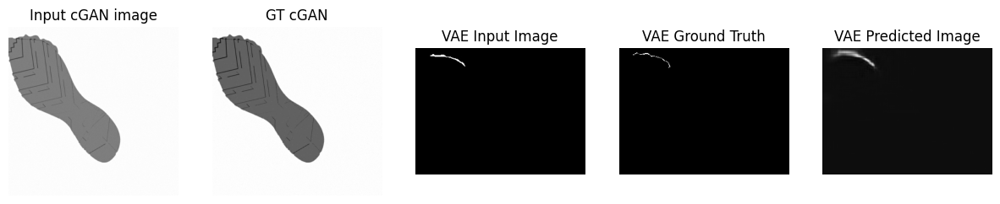

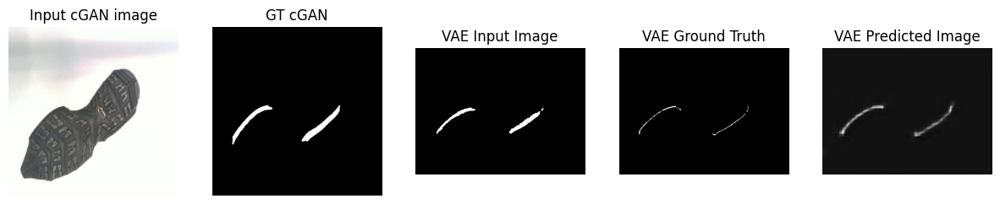

....................................................................................................Time taken for 1000 steps: 332.91 sec

[Epochs-interval: 1/6]__Step: 17k/123k
Train set ELBO: -0.0015376590890809894


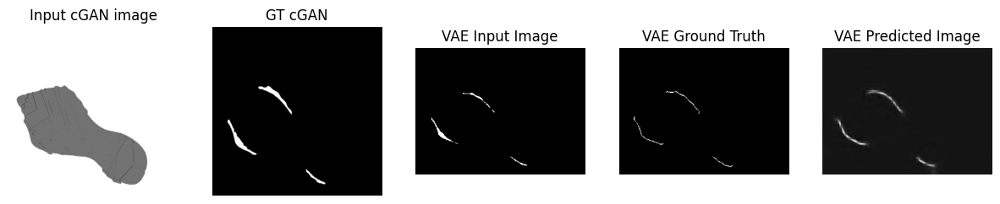

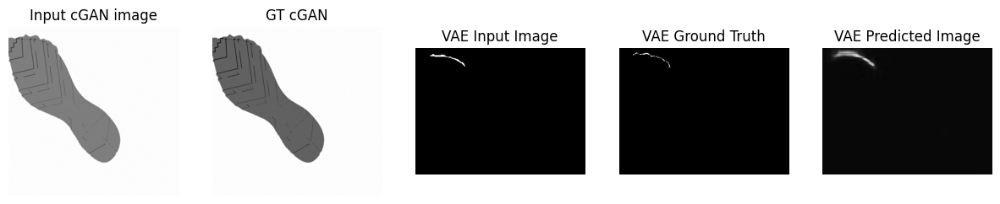

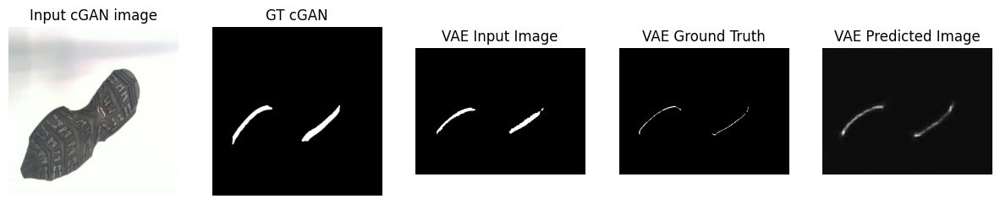

....................................................................................................Time taken for 1000 steps: 351.94 sec

[Epochs-interval: 1/6]__Step: 18k/123k
Train set ELBO: -0.0015691472217440605


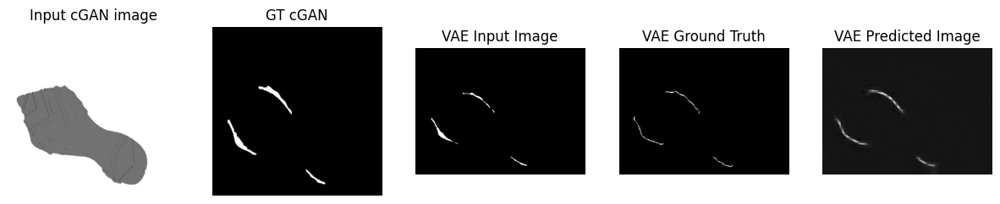

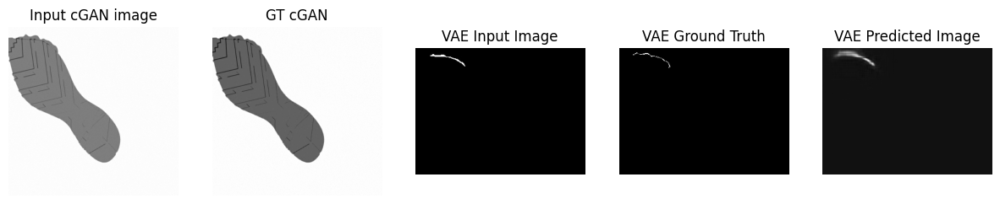

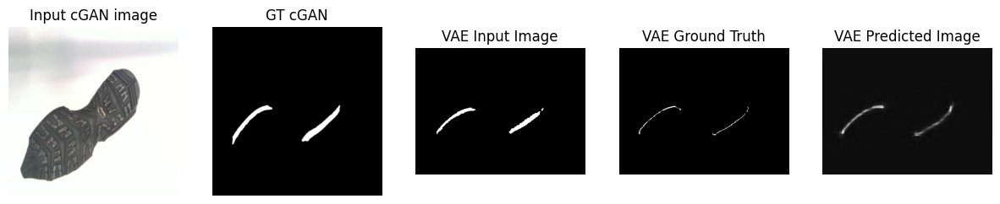

....................................................................................................Time taken for 1000 steps: 371.88 sec

[Epochs-interval: 1/6]__Step: 19k/123k
Train set ELBO: -0.0015894705429673195


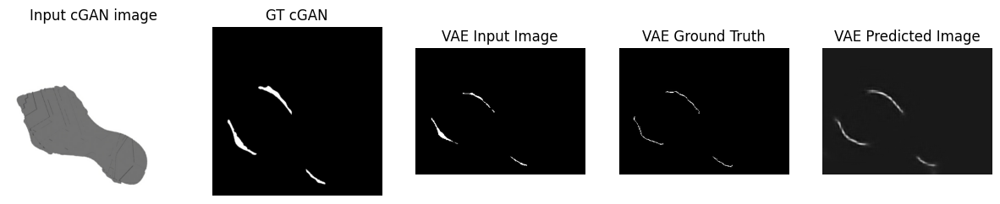

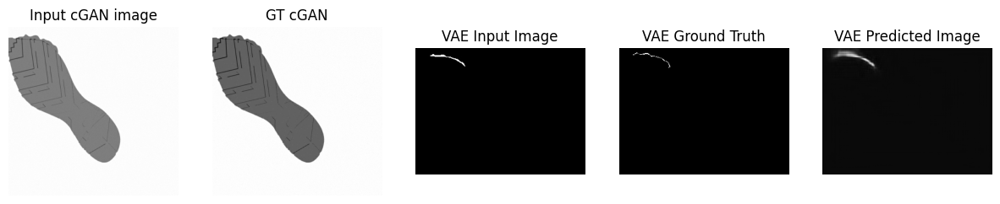

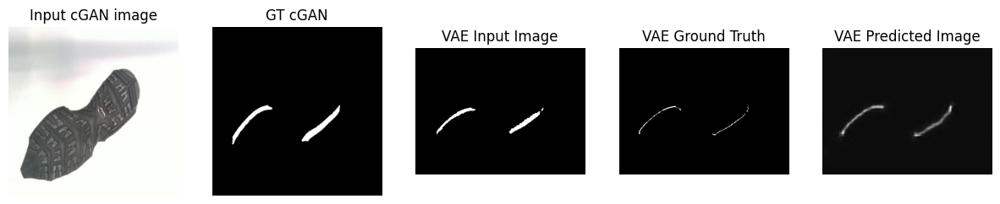

....................................................................................................Time taken for 1000 steps: 391.37 sec

[Epochs-interval: 1/6]__Step: 20k/123k
Train set ELBO: -0.001692351303063333


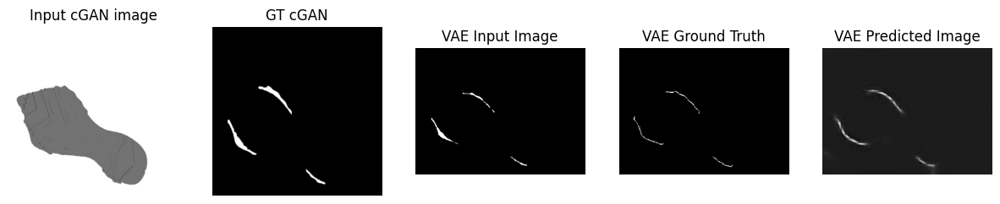

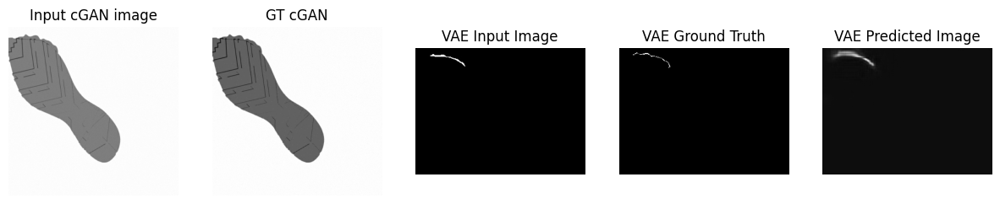

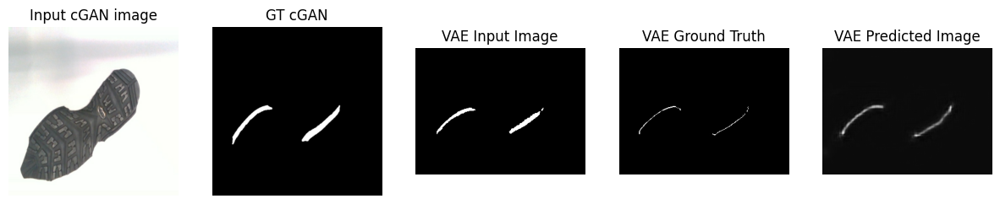

....................................................................................................Time taken for 1000 steps: 410.77 sec

[Epochs-interval: 2/6]__Step: 21k/123k
Train set ELBO: -0.0016187806613743305


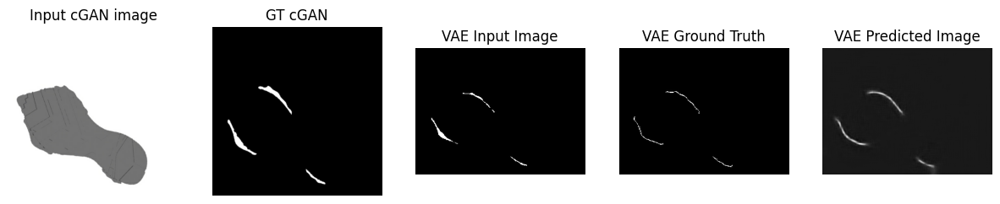

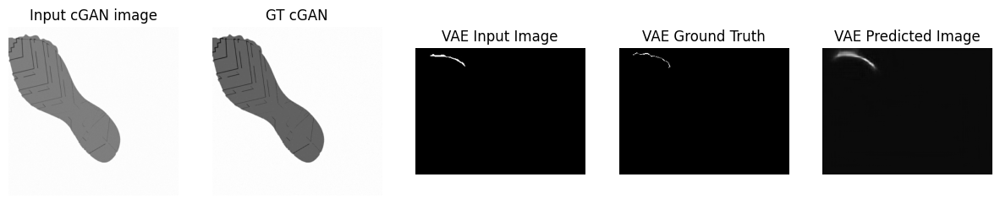

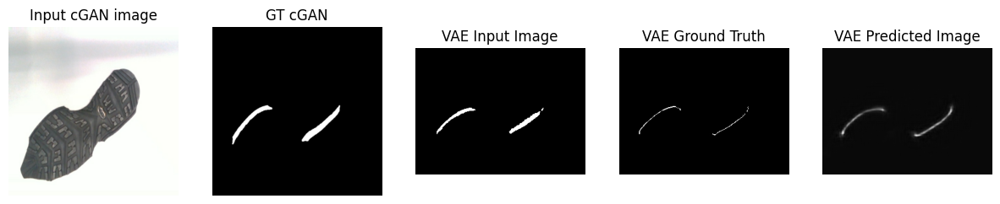

....................................................................................................Time taken for 1000 steps: 429.70 sec

[Epochs-interval: 2/6]__Step: 22k/123k
Train set ELBO: -0.001615563640370965


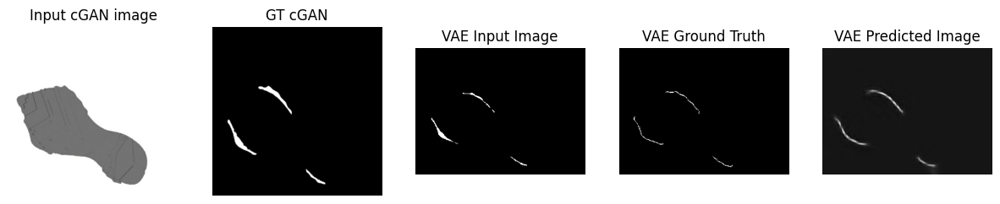

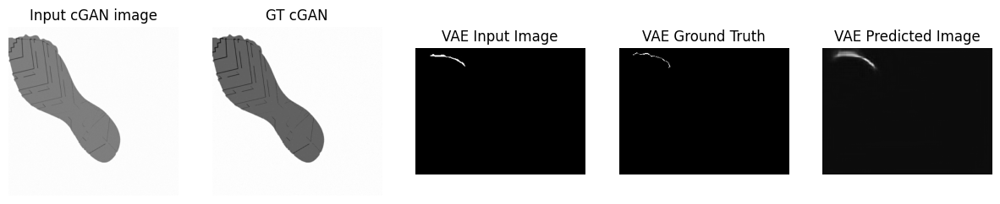

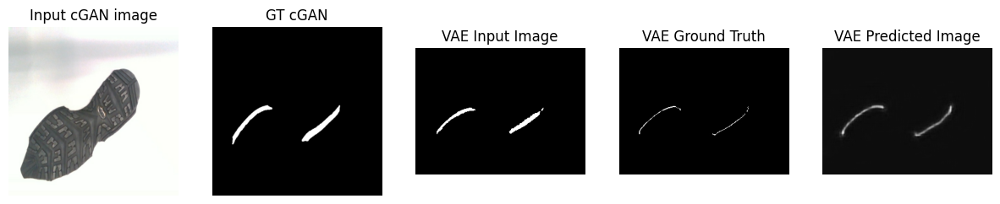

....................................................................................................Time taken for 1000 steps: 448.83 sec

[Epochs-interval: 2/6]__Step: 23k/123k
Train set ELBO: -0.0015482512535527349


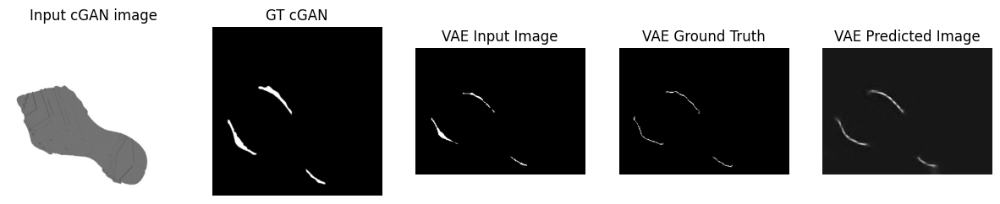

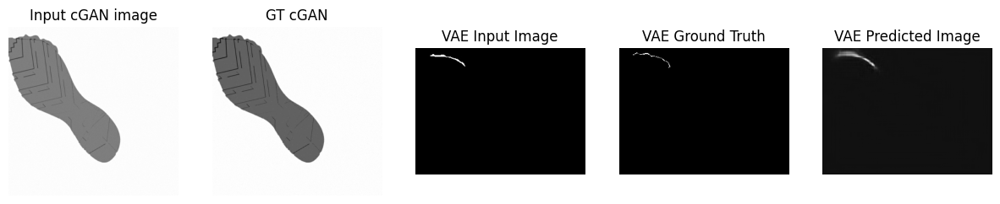

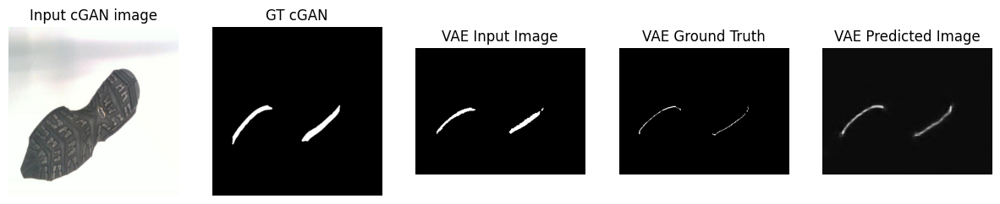

....................................................................................................Time taken for 1000 steps: 469.19 sec

[Epochs-interval: 2/6]__Step: 24k/123k
Train set ELBO: -0.0015298783546313643


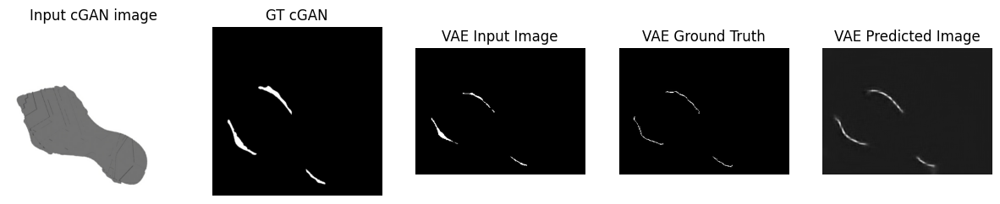

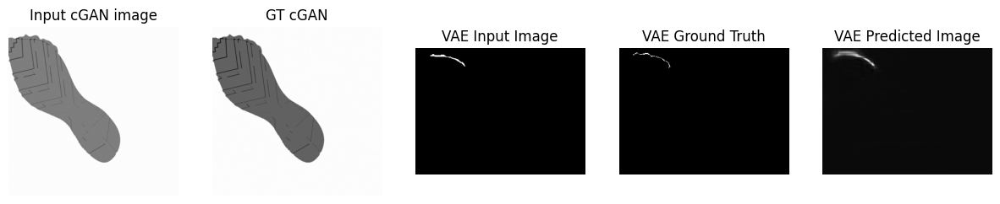

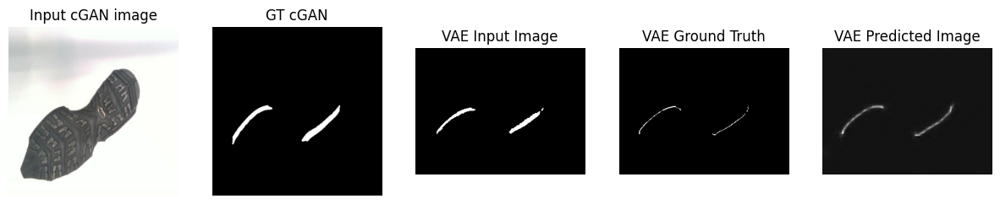

....................................................................................................Time taken for 1000 steps: 488.30 sec

[Epochs-interval: 2/6]__Step: 25k/123k
Train set ELBO: -0.0014710393734276295


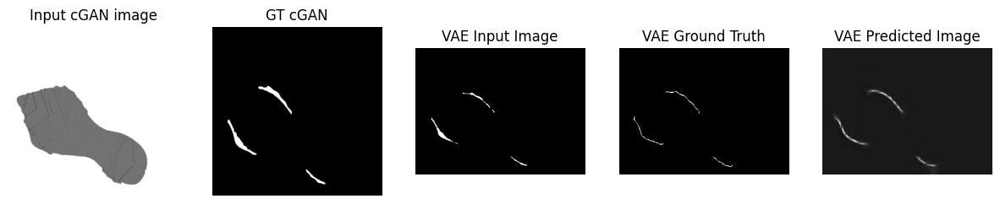

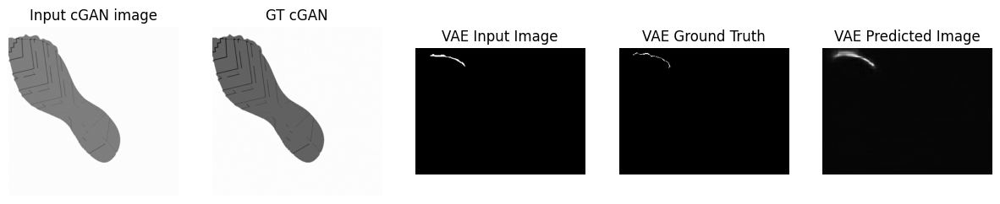

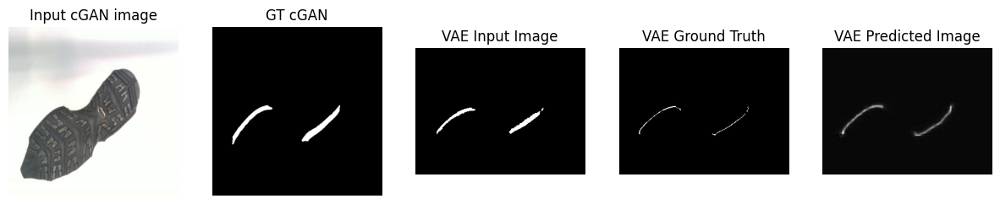

....................................................................................................Time taken for 1000 steps: 507.70 sec

[Epochs-interval: 2/6]__Step: 26k/123k
Train set ELBO: -0.0014304750366136432


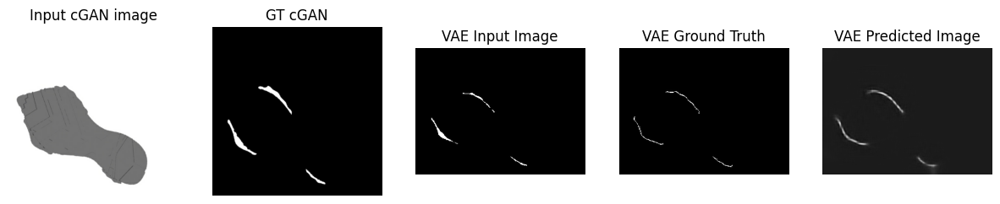

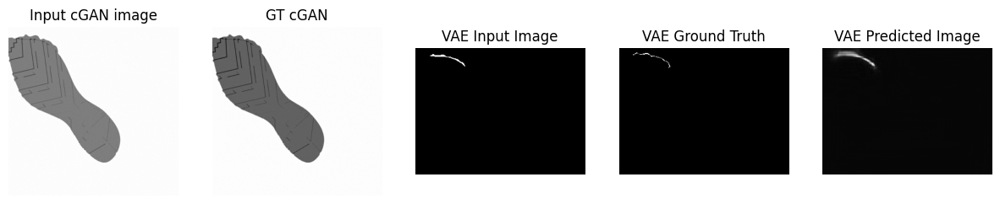

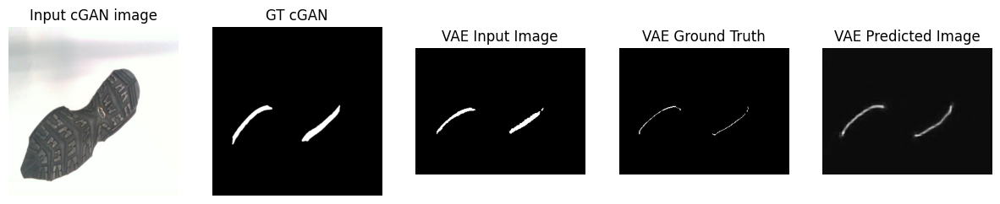

....................................................................................................Time taken for 1000 steps: 527.27 sec

[Epochs-interval: 2/6]__Step: 27k/123k
Train set ELBO: -0.001461439416743815


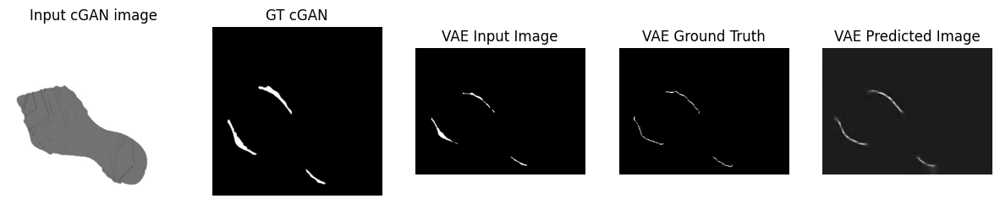

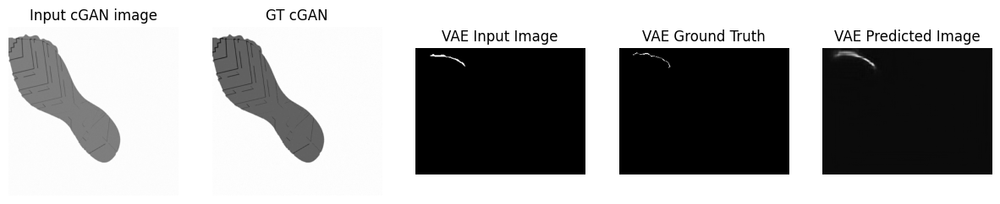

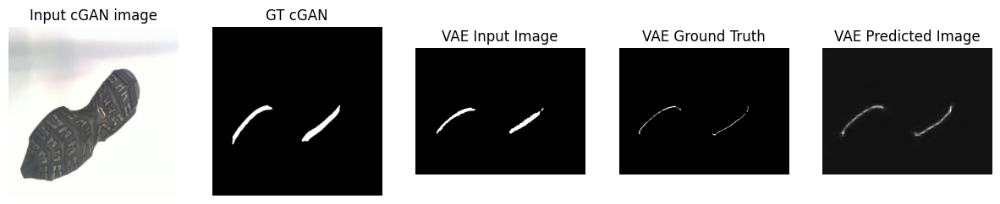

....................................................................................................Time taken for 1000 steps: 546.76 sec

[Epochs-interval: 2/6]__Step: 28k/123k
Train set ELBO: -0.0014743187930434942


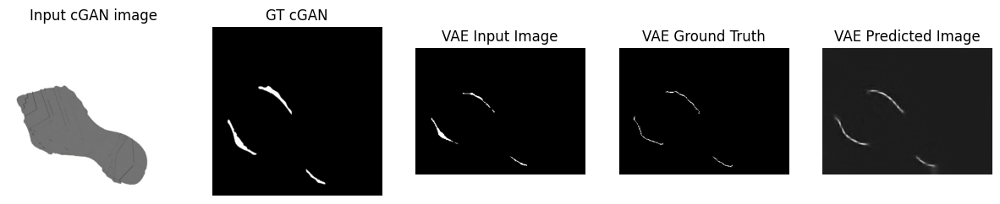

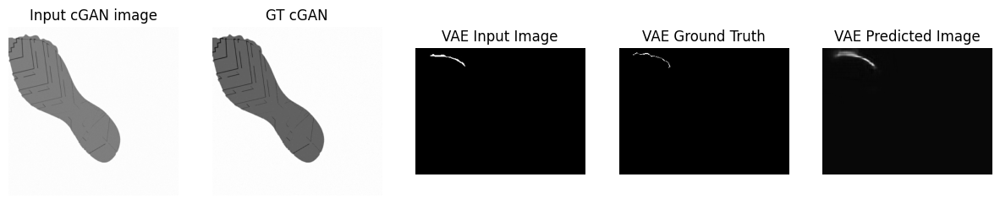

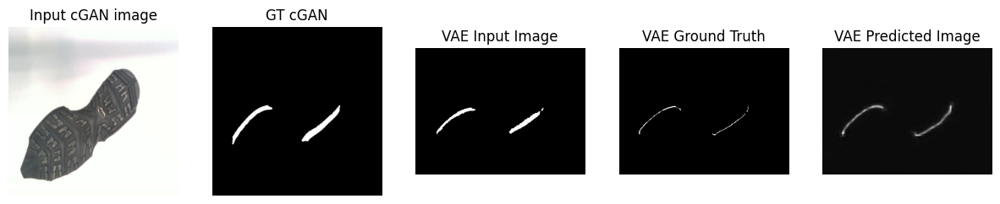

....................................................................................................Time taken for 1000 steps: 565.84 sec

[Epochs-interval: 2/6]__Step: 29k/123k
Train set ELBO: -0.0015169165562838316


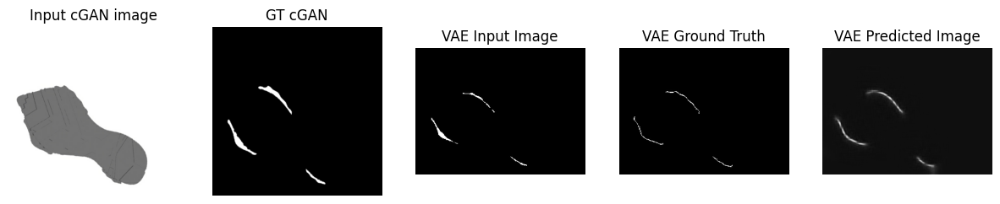

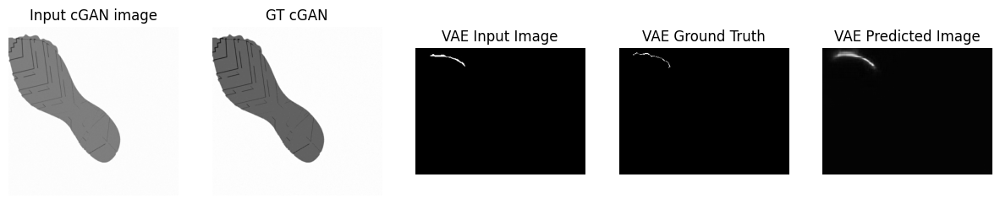

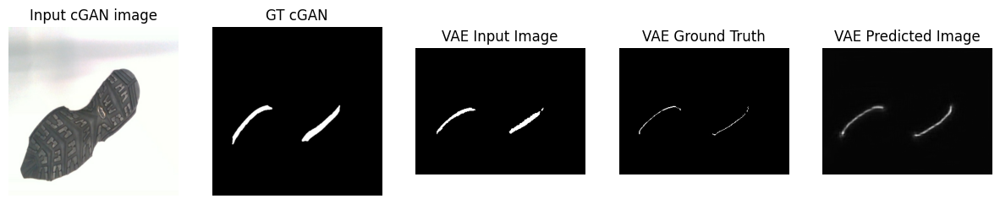

....................................................................................................Time taken for 1000 steps: 585.46 sec

[Epochs-interval: 2/6]__Step: 30k/123k
Train set ELBO: -0.0014930026372894645


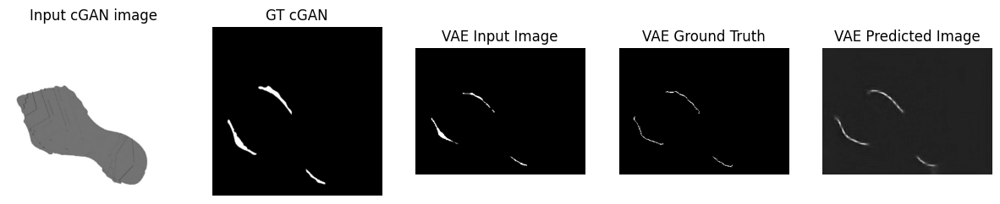

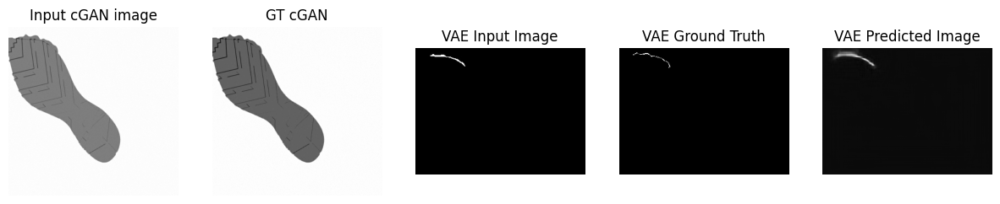

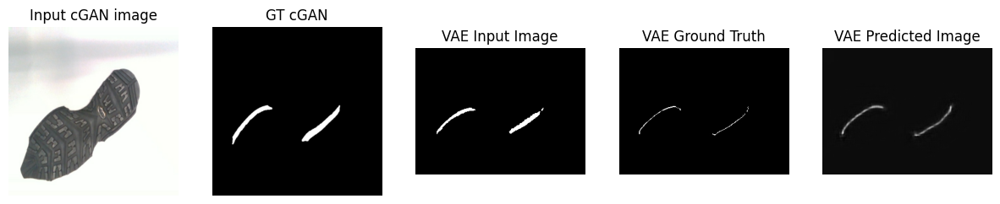

....................................................................................................Time taken for 1000 steps: 604.56 sec

[Epochs-interval: 2/6]__Step: 31k/123k
Train set ELBO: -0.0015323911793529987


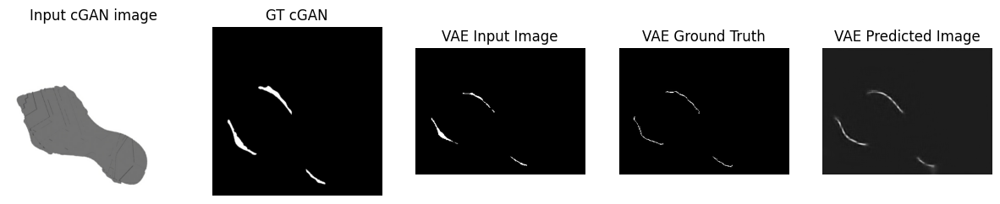

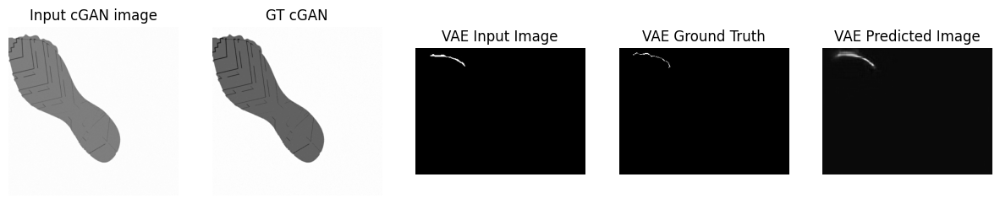

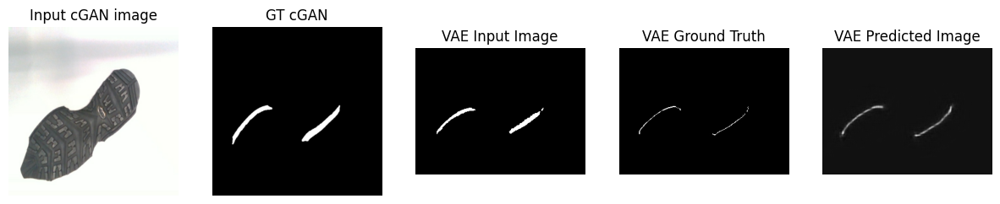

....................................................................................................Time taken for 1000 steps: 624.24 sec

[Epochs-interval: 2/6]__Step: 32k/123k
Train set ELBO: -0.0015214806189760566


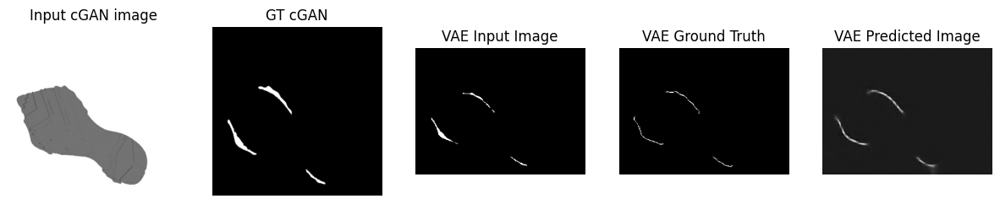

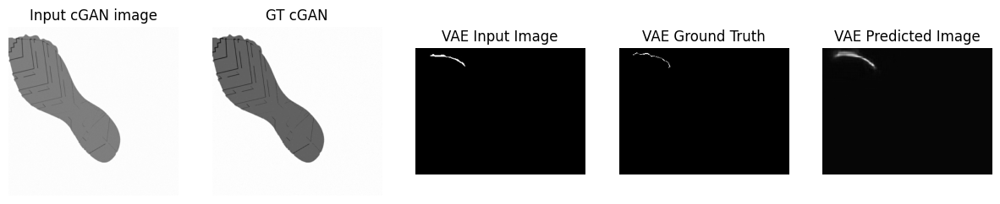

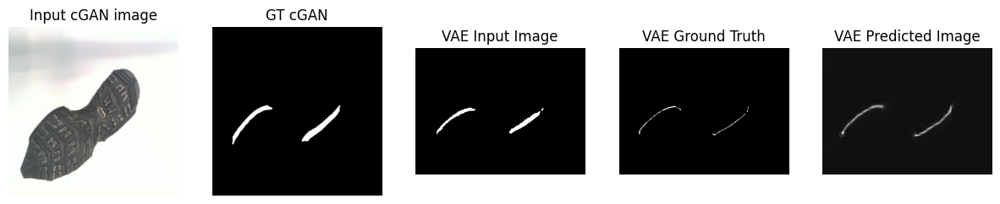

....................................................................................................Time taken for 1000 steps: 643.98 sec

[Epochs-interval: 2/6]__Step: 33k/123k
Train set ELBO: -0.0014767320826649666


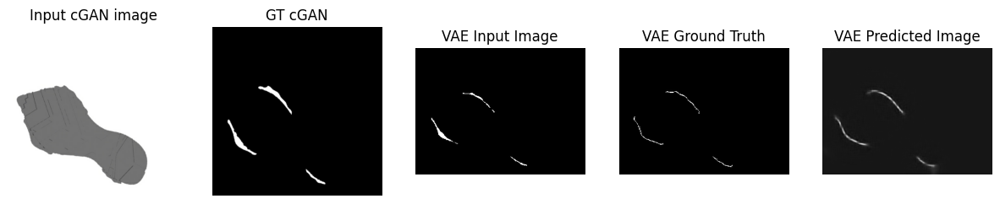

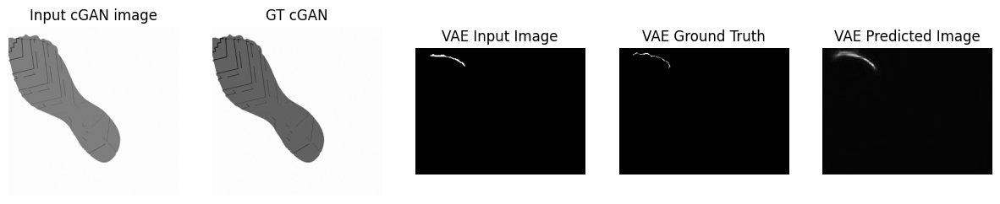

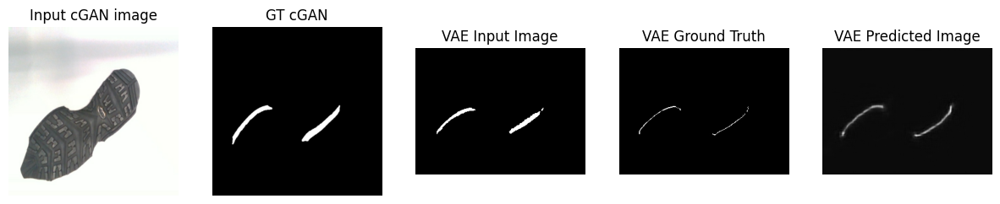

....................................................................................................Time taken for 1000 steps: 663.27 sec

[Epochs-interval: 2/6]__Step: 34k/123k
Train set ELBO: -0.001492947805672884


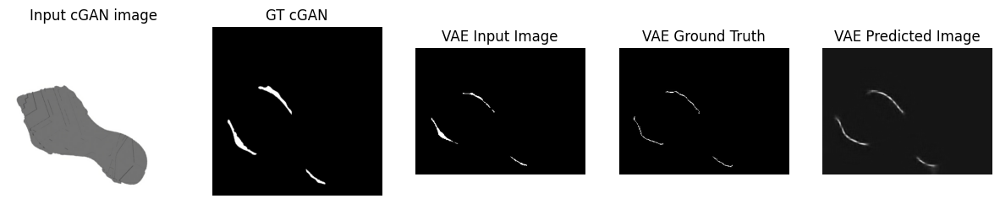

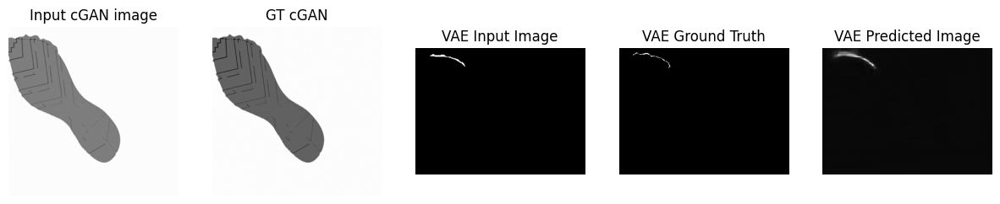

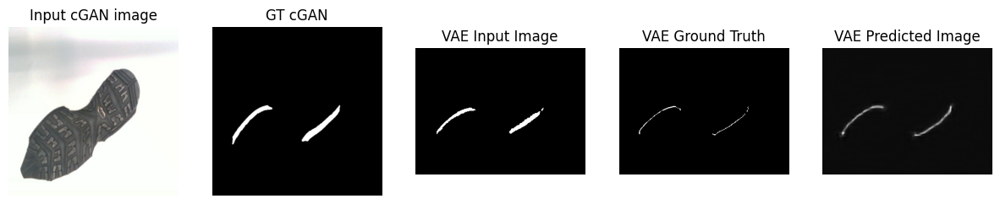

....................................................................................................Time taken for 1000 steps: 682.41 sec

[Epochs-interval: 2/6]__Step: 35k/123k
Train set ELBO: -0.0014514788053929806


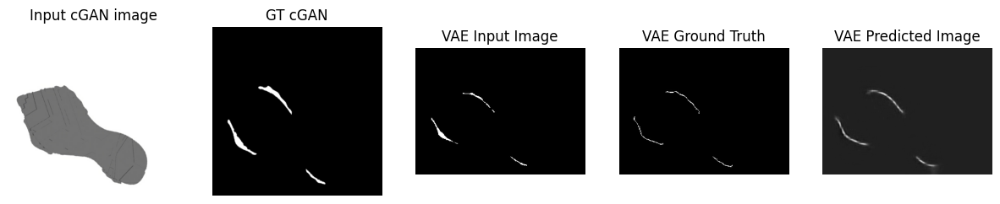

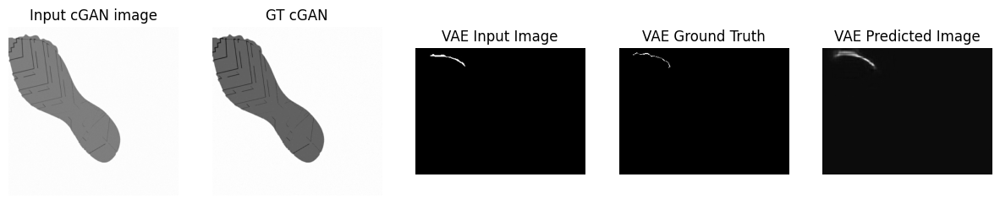

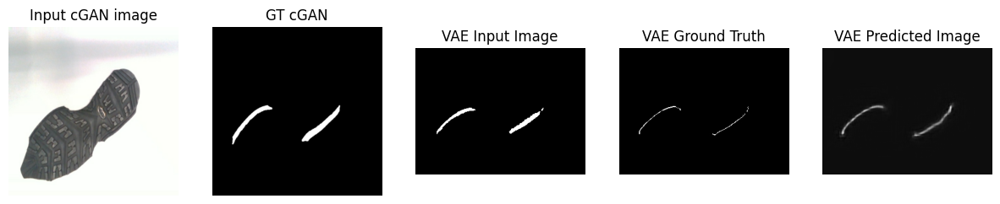

....................................................................................................Time taken for 1000 steps: 702.34 sec

[Epochs-interval: 2/6]__Step: 36k/123k
Train set ELBO: -0.0014236064162105322


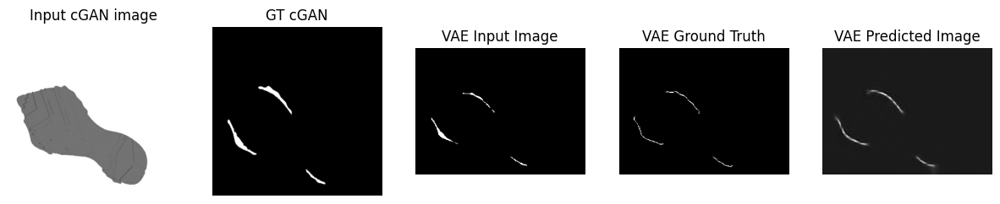

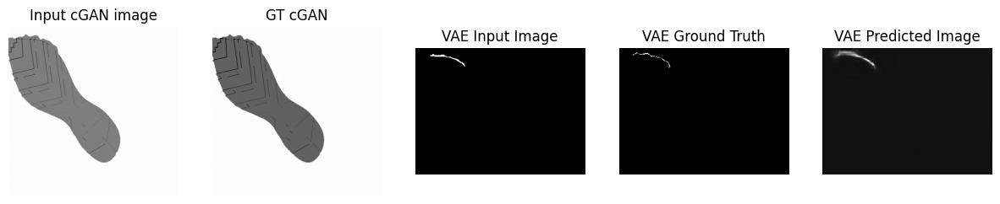

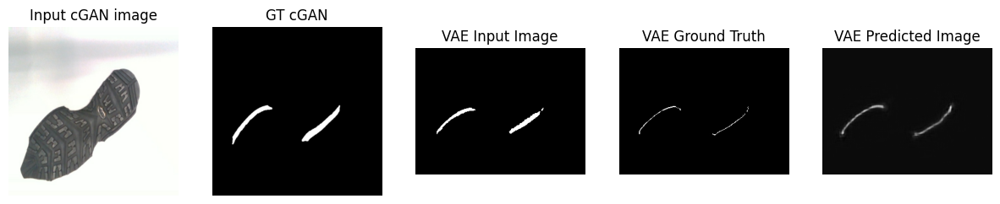

....................................................................................................Time taken for 1000 steps: 722.12 sec

[Epochs-interval: 2/6]__Step: 37k/123k
Train set ELBO: -0.0014078725362196565


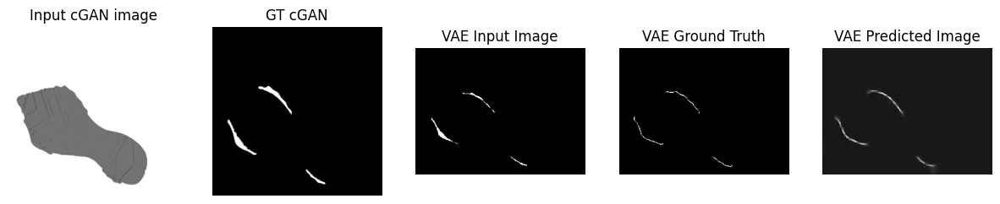

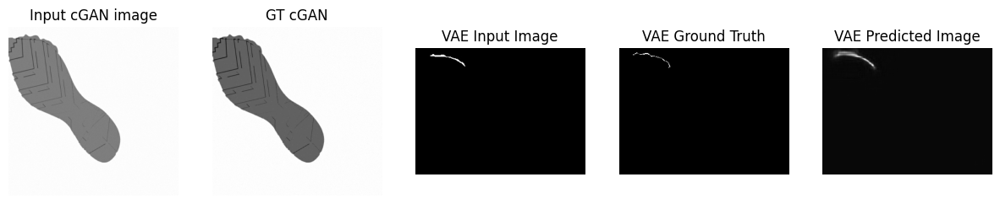

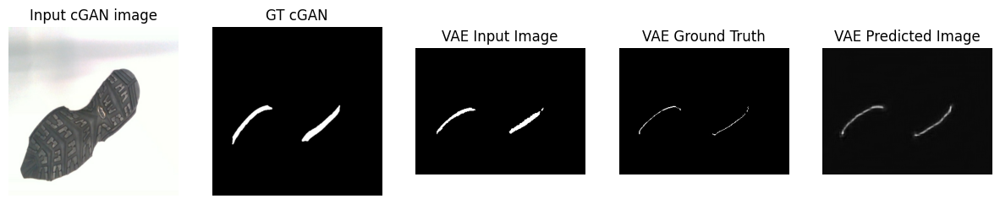

....................................................................................................Time taken for 1000 steps: 741.62 sec

[Epochs-interval: 2/6]__Step: 38k/123k
Train set ELBO: -0.0014074911596253514


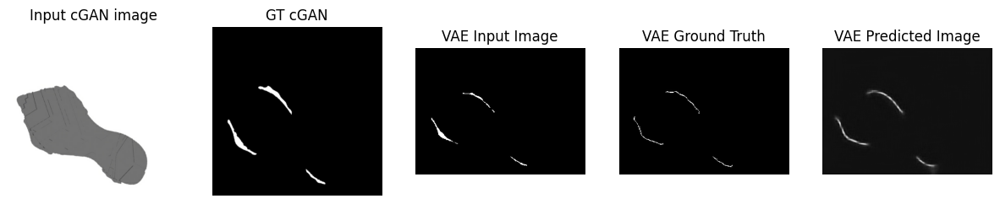

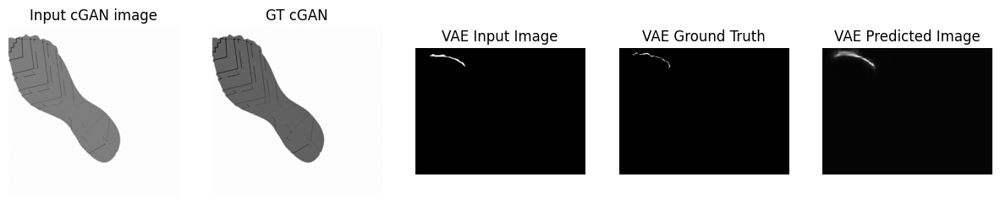

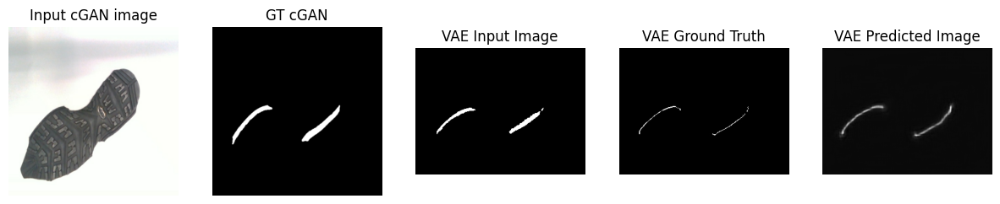

....................................................................................................Time taken for 1000 steps: 761.38 sec

[Epochs-interval: 2/6]__Step: 39k/123k
Train set ELBO: -0.0013881652848795056


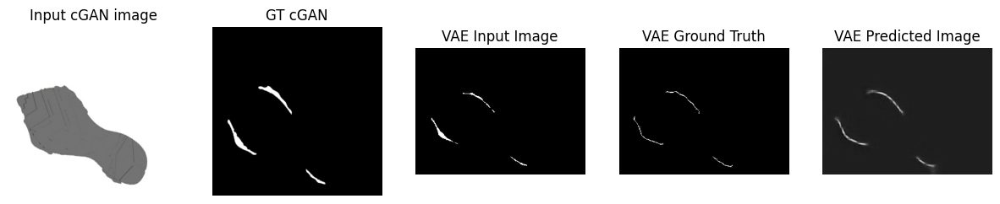

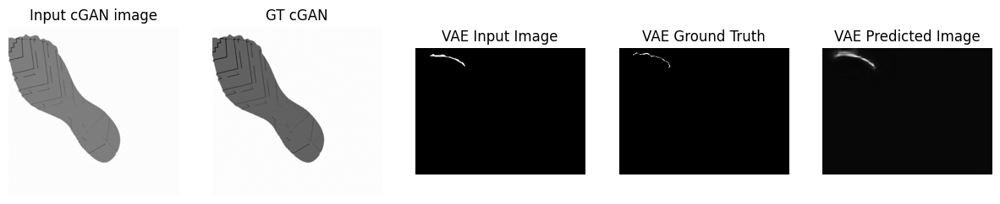

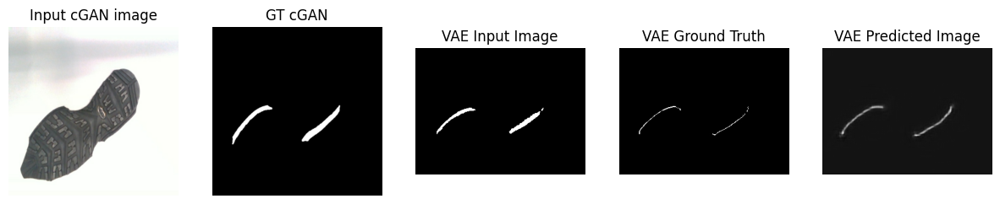

....................................................................................................Time taken for 1000 steps: 780.71 sec

[Epochs-interval: 2/6]__Step: 40k/123k
Train set ELBO: -0.001412809593603015


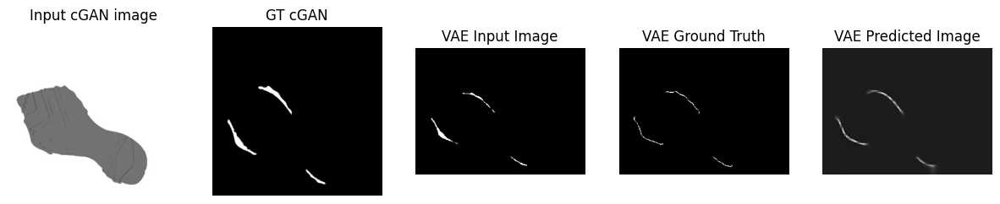

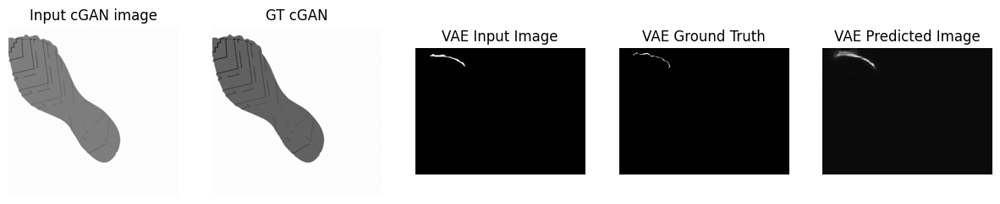

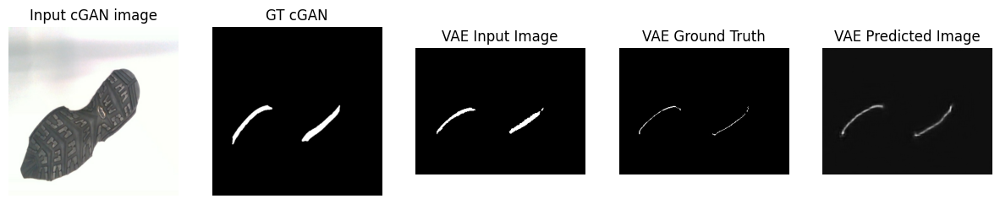

....................................................................................................Time taken for 1000 steps: 800.62 sec

[Epochs-interval: 3/6]__Step: 41k/123k
Train set ELBO: -0.0014321604976430535


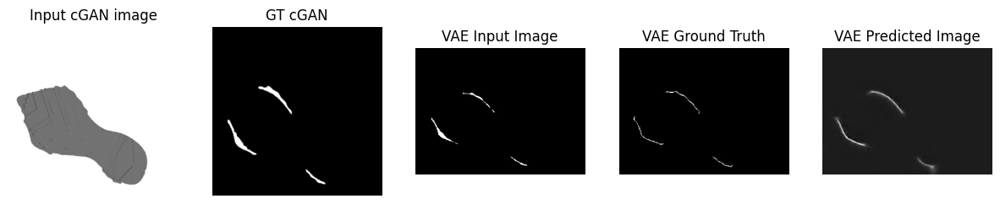

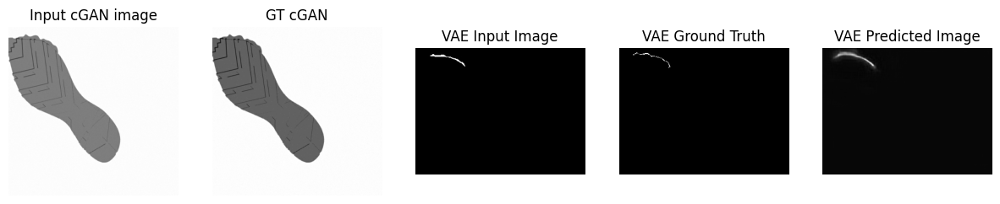

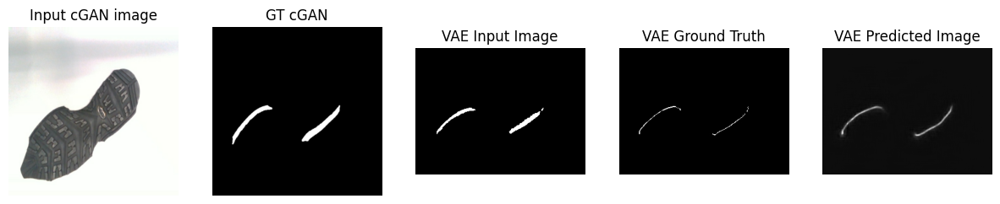

....................................................................................................Time taken for 1000 steps: 820.85 sec

[Epochs-interval: 3/6]__Step: 42k/123k
Train set ELBO: -0.0014625623589381576


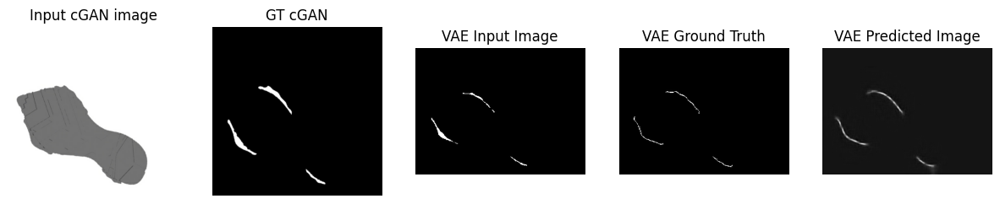

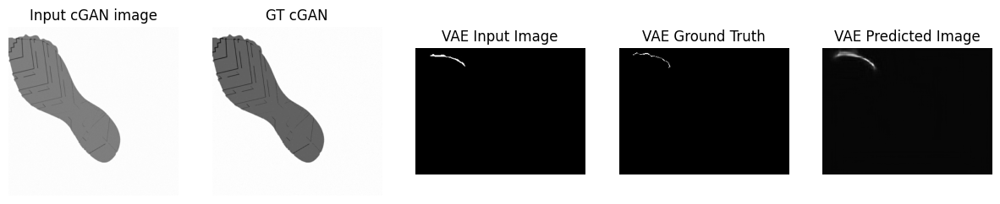

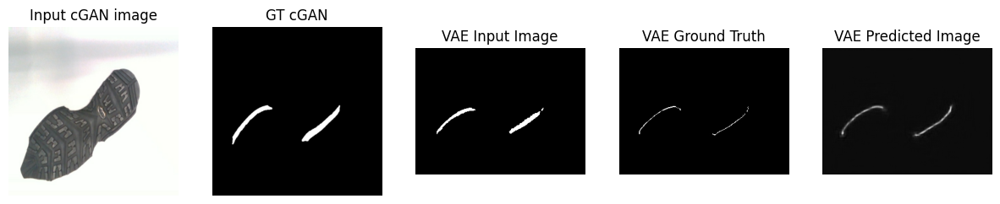

....................................................................................................Time taken for 1000 steps: 840.24 sec

[Epochs-interval: 3/6]__Step: 43k/123k
Train set ELBO: -0.0014561779098585248


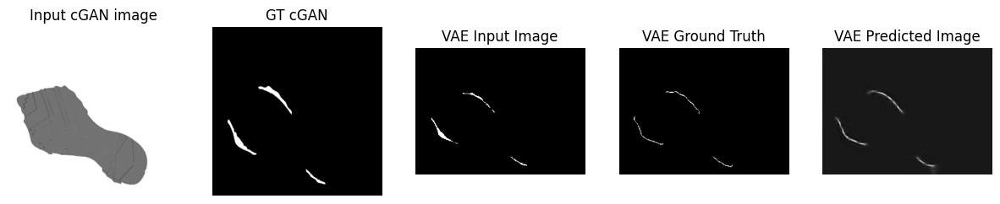

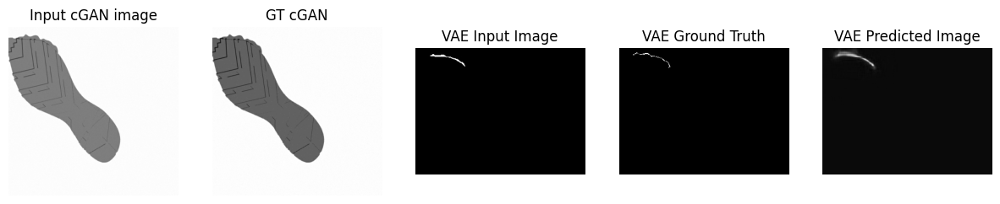

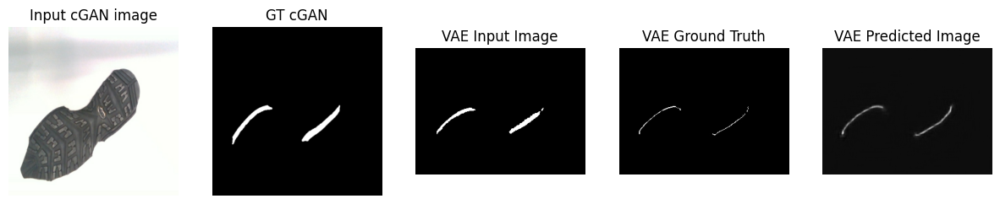

....................................................................................................Time taken for 1000 steps: 859.63 sec

[Epochs-interval: 3/6]__Step: 44k/123k
Train set ELBO: -0.001463385415263474


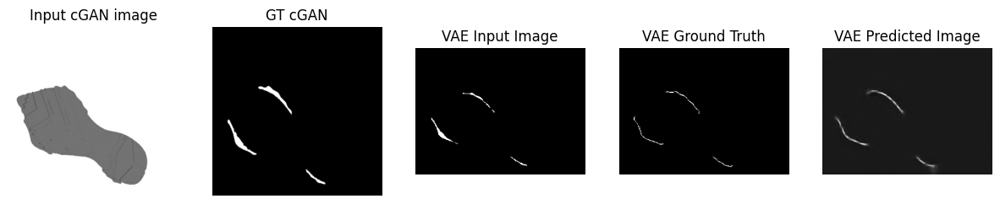

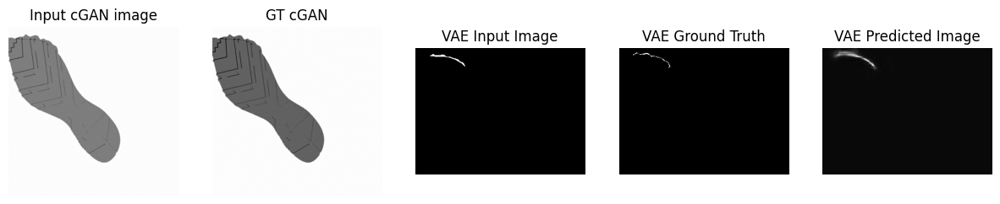

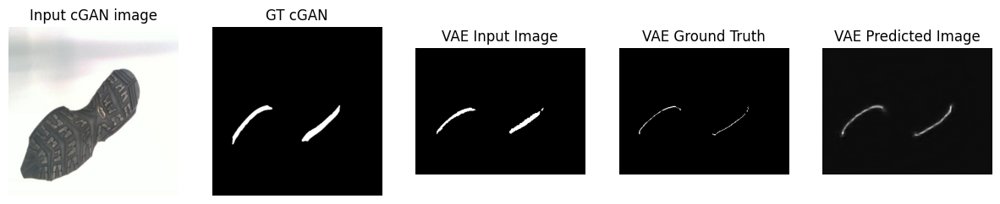

....................................................................................................Time taken for 1000 steps: 880.35 sec

[Epochs-interval: 3/6]__Step: 45k/123k
Train set ELBO: -0.0014411404263228178


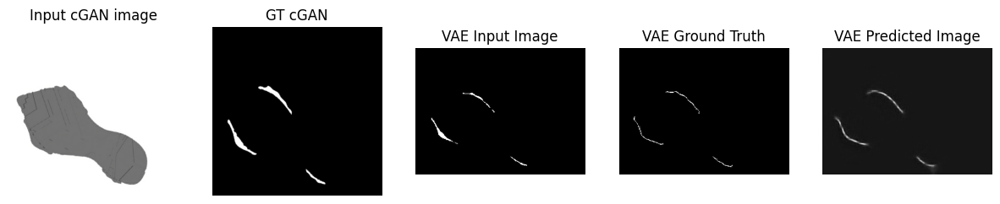

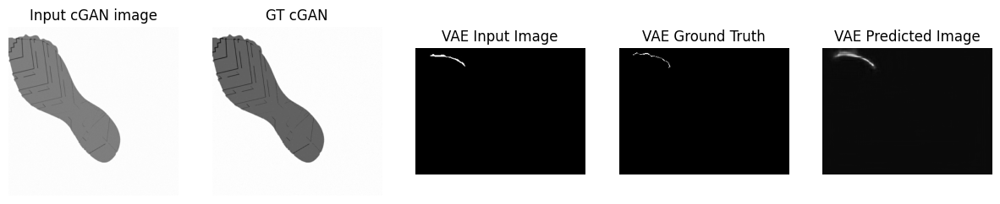

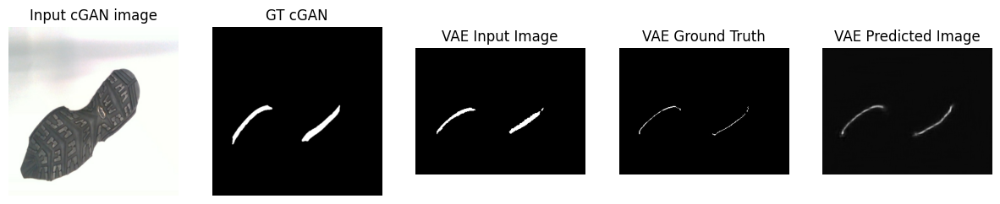

....................................................................................................Time taken for 1000 steps: 900.01 sec

[Epochs-interval: 3/6]__Step: 46k/123k
Train set ELBO: -0.001435829559341073


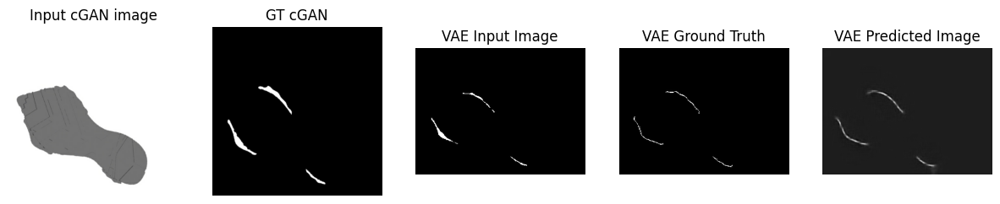

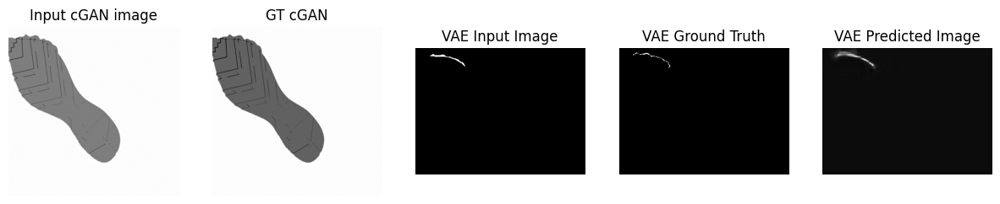

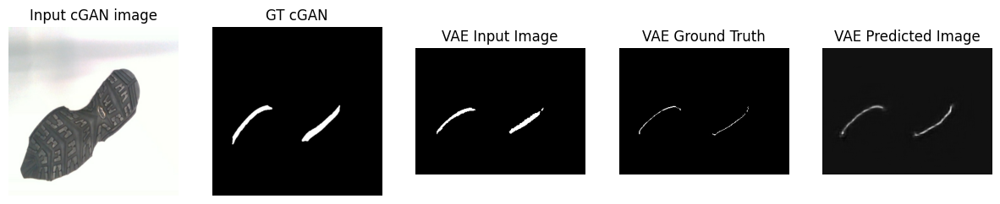

....................................................................................................Time taken for 1000 steps: 919.93 sec

[Epochs-interval: 3/6]__Step: 47k/123k
Train set ELBO: -0.001442359876818955


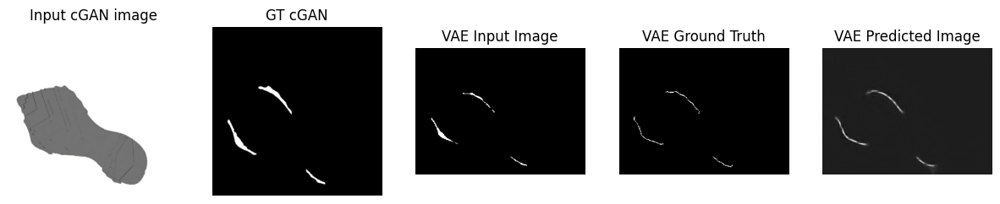

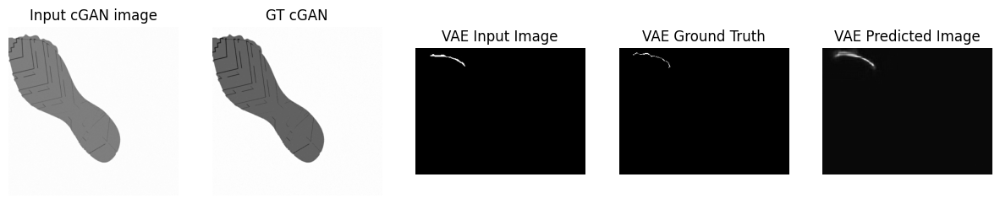

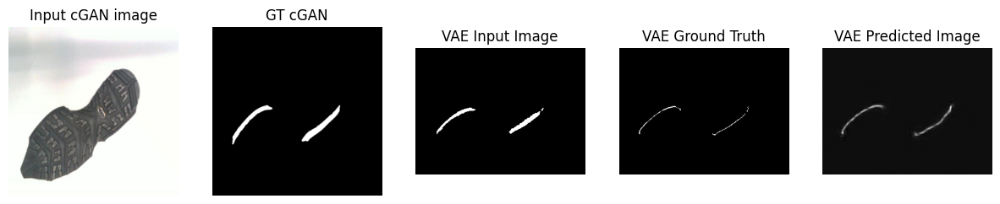

....................................................................................................Time taken for 1000 steps: 940.22 sec

[Epochs-interval: 3/6]__Step: 48k/123k
Train set ELBO: -0.001435602200217545


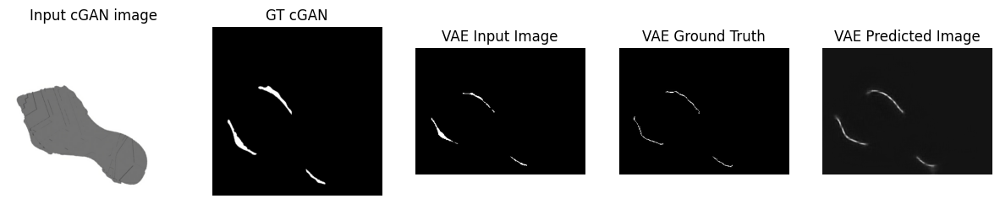

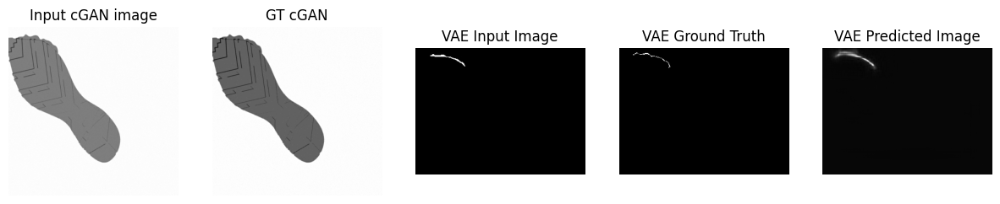

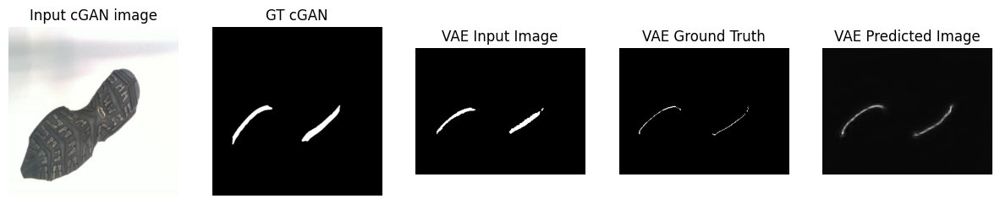

....................................................................................................Time taken for 1000 steps: 960.69 sec

[Epochs-interval: 3/6]__Step: 49k/123k
Train set ELBO: -0.00140689080581069


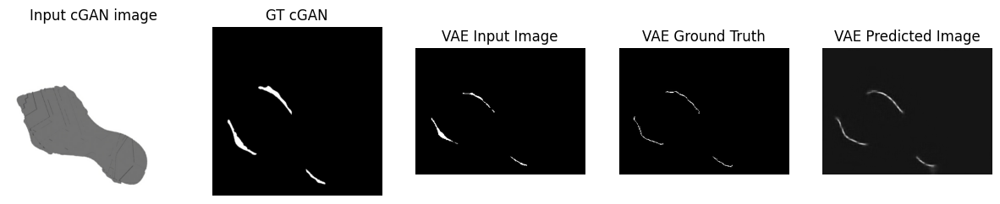

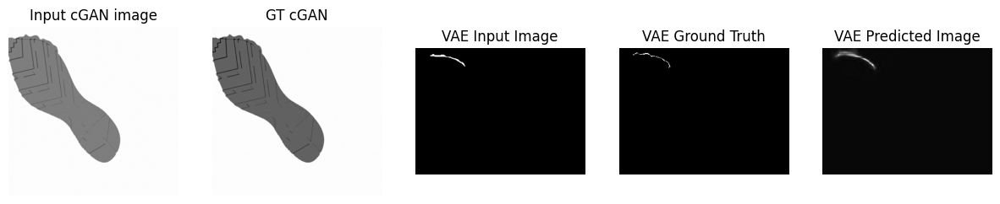

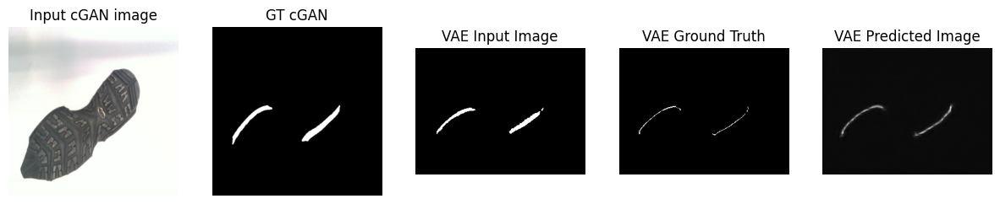

....................................................................................................Time taken for 1000 steps: 981.16 sec

[Epochs-interval: 3/6]__Step: 50k/123k
Train set ELBO: -0.0013912441208958626


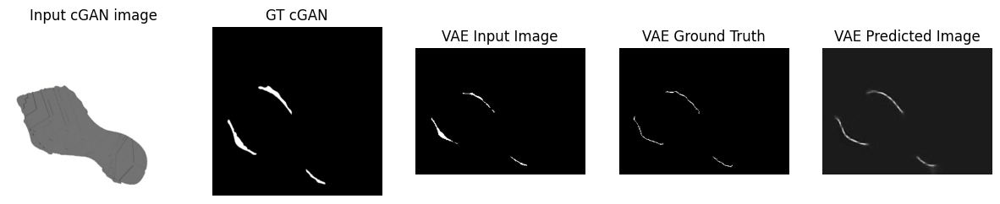

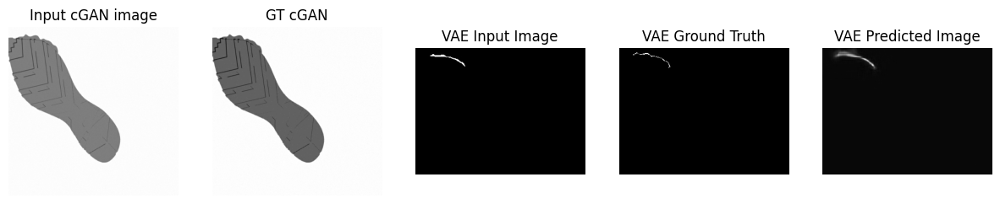

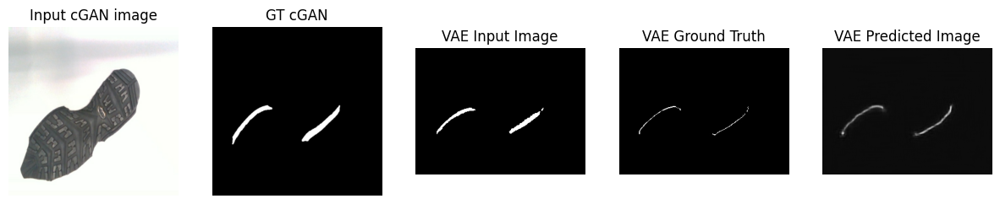

....................................................................................................Time taken for 1000 steps: 1001.46 sec

[Epochs-interval: 3/6]__Step: 51k/123k
Train set ELBO: -0.0013964672107249498


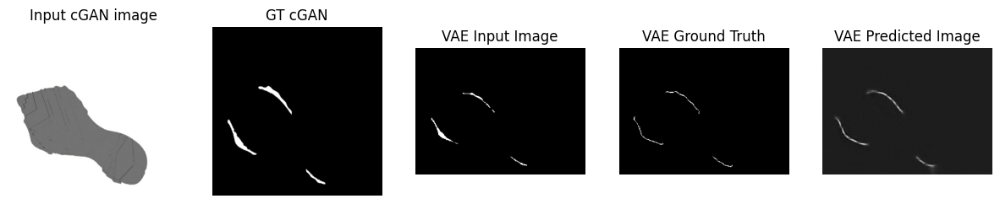

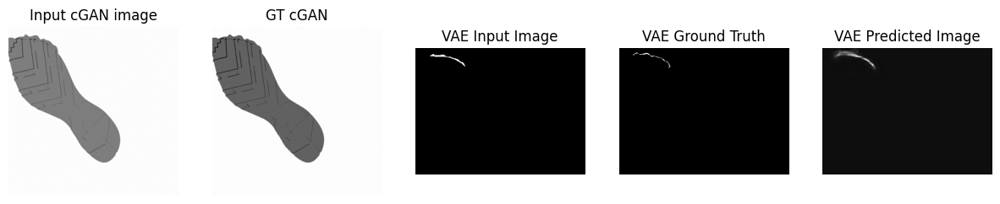

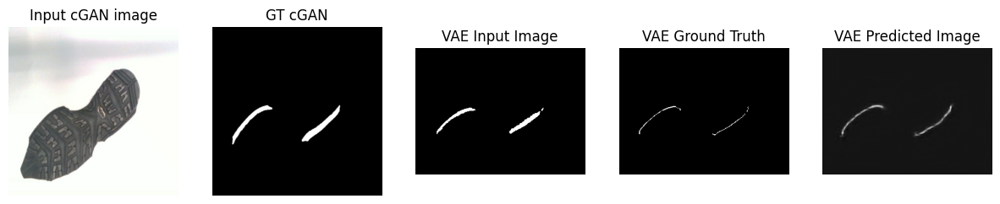

....................................................................................................Time taken for 1000 steps: 1021.56 sec

[Epochs-interval: 3/6]__Step: 52k/123k
Train set ELBO: -0.001405661809258163


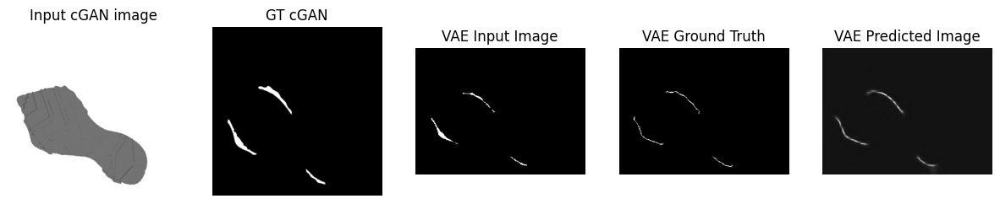

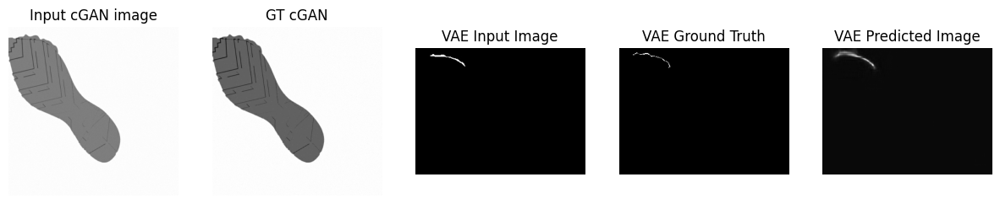

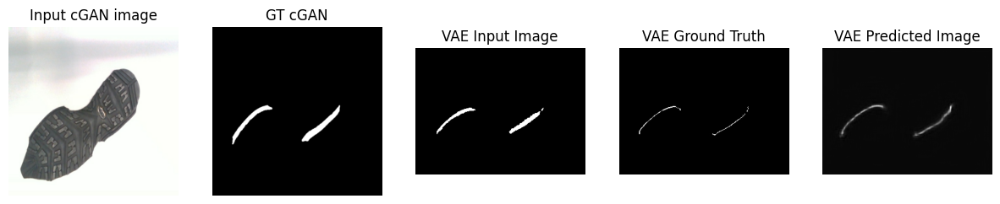

....................................................................................................Time taken for 1000 steps: 1042.15 sec

[Epochs-interval: 3/6]__Step: 53k/123k
Train set ELBO: -0.0013865972869098186


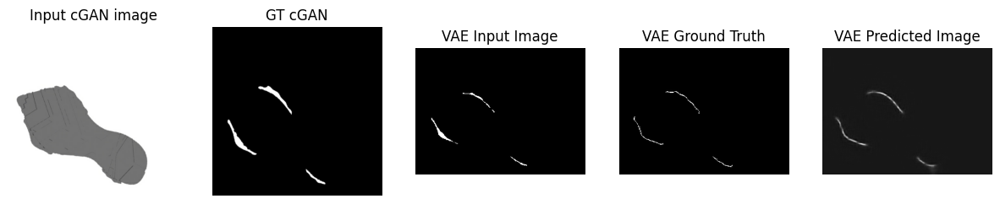

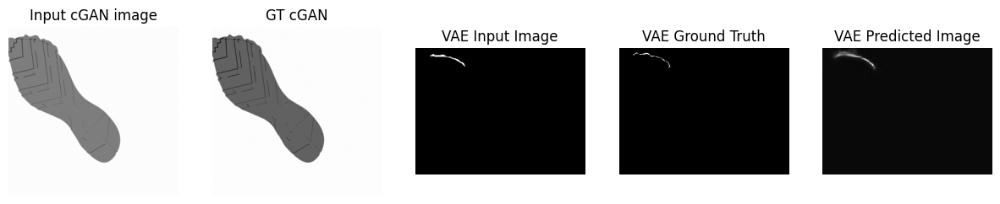

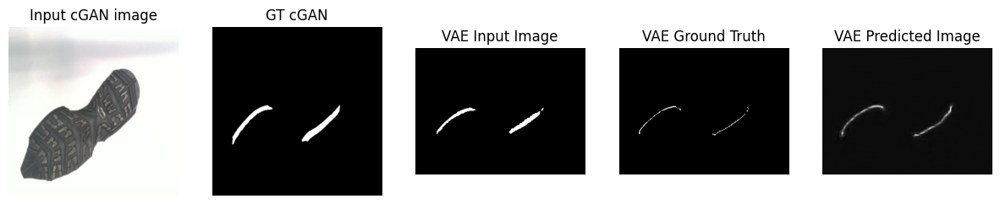

....................................................................................................Time taken for 1000 steps: 1062.88 sec

[Epochs-interval: 3/6]__Step: 54k/123k
Train set ELBO: -0.0014090578770264983


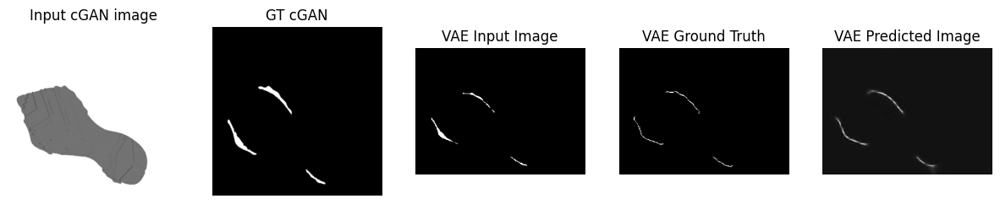

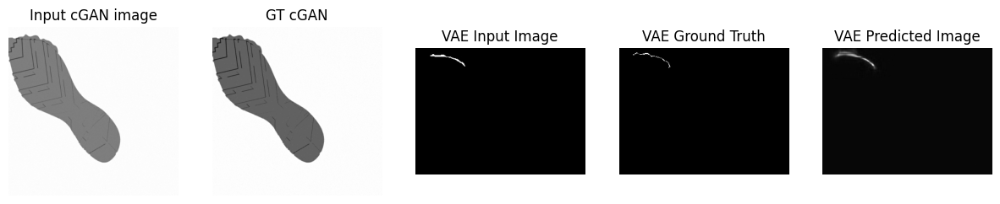

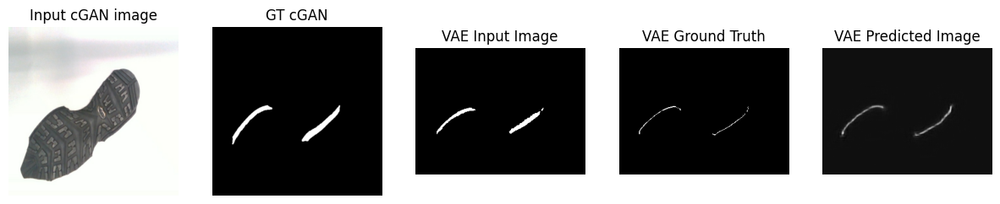

....................................................................................................Time taken for 1000 steps: 1082.89 sec

[Epochs-interval: 3/6]__Step: 55k/123k
Train set ELBO: -0.0014278499875217676


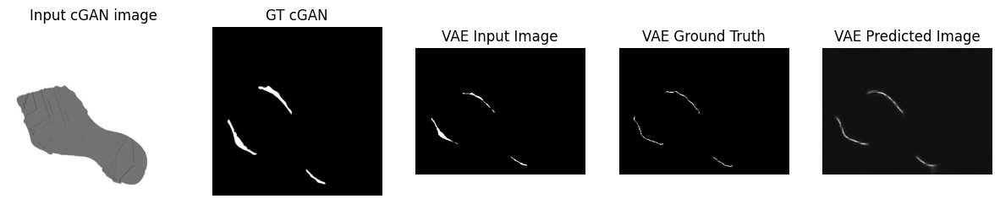

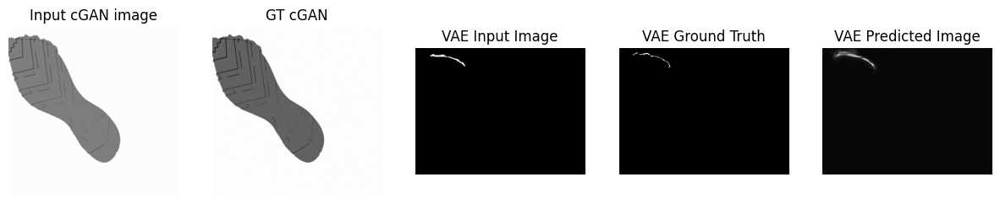

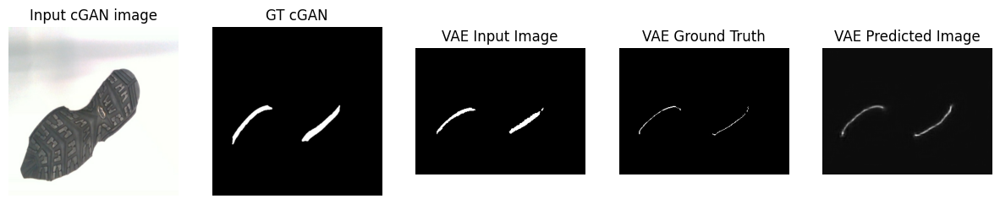

....................................................................................................Time taken for 1000 steps: 1103.70 sec

[Epochs-interval: 3/6]__Step: 56k/123k
Train set ELBO: -0.001417682389728725


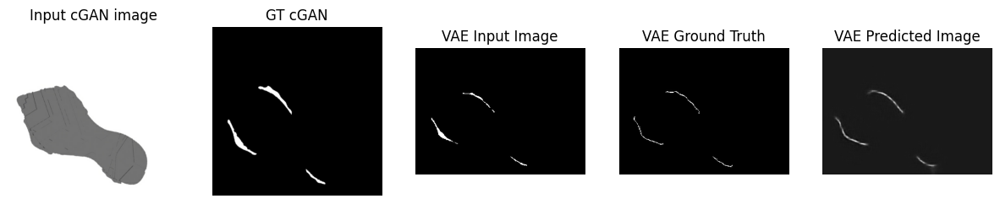

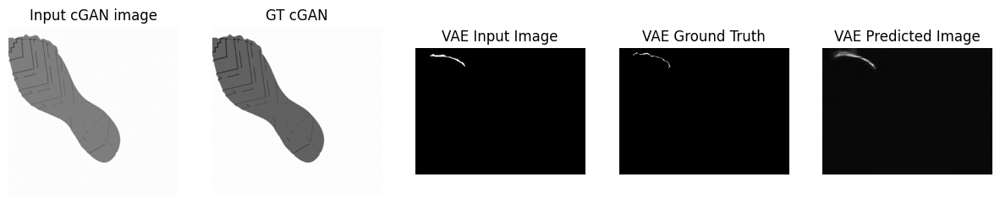

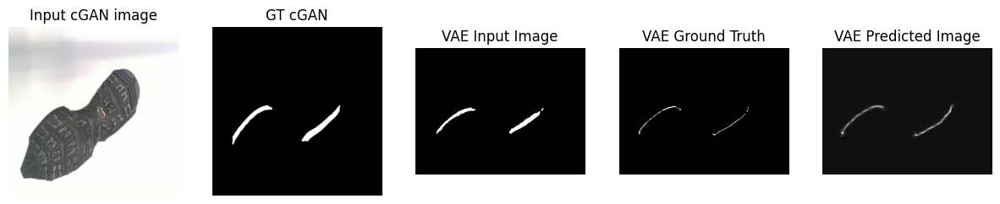

....................................................................................................Time taken for 1000 steps: 1124.10 sec

[Epochs-interval: 3/6]__Step: 57k/123k
Train set ELBO: -0.0014130475465208292


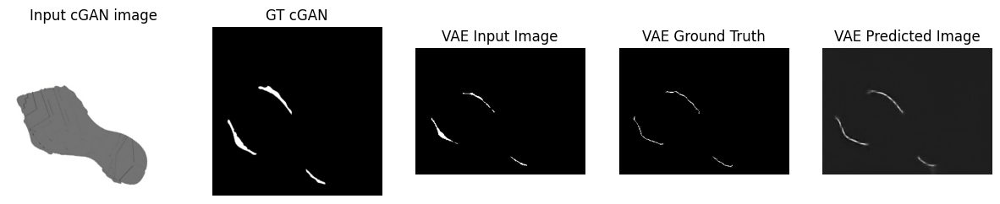

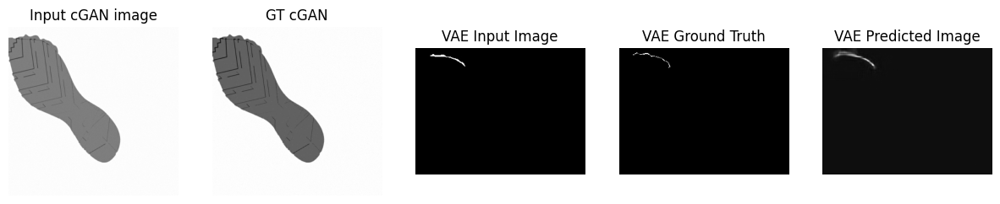

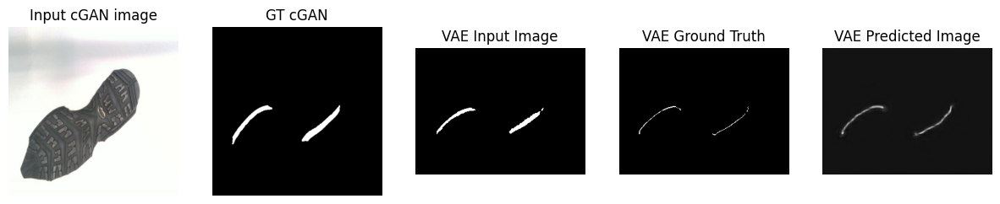

....................................................................................................Time taken for 1000 steps: 1144.92 sec

[Epochs-interval: 3/6]__Step: 58k/123k
Train set ELBO: -0.001402724185027182


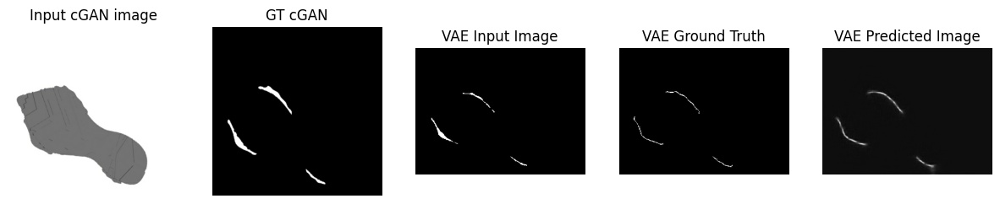

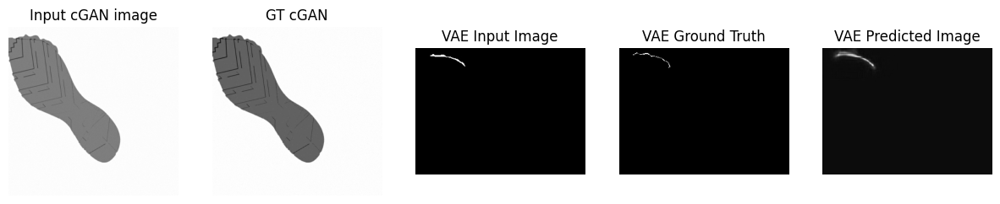

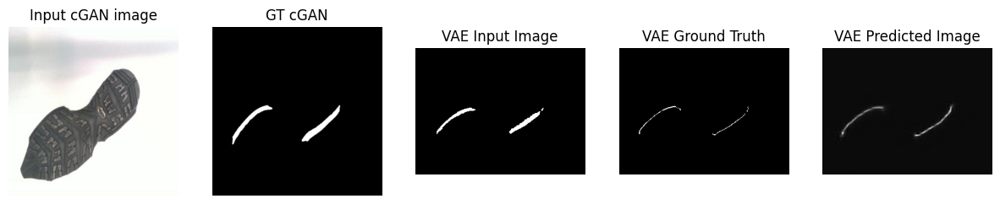

....................................................................................................Time taken for 1000 steps: 1165.58 sec

[Epochs-interval: 3/6]__Step: 59k/123k
Train set ELBO: -0.0014119691913947463


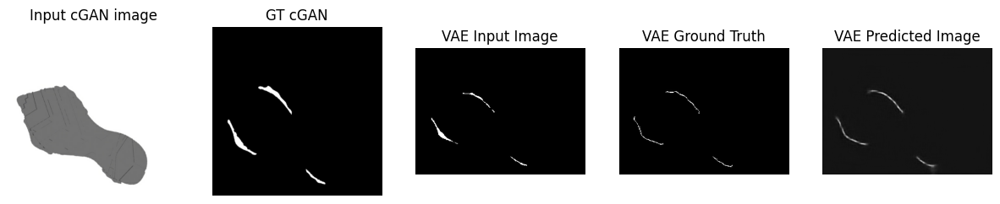

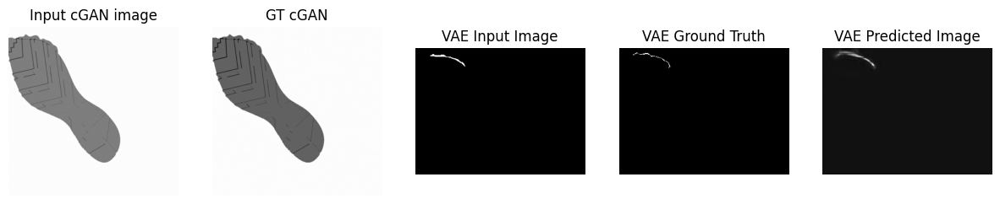

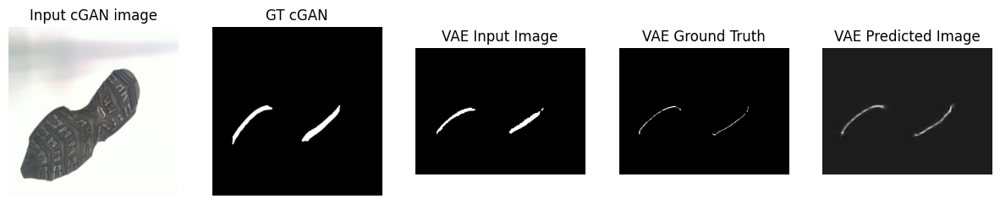

....................................................................................................Time taken for 1000 steps: 1185.72 sec

[Epochs-interval: 3/6]__Step: 60k/123k
Train set ELBO: -0.0014199517900124192


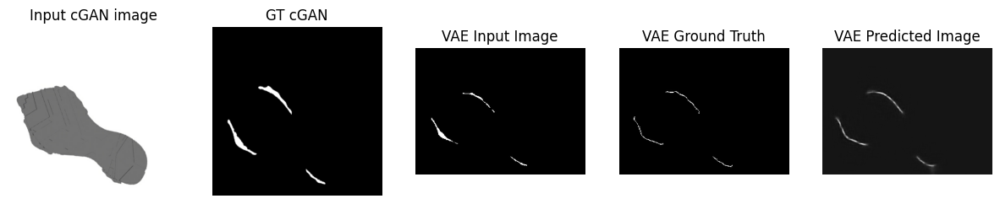

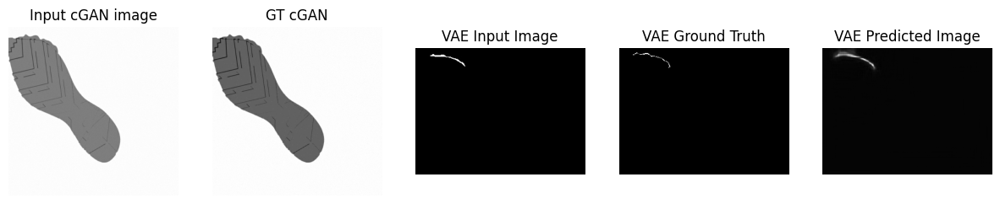

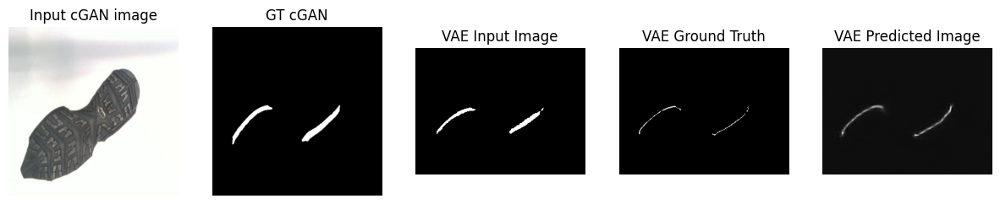

....................................................................................................Time taken for 1000 steps: 1205.72 sec

[Epochs-interval: 3/6]__Step: 61k/123k
Train set ELBO: -0.0014510005712509155


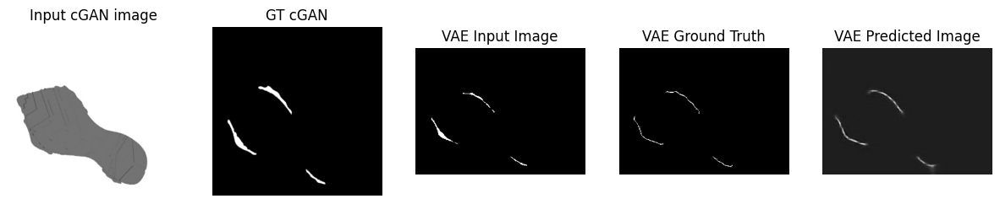

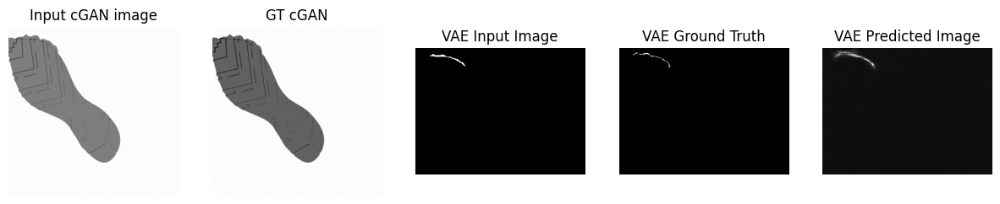

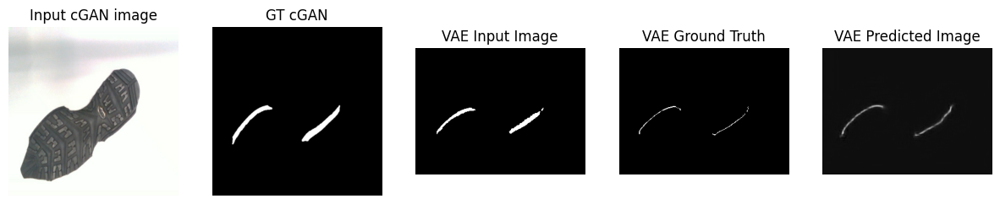

....................................................................................................Time taken for 1000 steps: 1226.83 sec

[Epochs-interval: 4/6]__Step: 62k/123k
Train set ELBO: -0.001429086085408926


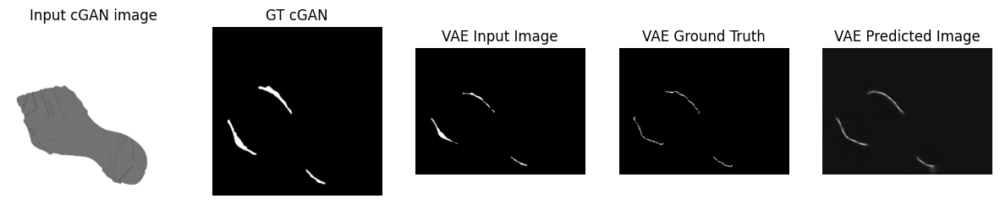

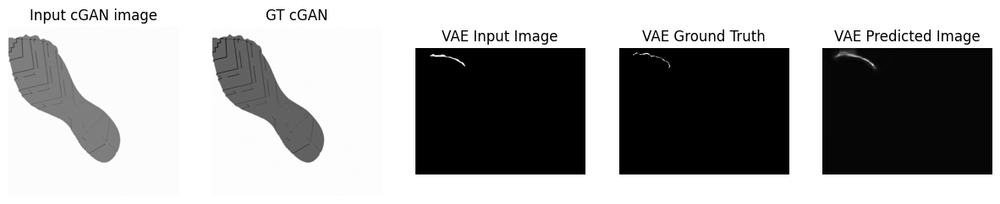

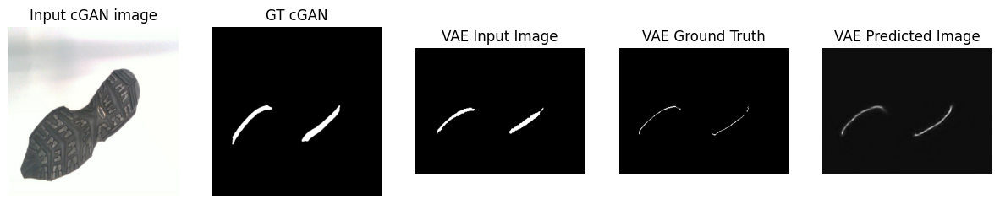

....................................................................................................Time taken for 1000 steps: 1247.07 sec

[Epochs-interval: 4/6]__Step: 63k/123k
Train set ELBO: -0.0014289866667240858


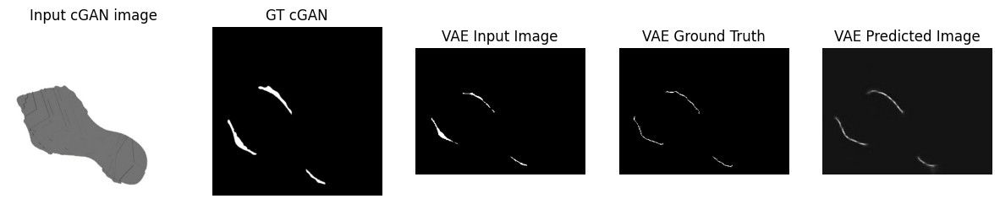

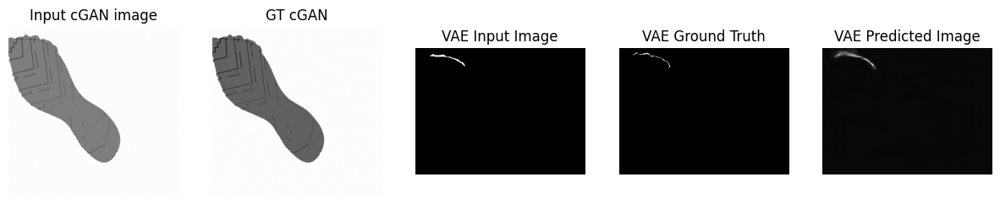

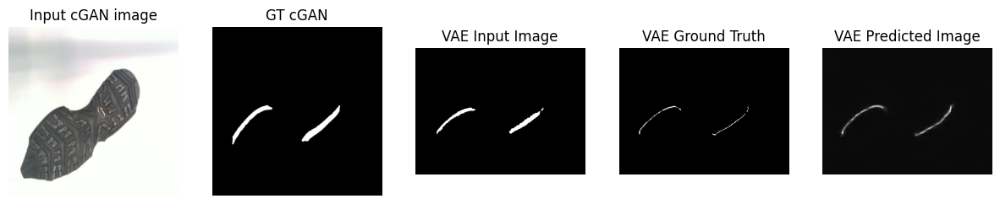

....................................................................................................Time taken for 1000 steps: 1267.81 sec

[Epochs-interval: 4/6]__Step: 64k/123k
Train set ELBO: -0.0014070026809349656


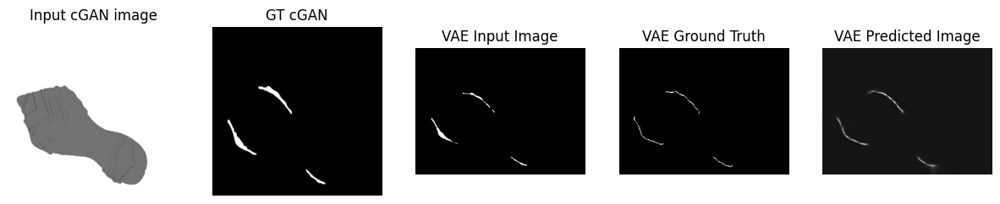

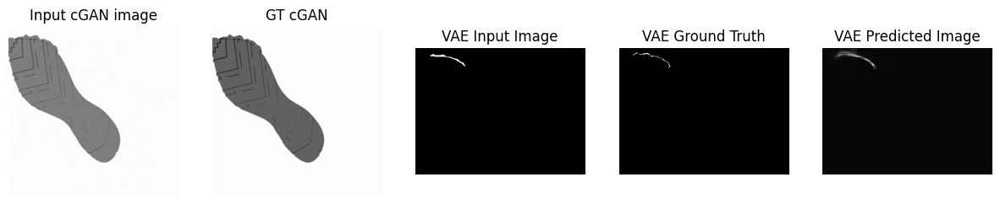

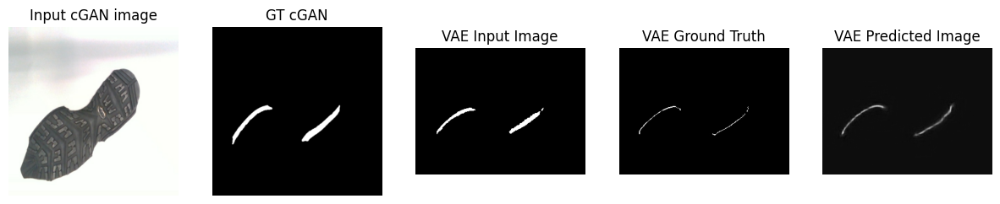

....................................................................................................Time taken for 1000 steps: 1288.25 sec

[Epochs-interval: 4/6]__Step: 65k/123k
Train set ELBO: -0.0014015425695106387


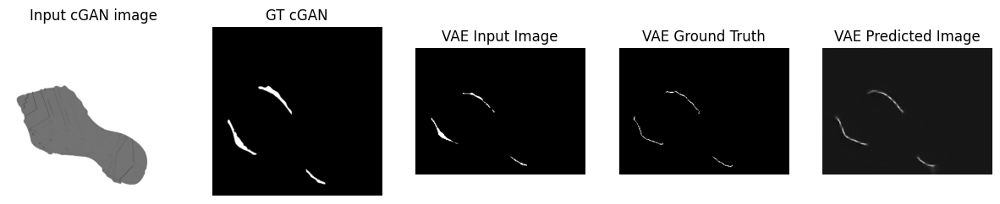

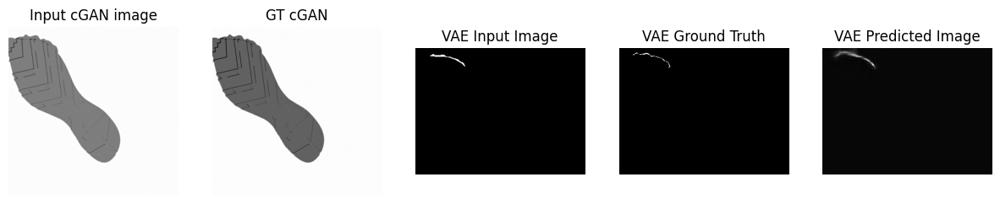

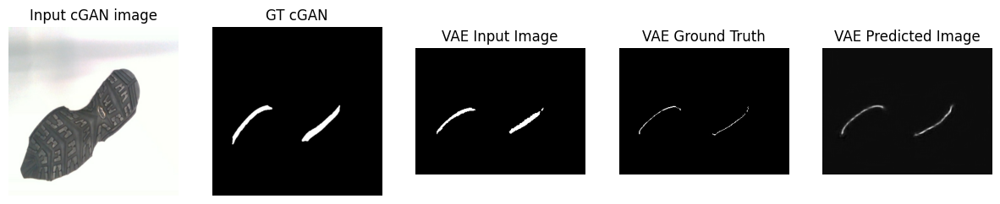

....................................................................................................Time taken for 1000 steps: 1309.03 sec

[Epochs-interval: 4/6]__Step: 66k/123k
Train set ELBO: -0.0013806261122226715


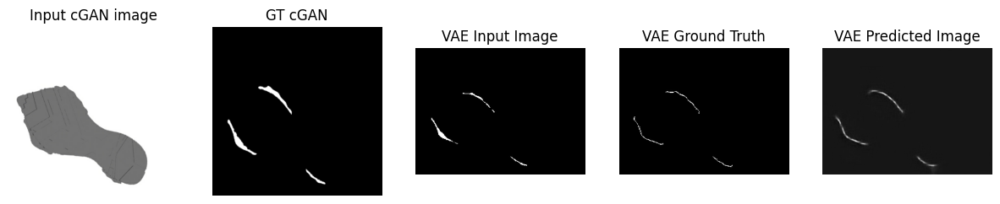

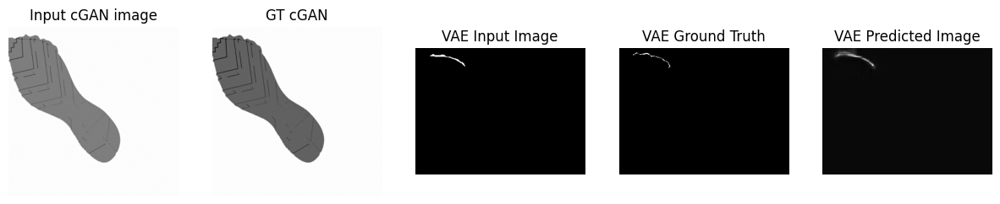

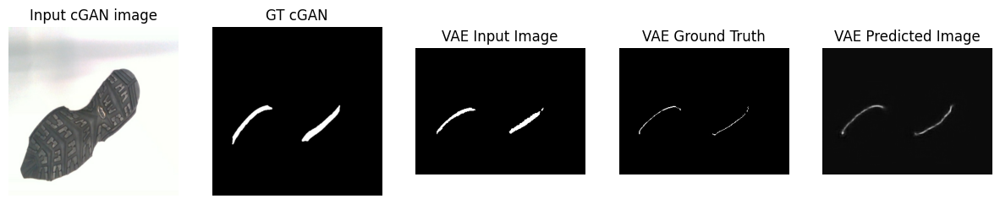

....................................................................................................Time taken for 1000 steps: 1329.40 sec

[Epochs-interval: 4/6]__Step: 67k/123k
Train set ELBO: -0.0013657088857144117


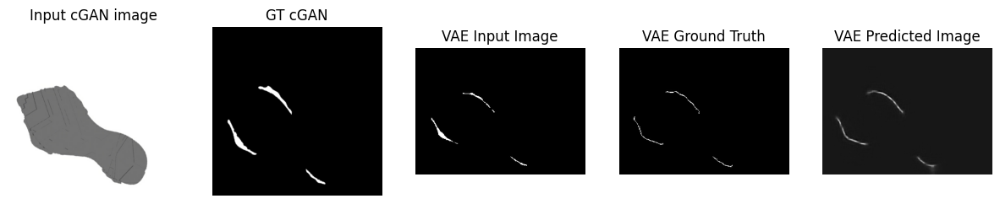

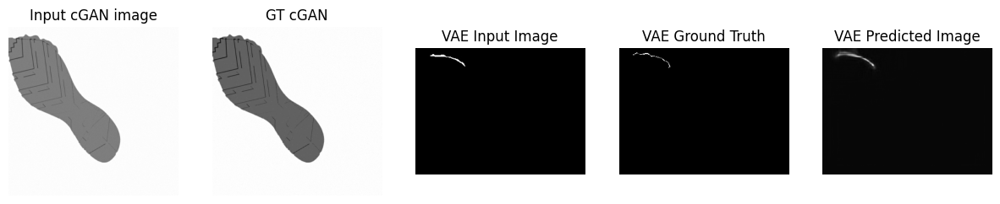

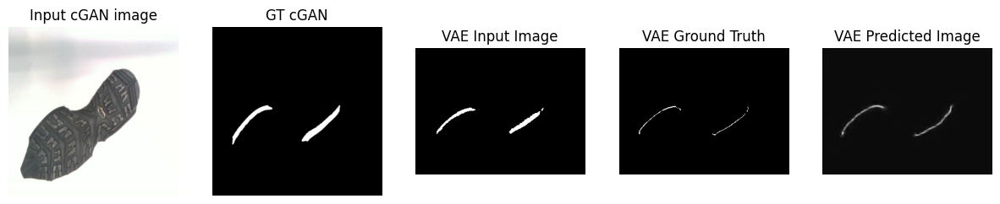

....................................................................................................Time taken for 1000 steps: 1350.36 sec

[Epochs-interval: 4/6]__Step: 68k/123k
Train set ELBO: -0.0013780152658000588


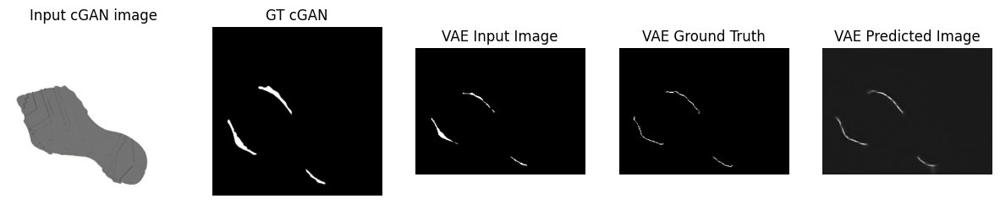

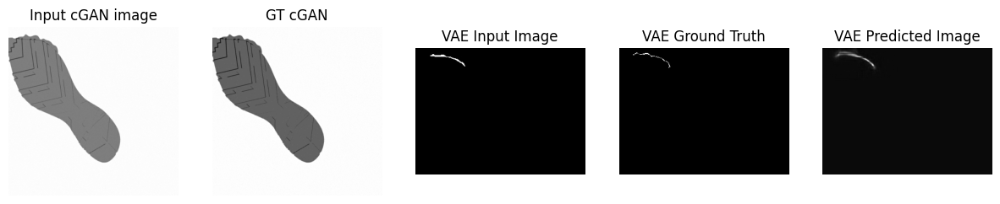

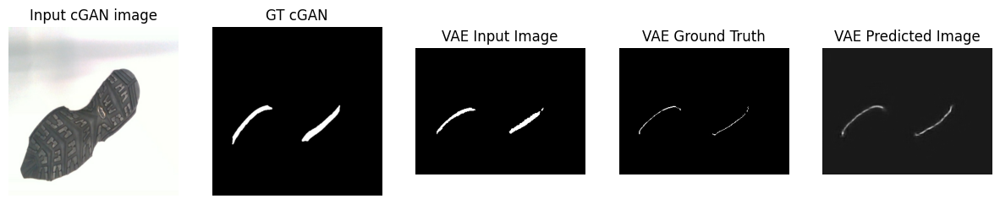

....................................................................................................Time taken for 1000 steps: 1371.02 sec

[Epochs-interval: 4/6]__Step: 69k/123k
Train set ELBO: -0.0013816608116030693


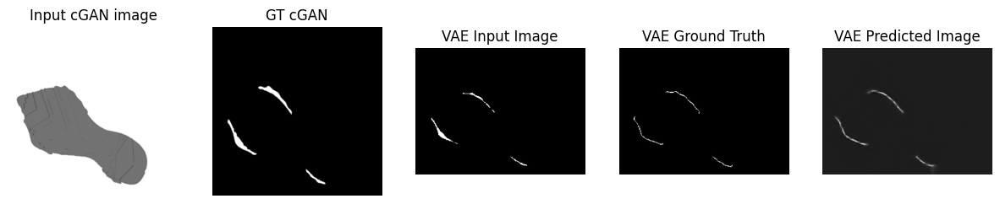

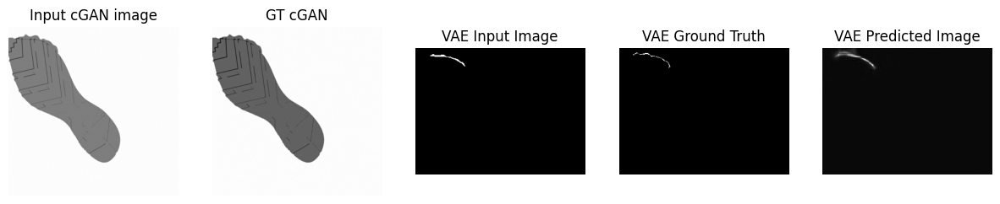

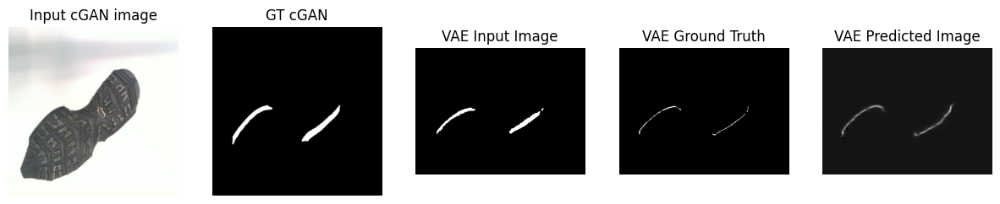

....................................................................................................Time taken for 1000 steps: 1391.80 sec

[Epochs-interval: 4/6]__Step: 70k/123k
Train set ELBO: -0.0013983011012896895


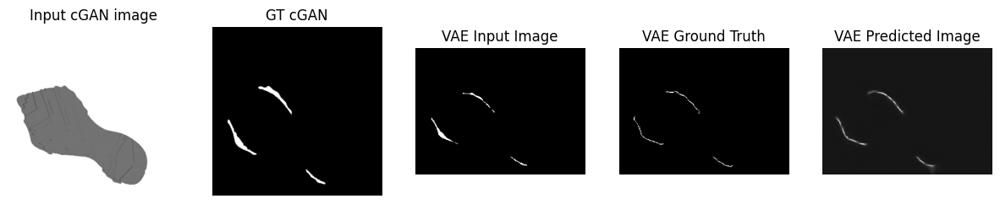

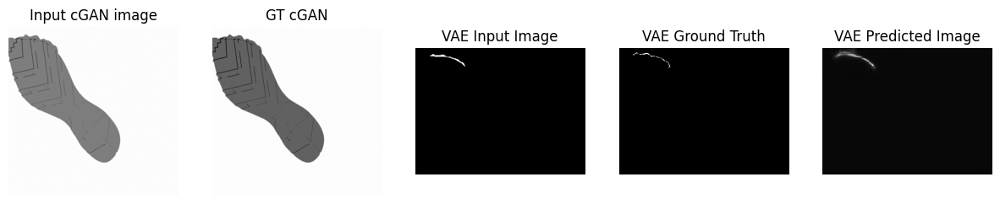

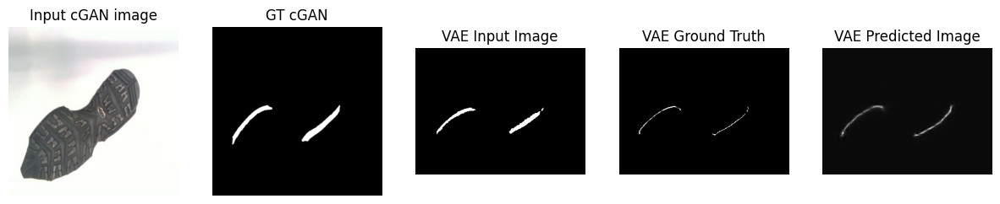

....................................................................................................Time taken for 1000 steps: 1412.94 sec

[Epochs-interval: 4/6]__Step: 71k/123k
Train set ELBO: -0.0013894268777221441


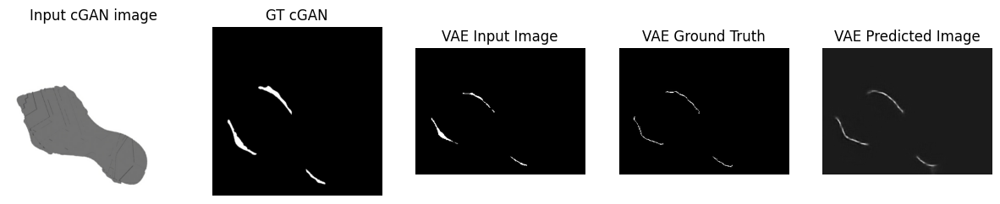

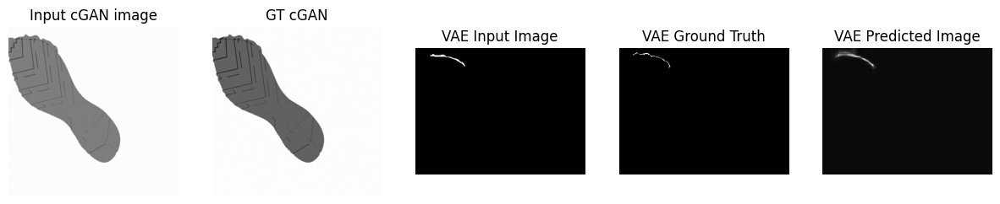

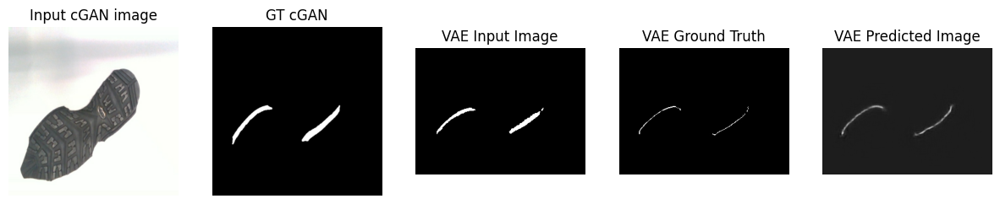

....................................................................................................Time taken for 1000 steps: 1433.52 sec

[Epochs-interval: 4/6]__Step: 72k/123k
Train set ELBO: -0.0014066067524254322


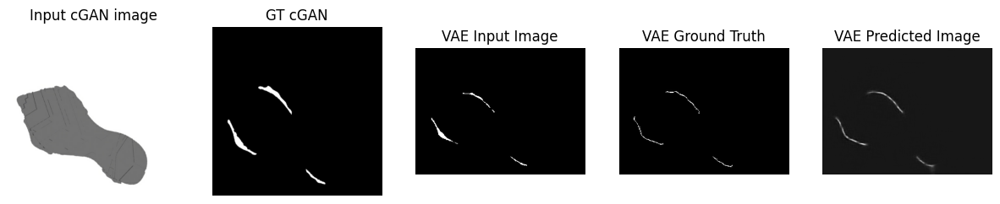

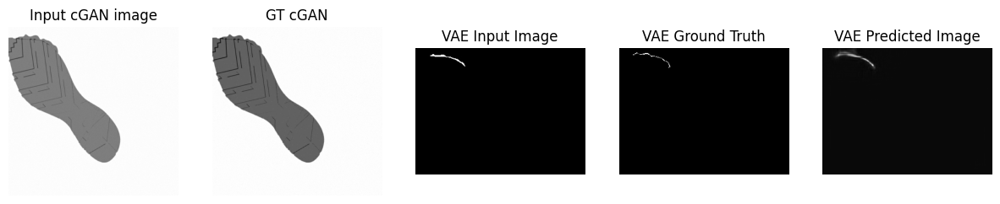

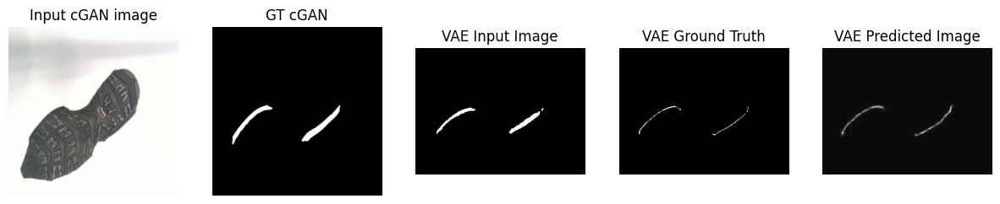

....................................................................................................Time taken for 1000 steps: 1454.06 sec

[Epochs-interval: 4/6]__Step: 73k/123k
Train set ELBO: -0.0014034536434337497


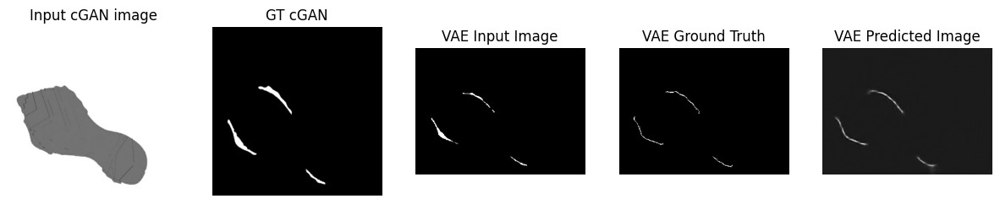

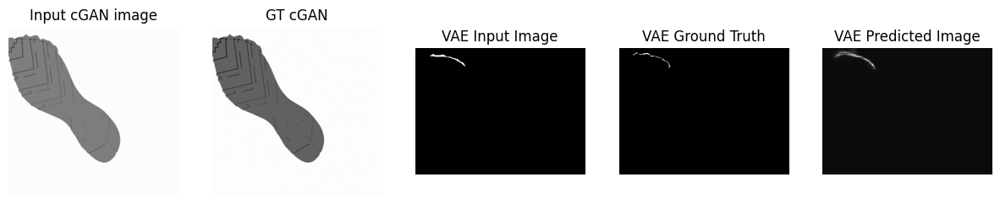

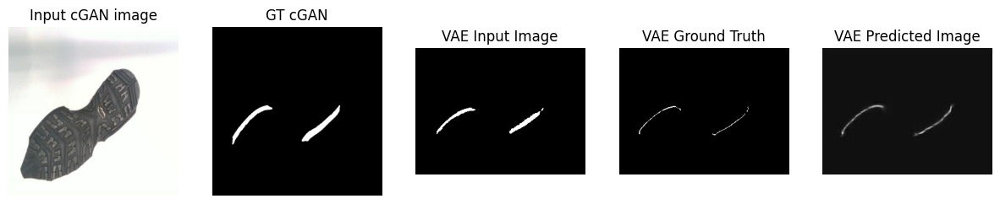

....................................................................................................Time taken for 1000 steps: 1474.99 sec

[Epochs-interval: 4/6]__Step: 74k/123k
Train set ELBO: -0.0013847412774339318


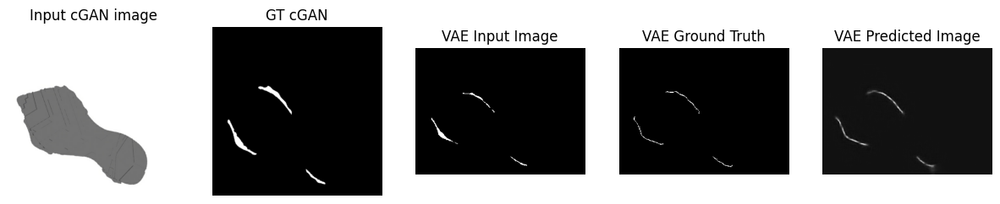

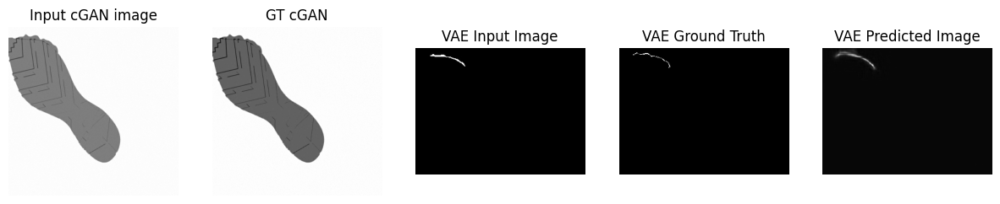

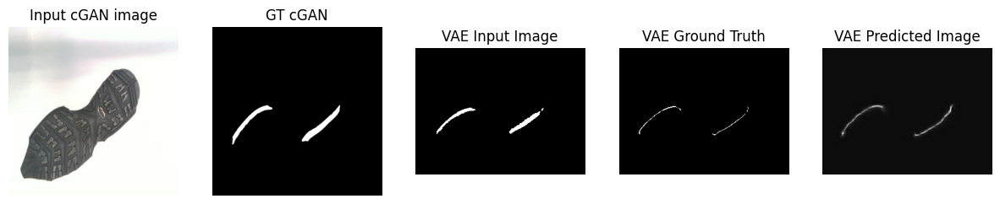

....................................................................................................Time taken for 1000 steps: 1496.22 sec

[Epochs-interval: 4/6]__Step: 75k/123k
Train set ELBO: -0.001391370315104723


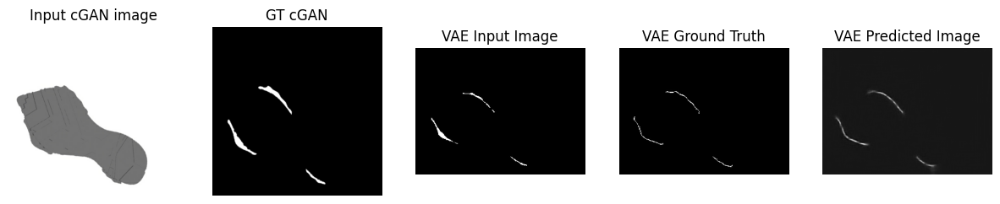

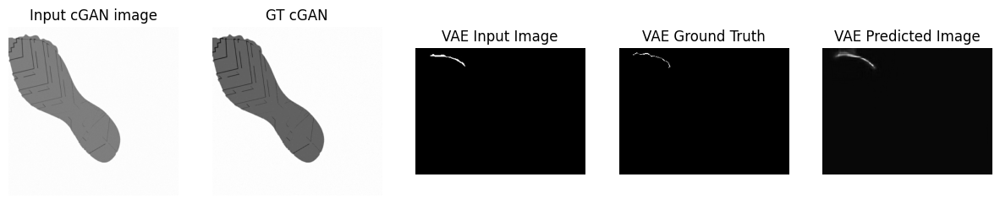

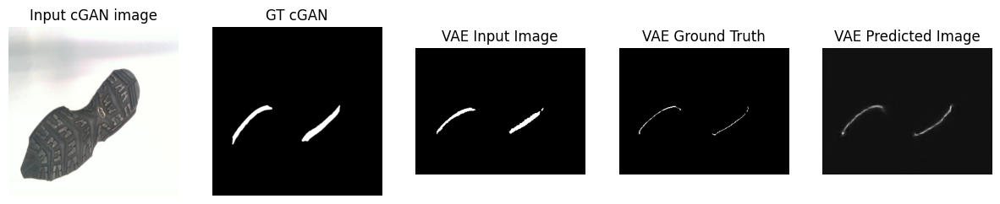

....................................................................................................Time taken for 1000 steps: 1517.88 sec

[Epochs-interval: 4/6]__Step: 76k/123k
Train set ELBO: -0.0013733014930039644


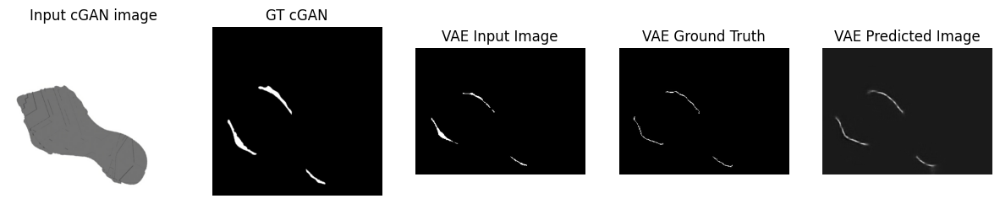

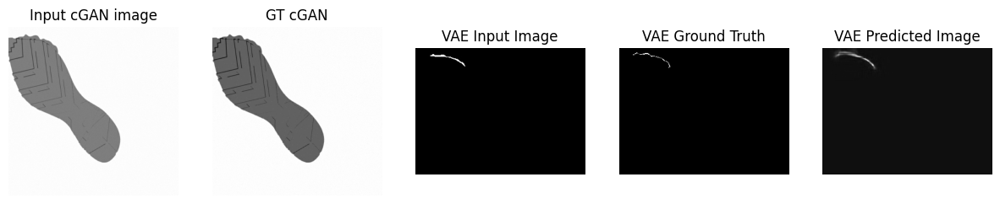

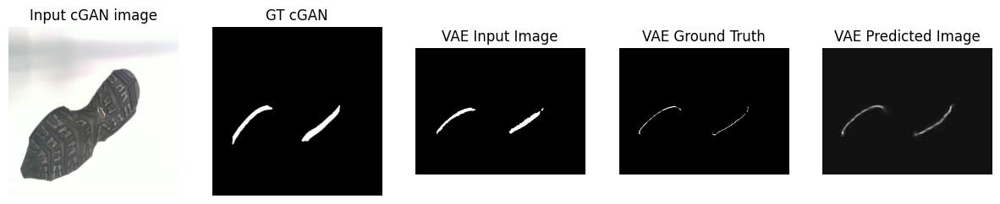

....................................................................................................Time taken for 1000 steps: 1538.62 sec

[Epochs-interval: 4/6]__Step: 77k/123k
Train set ELBO: -0.0013602373655885458


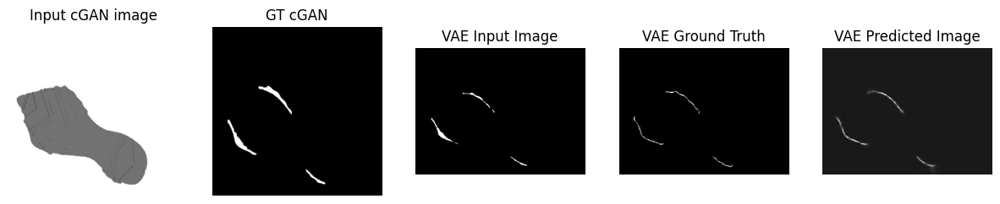

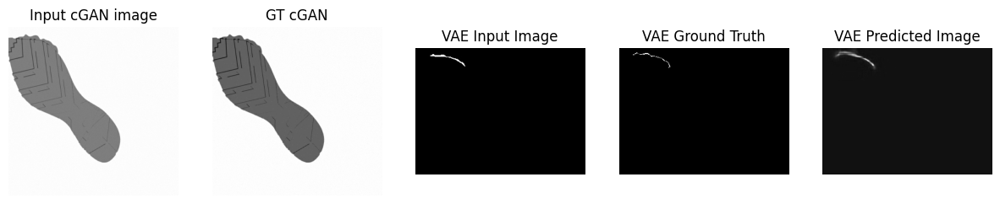

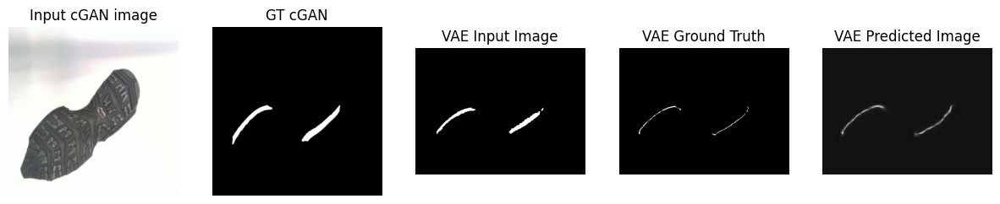

....................................................................................................Time taken for 1000 steps: 1559.52 sec

[Epochs-interval: 4/6]__Step: 78k/123k
Train set ELBO: -0.0013531410368159413


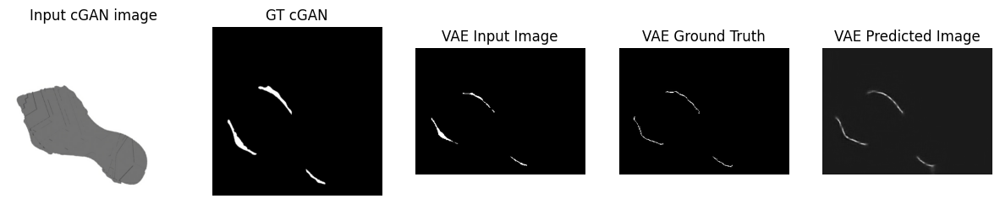

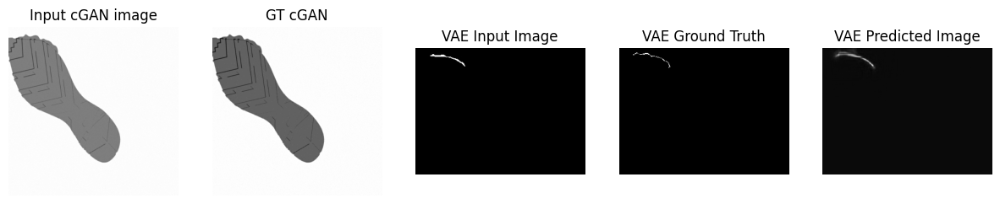

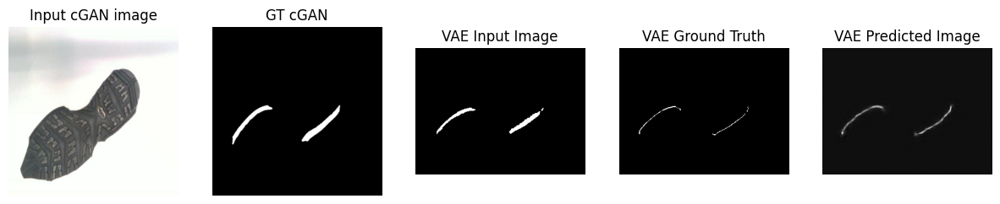

....................................................................................................Time taken for 1000 steps: 1581.17 sec

[Epochs-interval: 4/6]__Step: 79k/123k
Train set ELBO: -0.0013527927221730351


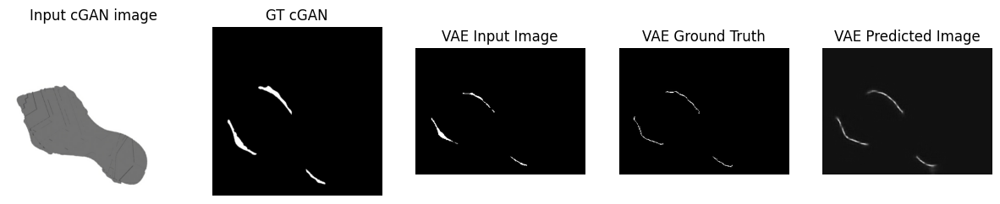

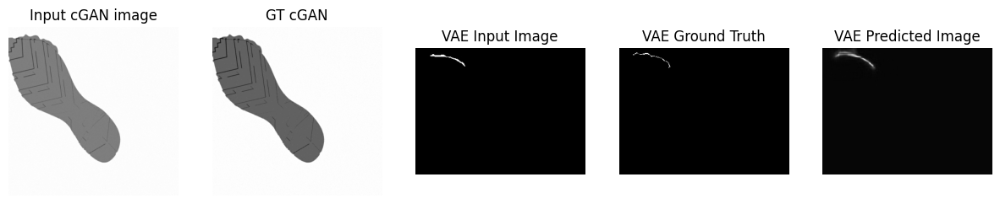

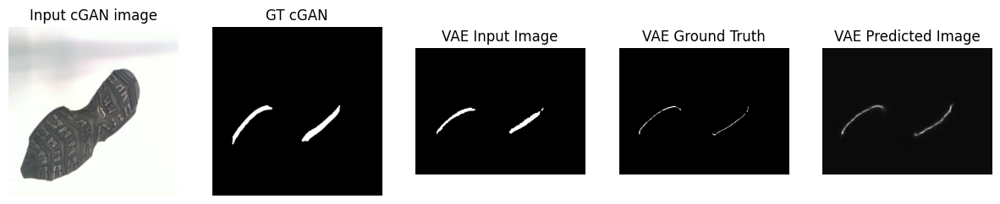

....................................................................................................Time taken for 1000 steps: 1601.75 sec

[Epochs-interval: 4/6]__Step: 80k/123k
Train set ELBO: -0.001343949930742383


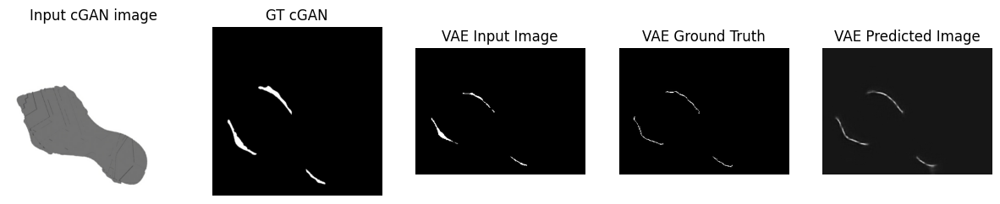

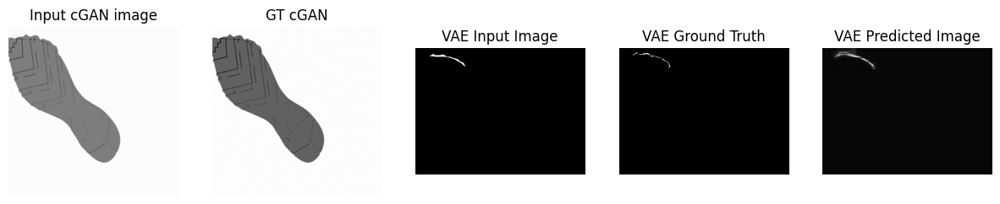

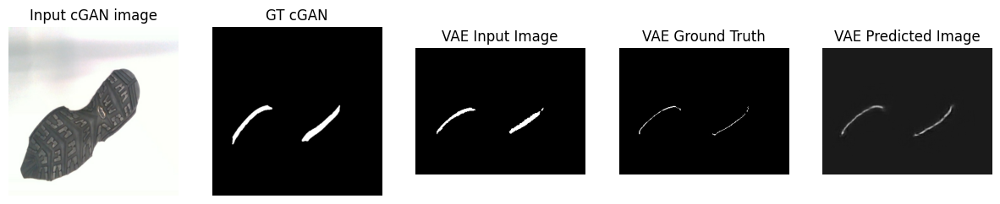

....................................................................................................Time taken for 1000 steps: 1622.77 sec

[Epochs-interval: 4/6]__Step: 81k/123k
Train set ELBO: -0.0013558458304032683


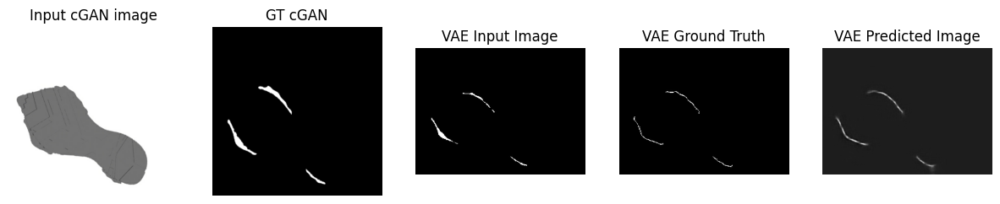

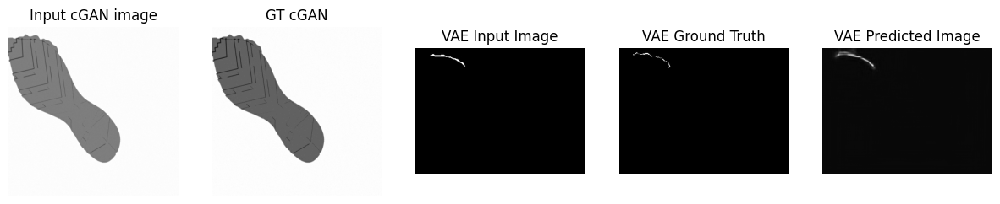

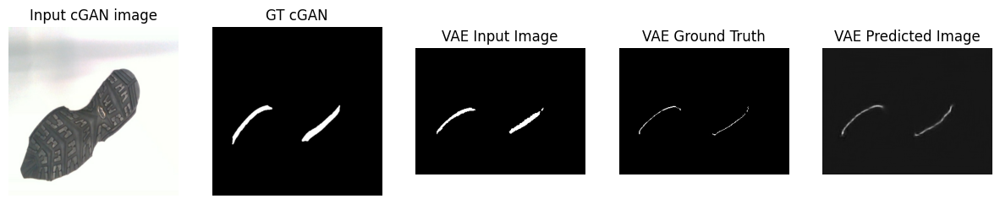

....................................................................................................Time taken for 1000 steps: 1643.55 sec

[Epochs-interval: 5/6]__Step: 82k/123k
Train set ELBO: -0.0013636371586471796


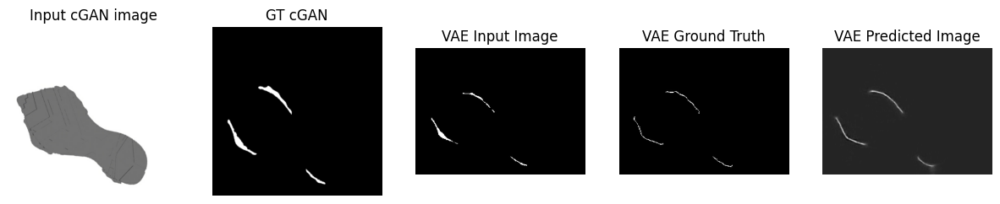

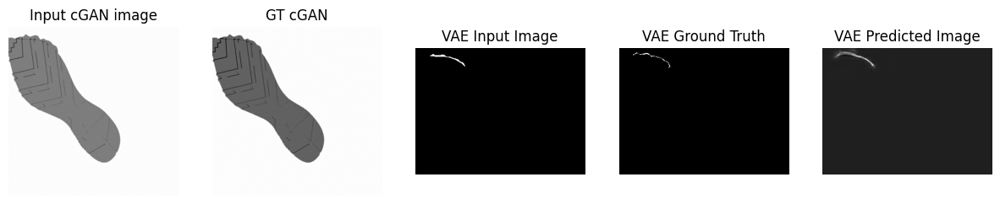

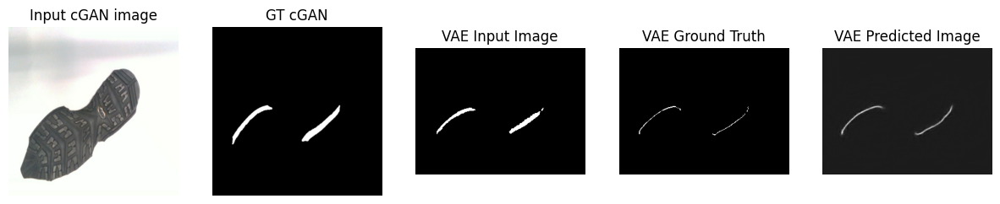

....................................................................................................Time taken for 1000 steps: 1664.30 sec

[Epochs-interval: 5/6]__Step: 83k/123k
Train set ELBO: -0.001379112247377634


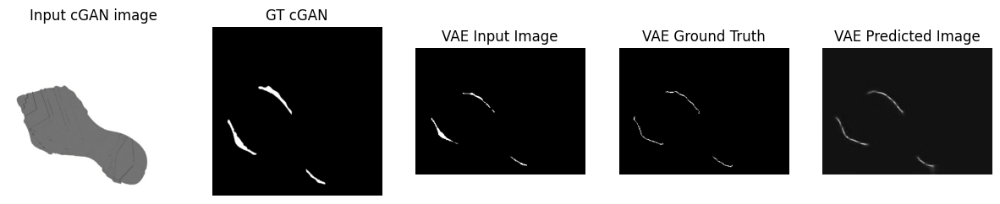

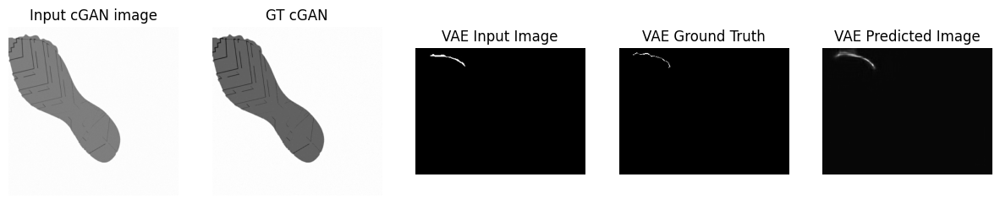

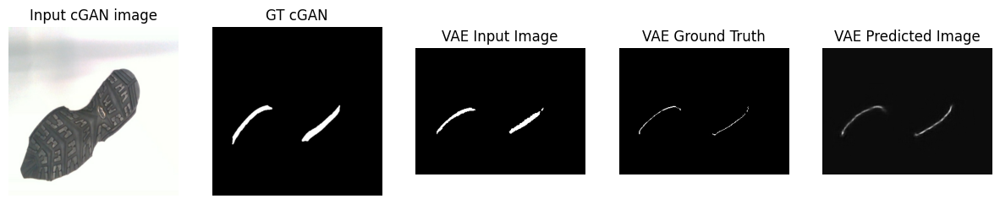

....................................................................................................Time taken for 1000 steps: 1685.46 sec

[Epochs-interval: 5/6]__Step: 84k/123k
Train set ELBO: -0.0013761583250015974


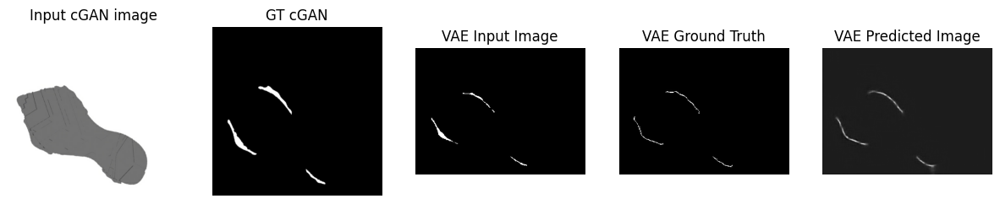

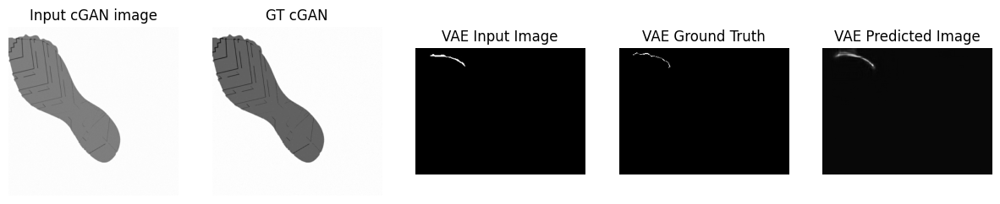

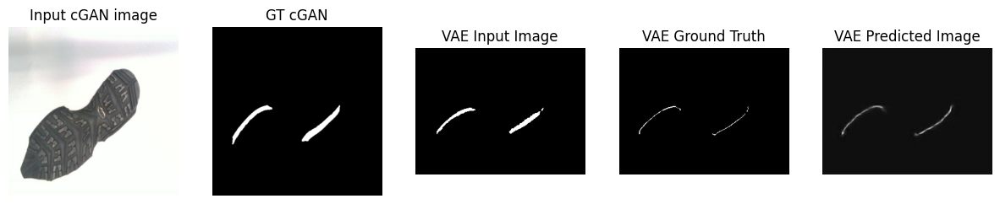

....................................................................................................Time taken for 1000 steps: 1706.09 sec

[Epochs-interval: 5/6]__Step: 85k/123k
Train set ELBO: -0.0013803258771076798


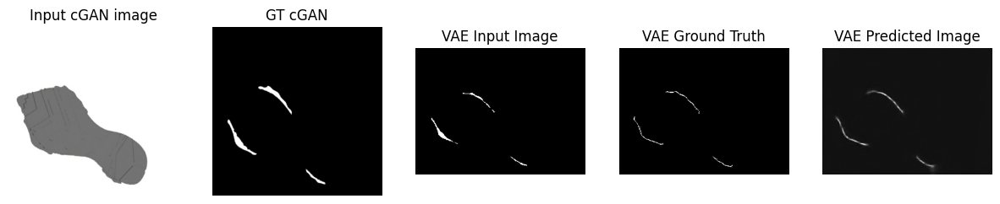

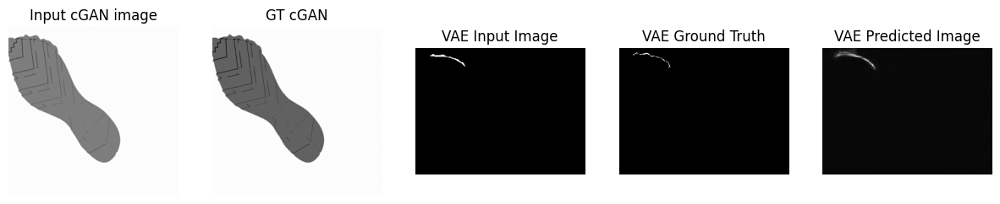

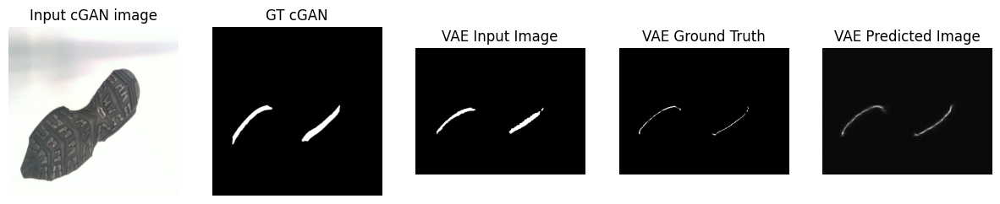

....................................................................................................Time taken for 1000 steps: 1726.72 sec

[Epochs-interval: 5/6]__Step: 86k/123k
Train set ELBO: -0.0013692472130060196


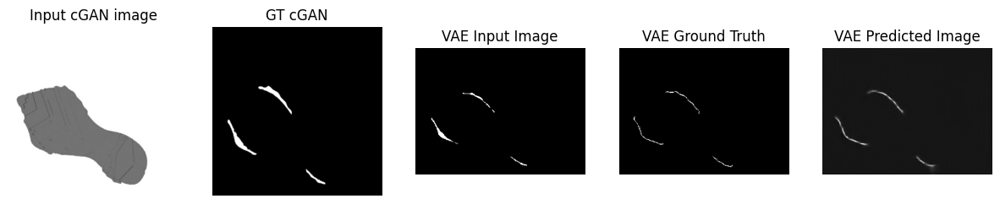

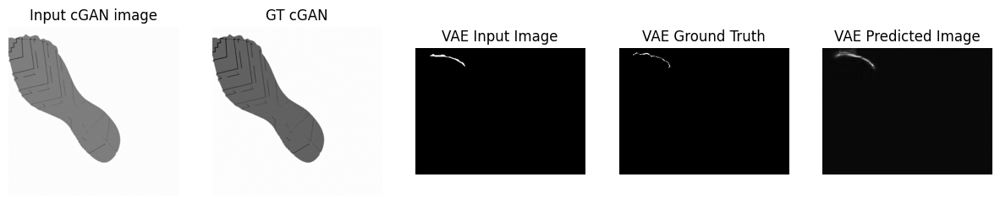

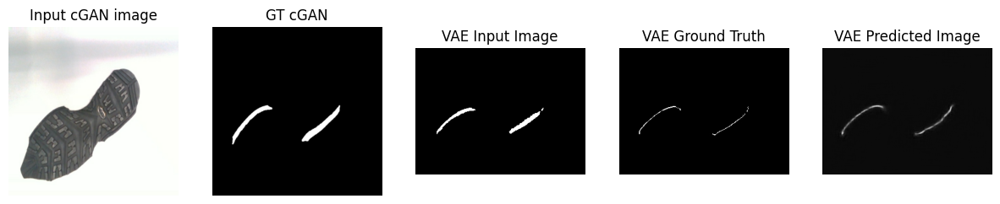

....................................................................................................Time taken for 1000 steps: 1748.45 sec

[Epochs-interval: 5/6]__Step: 87k/123k
Train set ELBO: -0.0013658986426889896


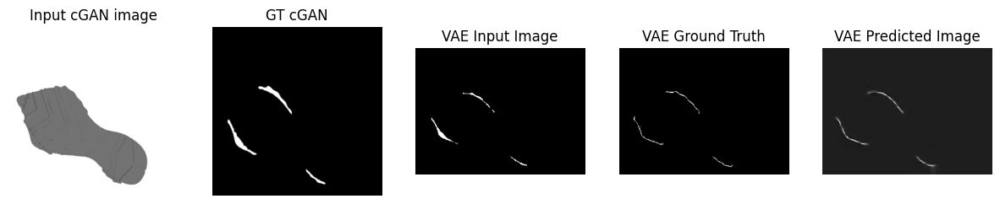

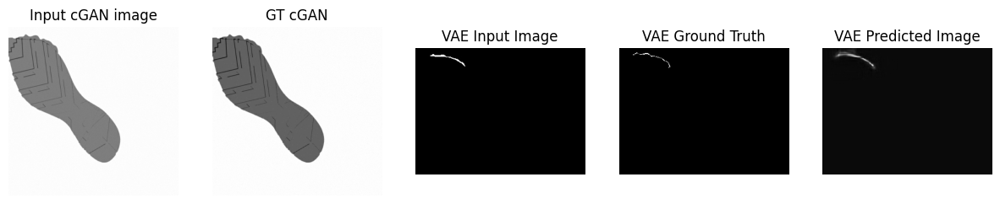

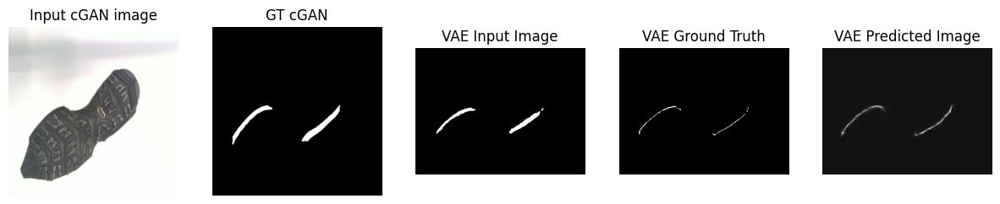

....................................................................................................Time taken for 1000 steps: 1769.65 sec

[Epochs-interval: 5/6]__Step: 88k/123k
Train set ELBO: -0.001369273173622787


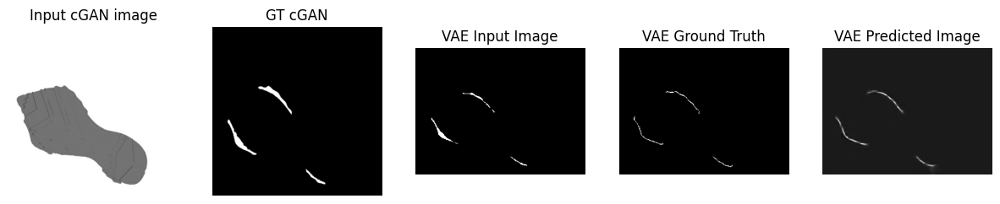

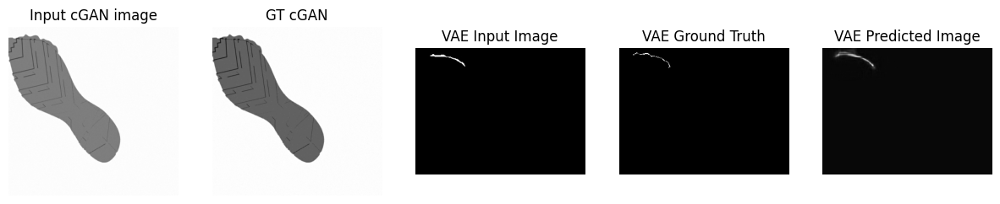

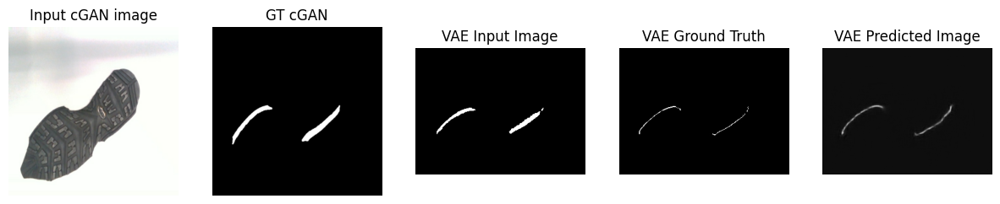

....................................................................................................Time taken for 1000 steps: 1790.42 sec

[Epochs-interval: 5/6]__Step: 89k/123k
Train set ELBO: -0.001365095842629671


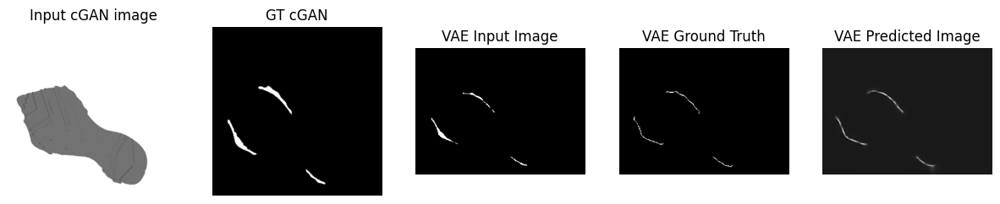

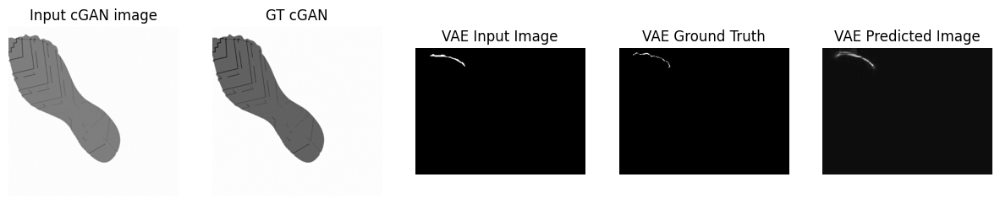

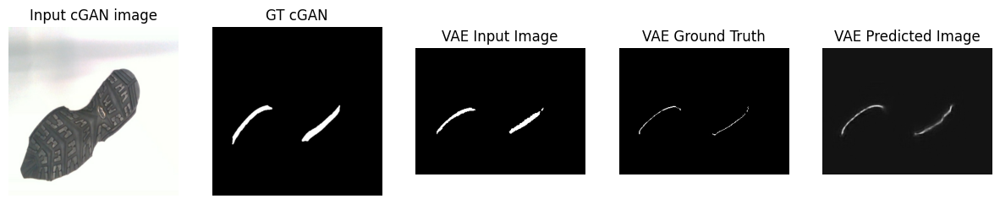

....................................................................................................Time taken for 1000 steps: 1811.60 sec

[Epochs-interval: 5/6]__Step: 90k/123k
Train set ELBO: -0.0013500950299203396


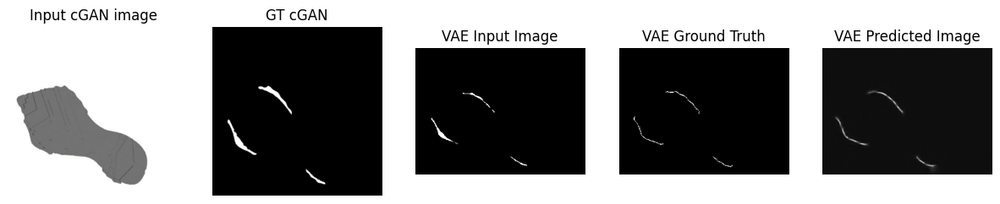

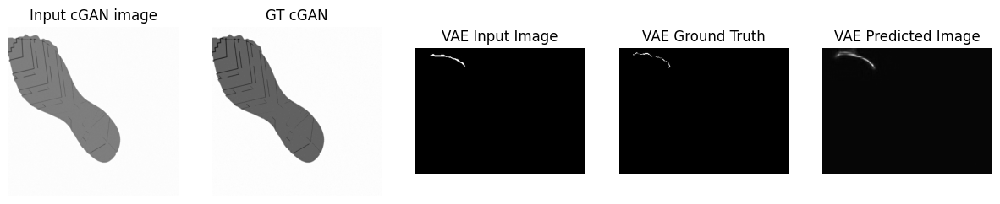

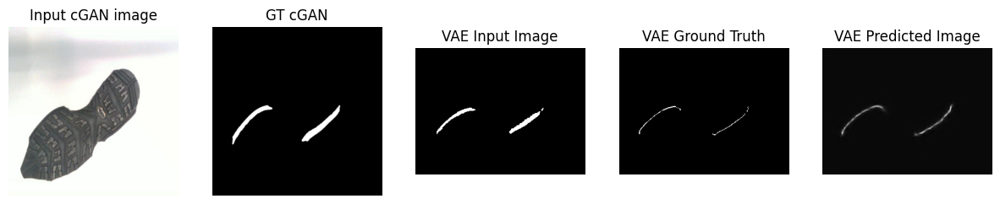

....................................................................................................Time taken for 1000 steps: 1832.91 sec

[Epochs-interval: 5/6]__Step: 91k/123k
Train set ELBO: -0.0013417709851637483


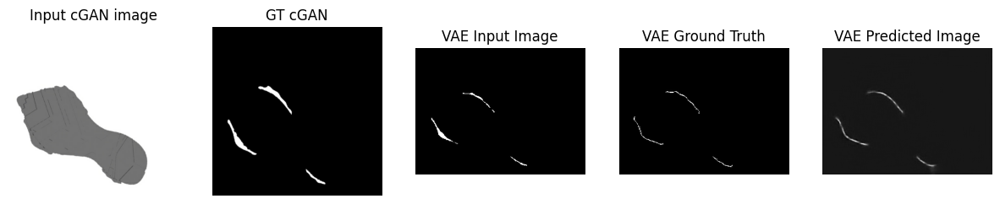

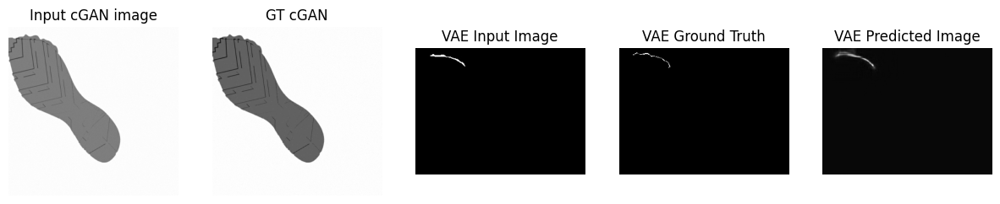

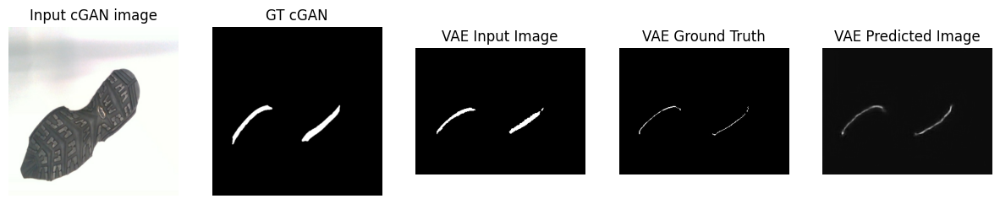

....................................................................................................Time taken for 1000 steps: 1854.44 sec

[Epochs-interval: 5/6]__Step: 92k/123k
Train set ELBO: -0.0013450449332594872


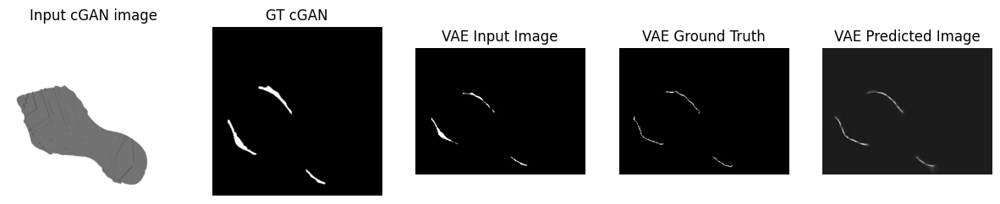

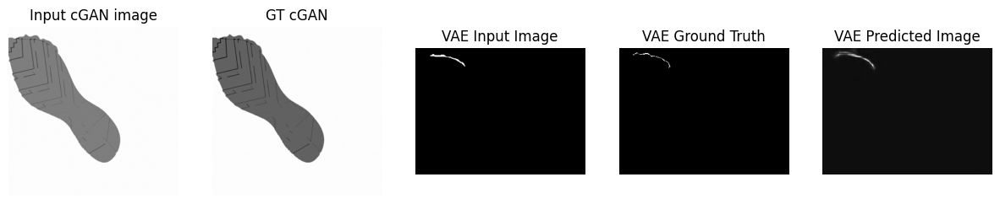

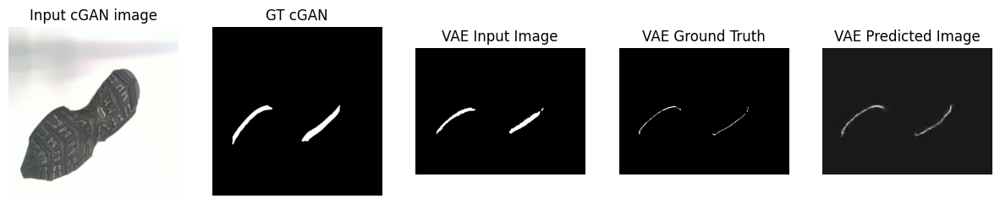

....................................................................................................Time taken for 1000 steps: 1875.26 sec

[Epochs-interval: 5/6]__Step: 93k/123k
Train set ELBO: -0.0013504339149221778


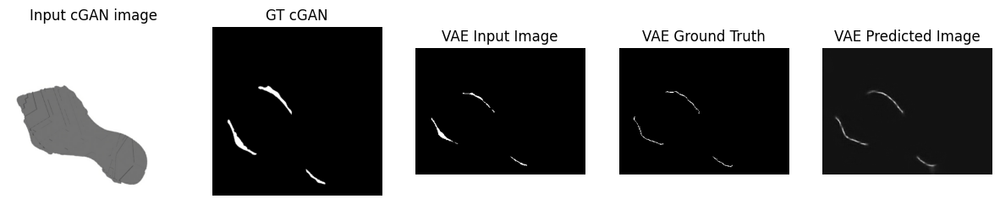

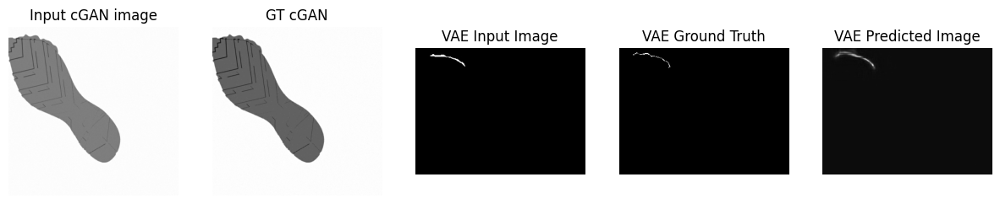

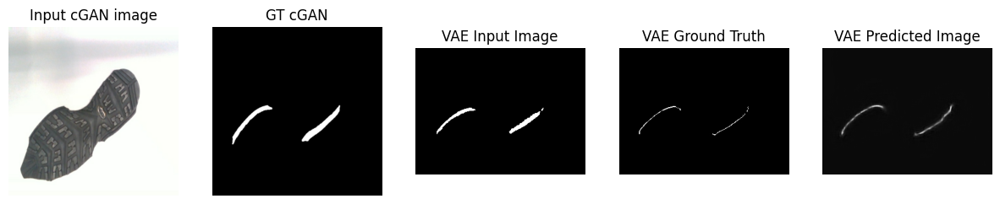

....................................................................................................Time taken for 1000 steps: 1896.24 sec

[Epochs-interval: 5/6]__Step: 94k/123k
Train set ELBO: -0.0013400306925177574


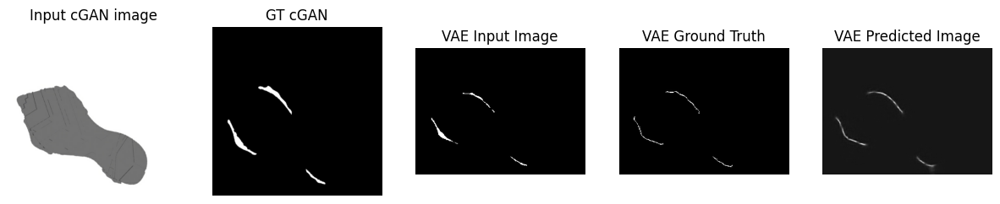

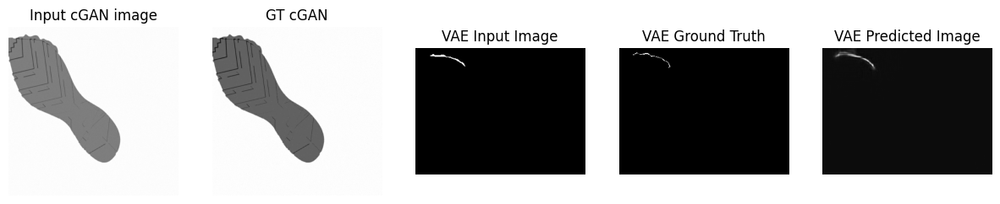

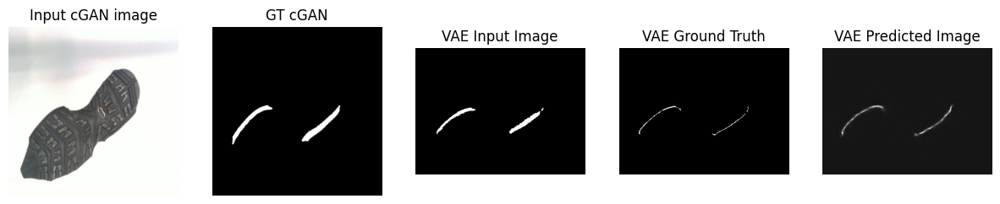

....................................................................................................Time taken for 1000 steps: 1916.94 sec

[Epochs-interval: 5/6]__Step: 95k/123k
Train set ELBO: -0.0013527022674679756


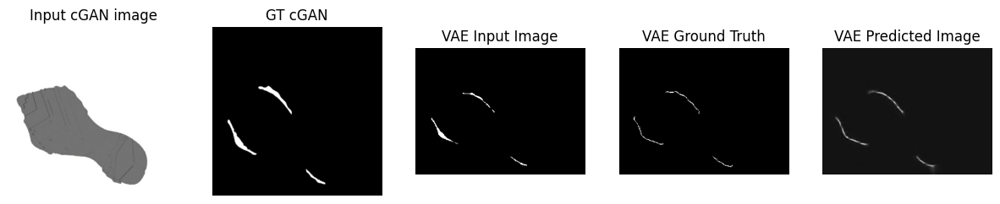

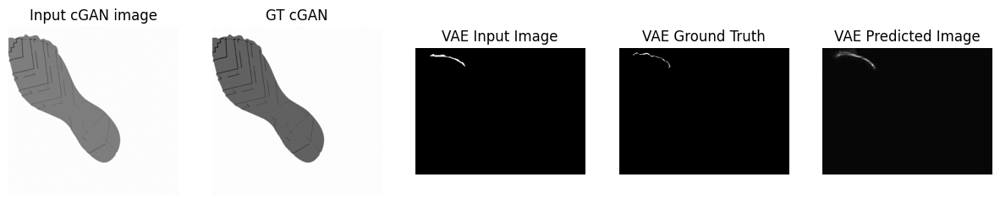

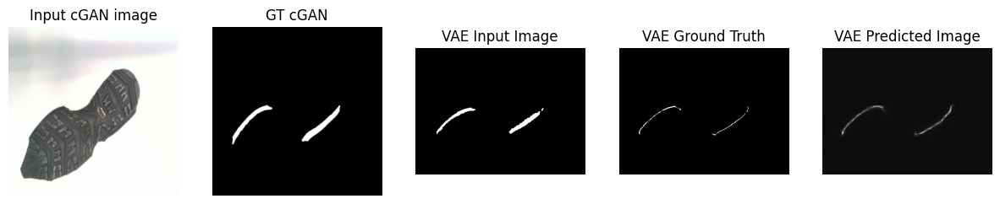

....................................................................................................Time taken for 1000 steps: 1938.28 sec

[Epochs-interval: 5/6]__Step: 96k/123k
Train set ELBO: -0.0013628947781398892


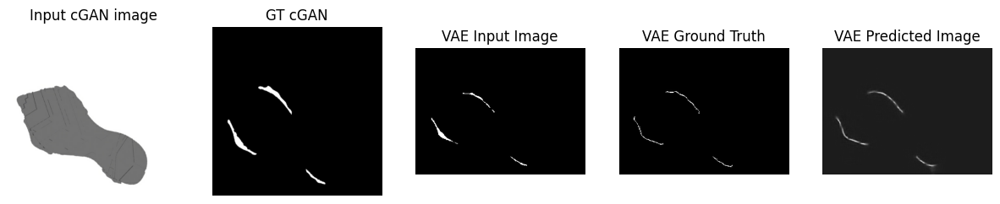

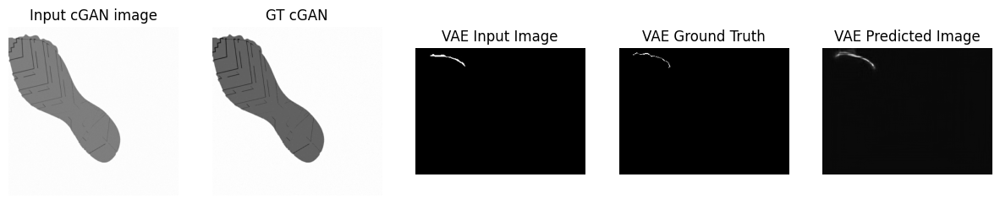

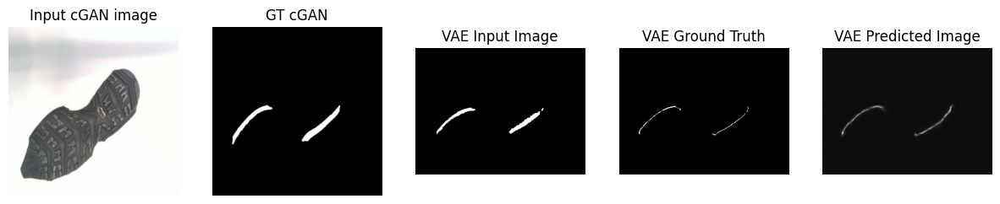

....................................................................................................Time taken for 1000 steps: 1959.10 sec

[Epochs-interval: 5/6]__Step: 97k/123k
Train set ELBO: -0.0013570451410487294


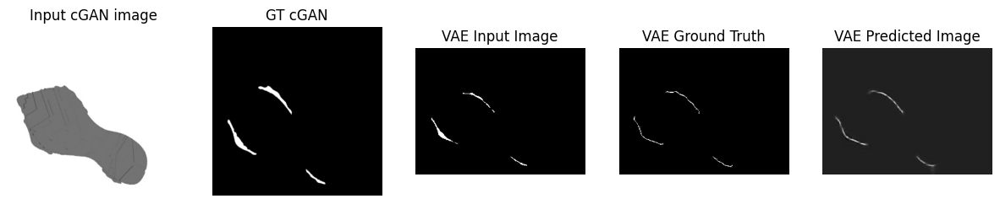

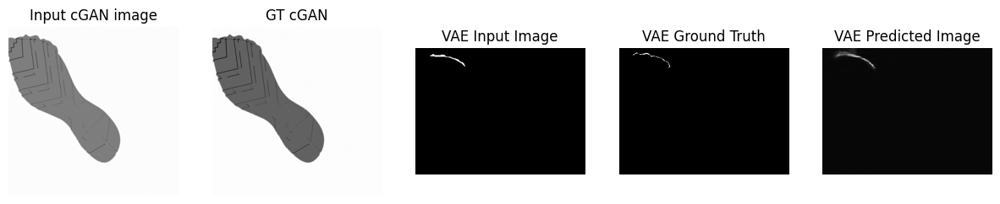

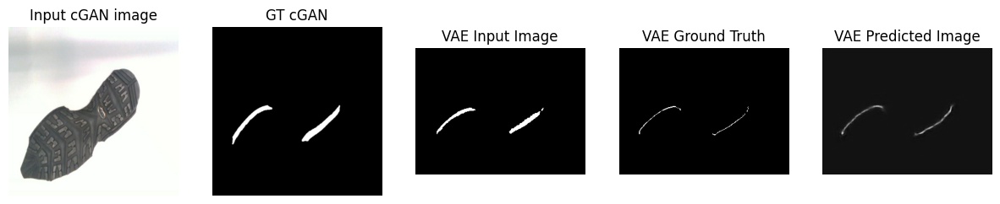

....................................................................................................Time taken for 1000 steps: 1980.13 sec

[Epochs-interval: 5/6]__Step: 98k/123k
Train set ELBO: -0.001355309272184968


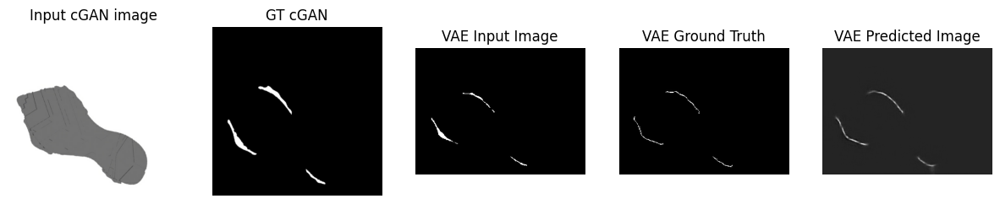

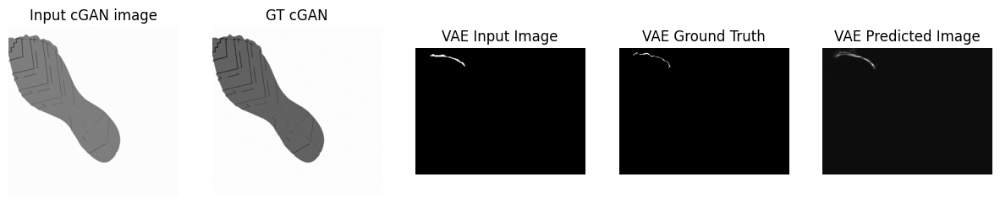

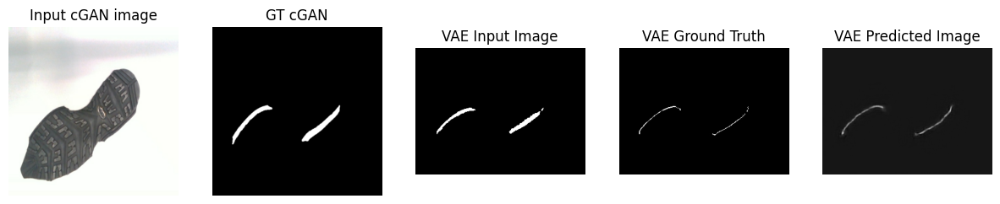

....................................................................................................Time taken for 1000 steps: 2000.61 sec

[Epochs-interval: 5/6]__Step: 99k/123k
Train set ELBO: -0.0013493869919329882


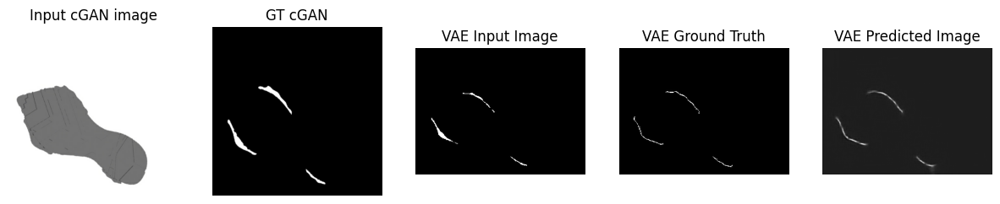

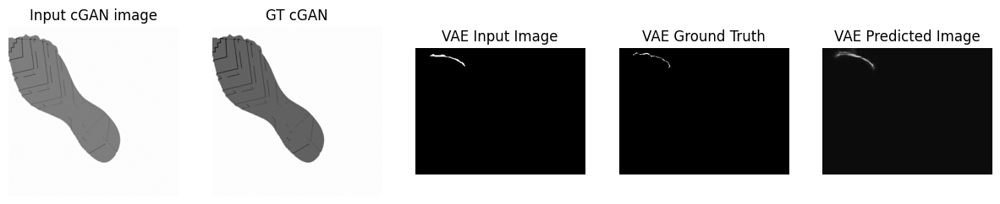

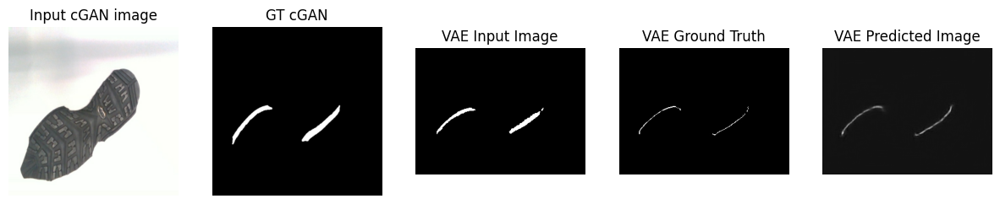

....................................................................................................Time taken for 1000 steps: 2022.39 sec

[Epochs-interval: 5/6]__Step: 100k/123k
Train set ELBO: -0.0013539086794480681


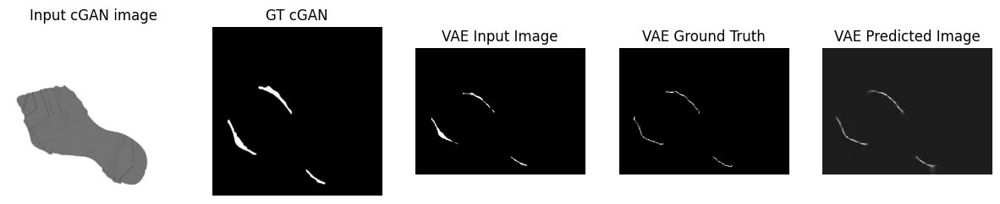

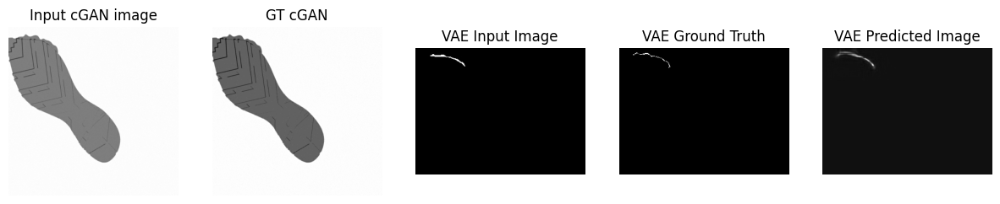

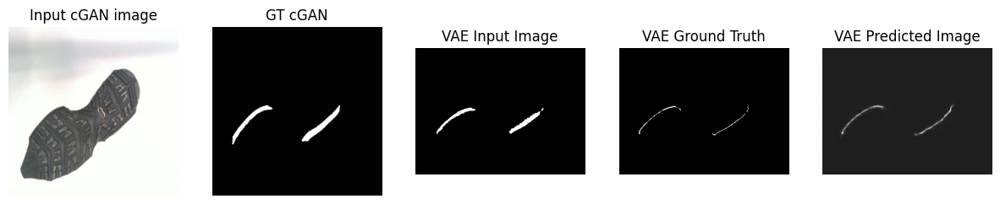

....................................................................................................Time taken for 1000 steps: 2042.98 sec

[Epochs-interval: 5/6]__Step: 101k/123k
Train set ELBO: -0.001359462272375822


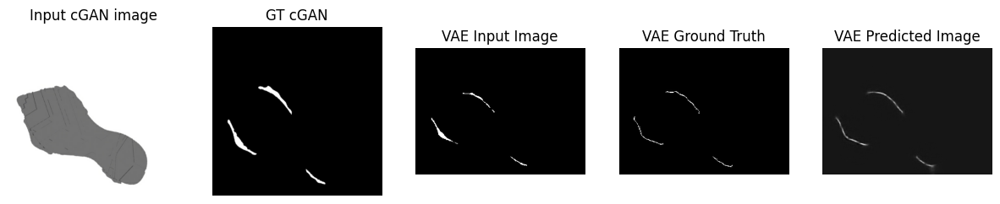

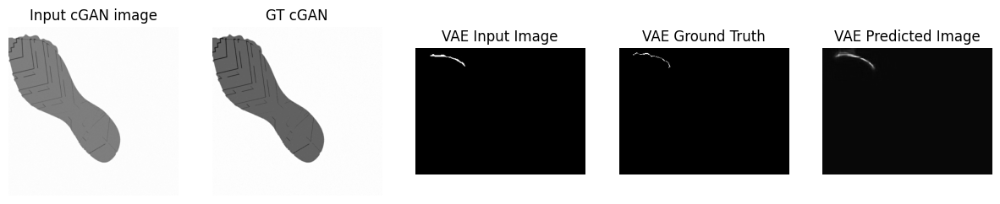

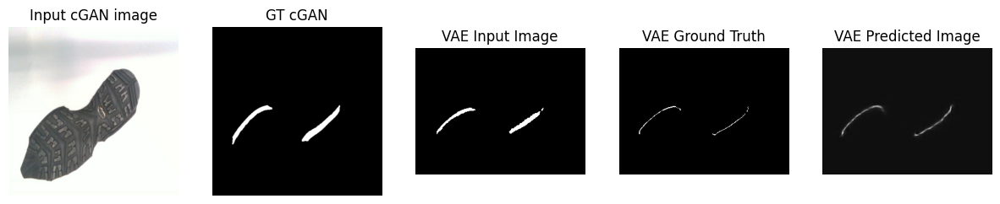

....................................................................................................Time taken for 1000 steps: 2063.64 sec

[Epochs-interval: 5/6]__Step: 102k/123k
Train set ELBO: -0.0013766721822321415


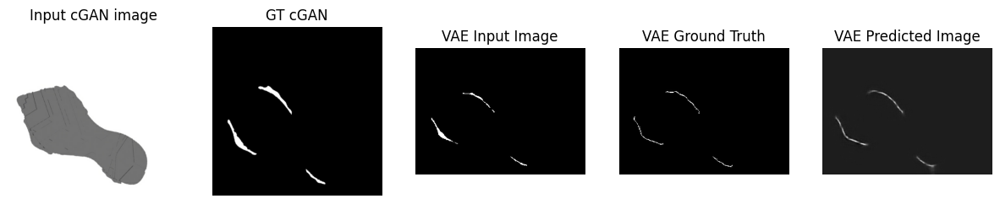

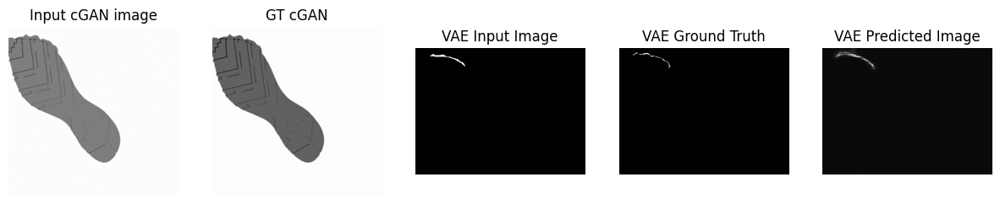

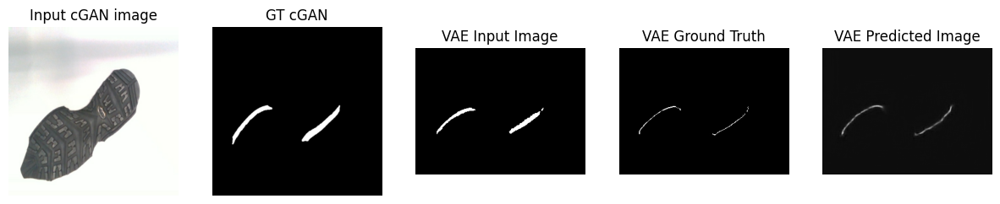

....................................................................................................Time taken for 1000 steps: 2084.57 sec

[Epochs-interval: 6/6]__Step: 103k/123k
Train set ELBO: -0.0013641100376844406


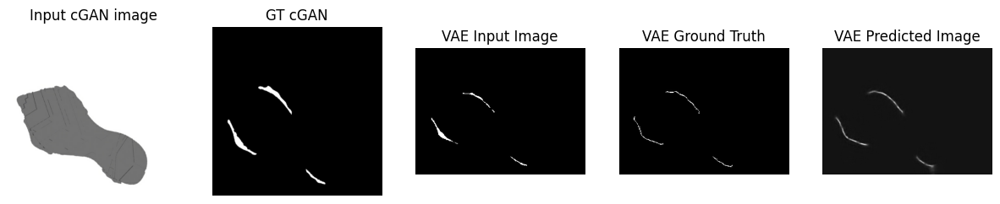

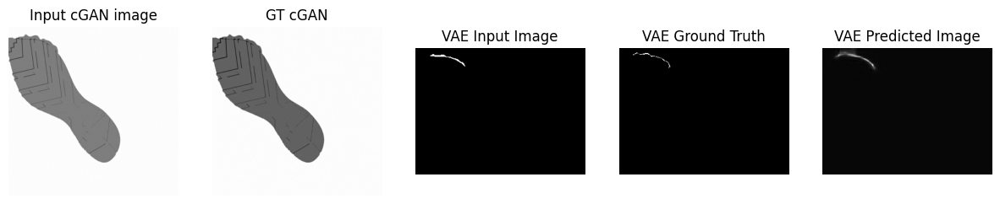

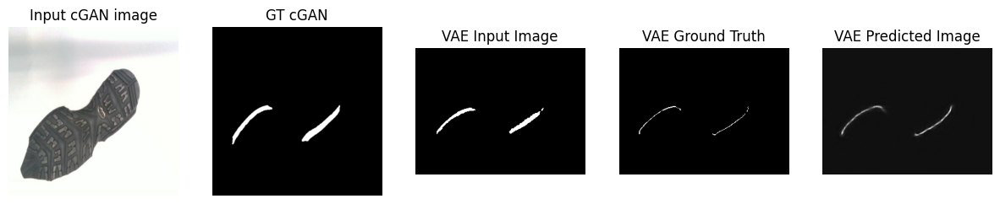

....................................................................................................Time taken for 1000 steps: 2105.71 sec

[Epochs-interval: 6/6]__Step: 104k/123k
Train set ELBO: -0.0013641876867040992


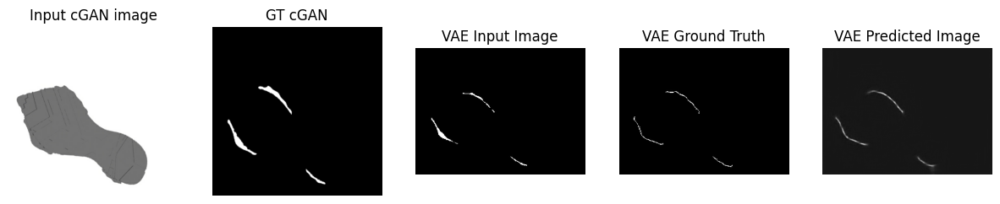

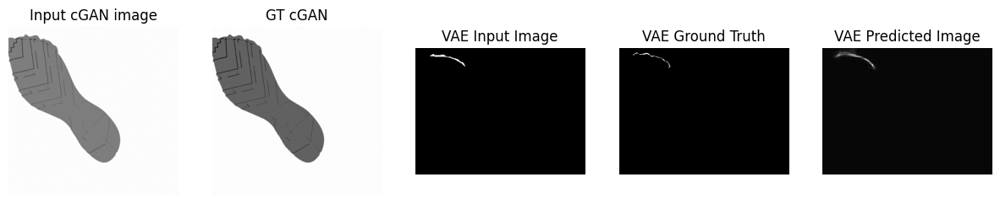

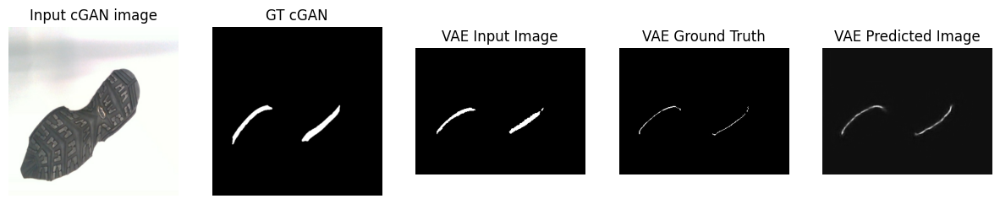

....................................................................................................Time taken for 1000 steps: 2126.63 sec

[Epochs-interval: 6/6]__Step: 105k/123k
Train set ELBO: -0.001351318322122097


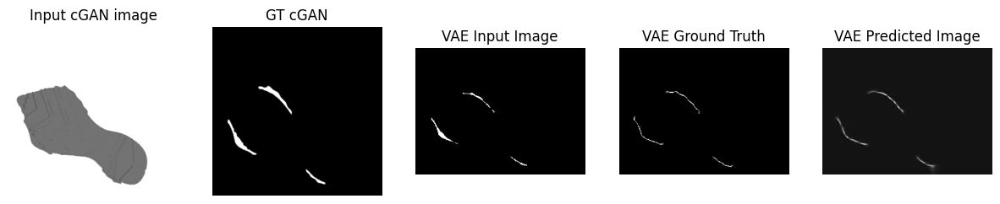

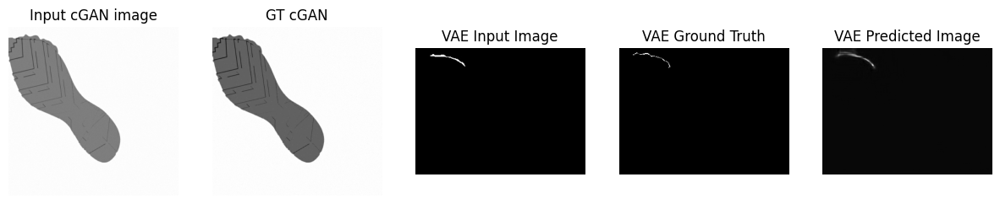

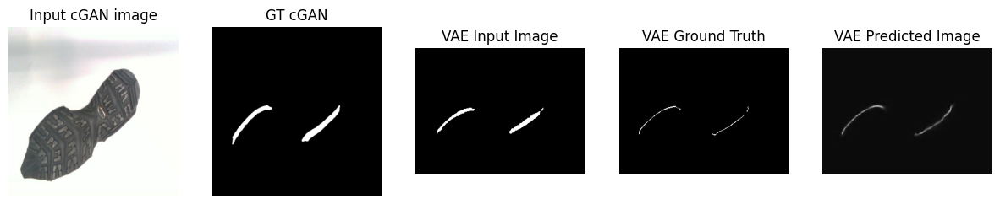

....................................................................................................Time taken for 1000 steps: 2147.54 sec

[Epochs-interval: 6/6]__Step: 106k/123k
Train set ELBO: -0.001347972545772791


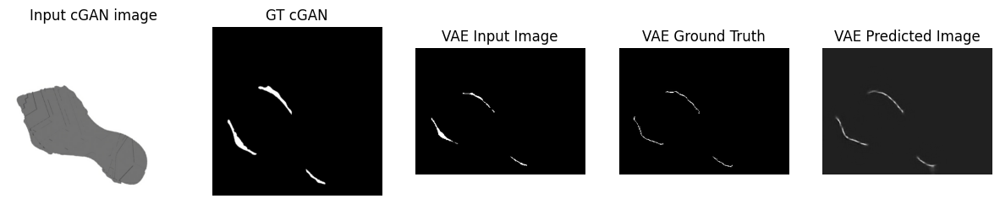

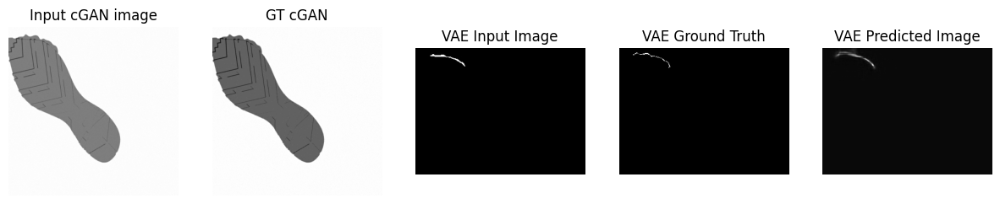

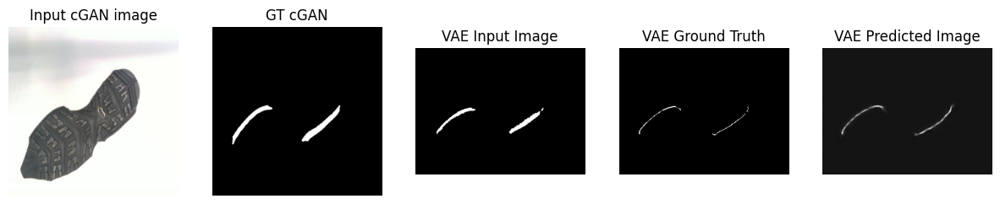

....................................................................................................Time taken for 1000 steps: 2168.07 sec

[Epochs-interval: 6/6]__Step: 107k/123k
Train set ELBO: -0.001335491775535047


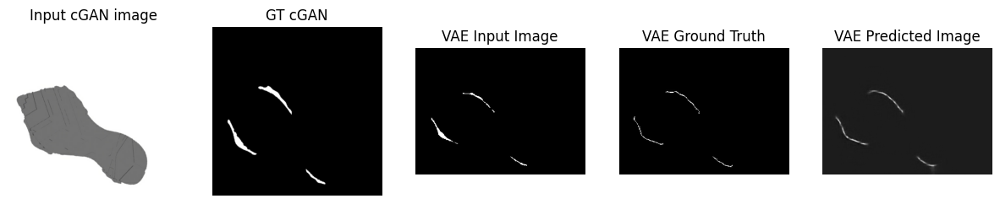

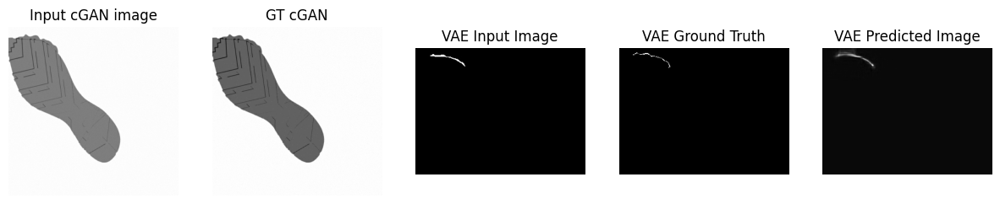

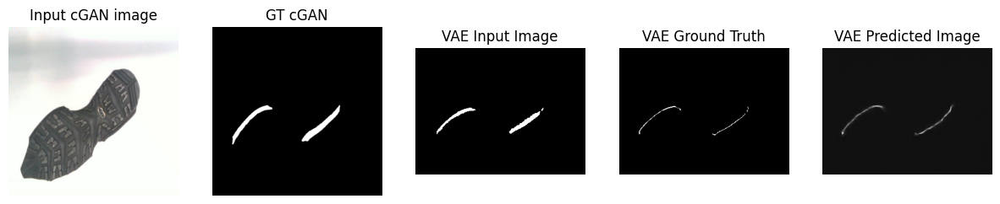

....................................................................................................Time taken for 1000 steps: 2188.91 sec

[Epochs-interval: 6/6]__Step: 108k/123k
Train set ELBO: -0.001326496945694089


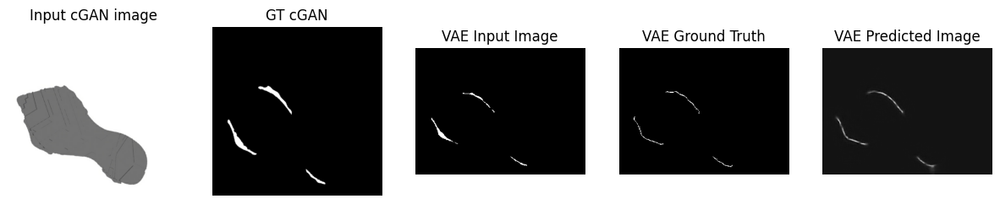

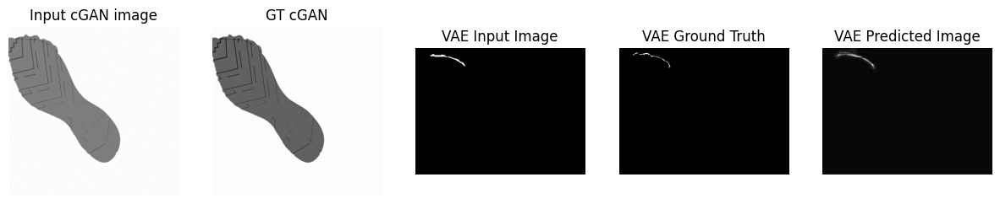

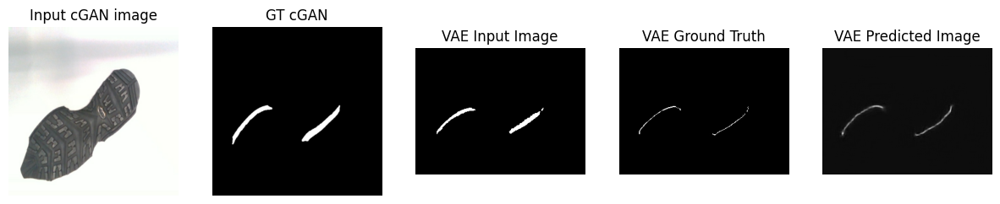

....................................................................................................Time taken for 1000 steps: 2209.88 sec

[Epochs-interval: 6/6]__Step: 109k/123k
Train set ELBO: -0.0013341951416805387


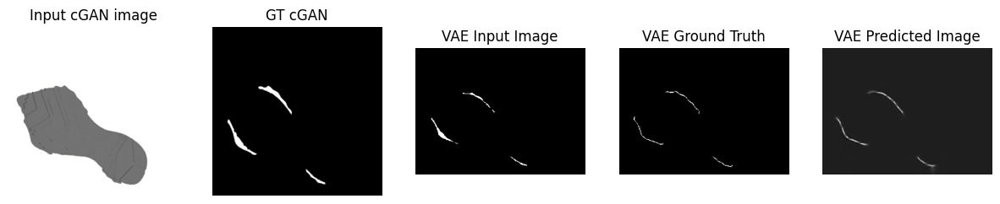

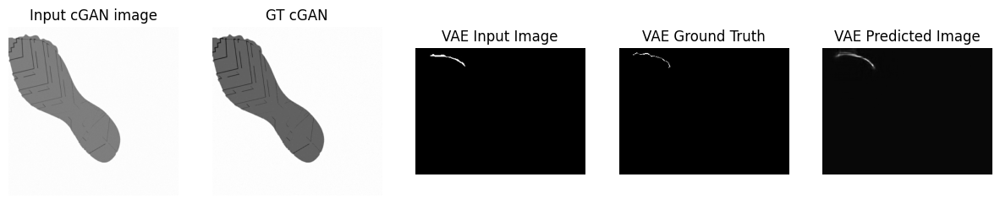

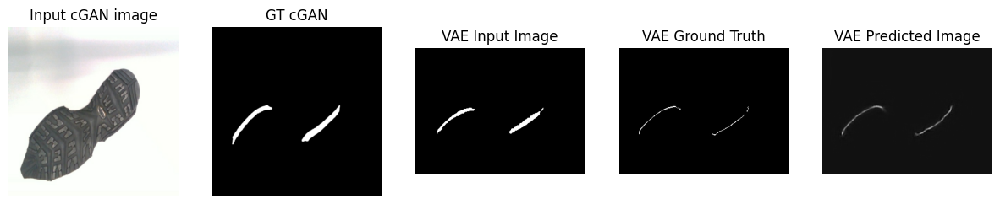

....................................................................................................Time taken for 1000 steps: 2230.85 sec

[Epochs-interval: 6/6]__Step: 110k/123k
Train set ELBO: -0.0013367334613576531


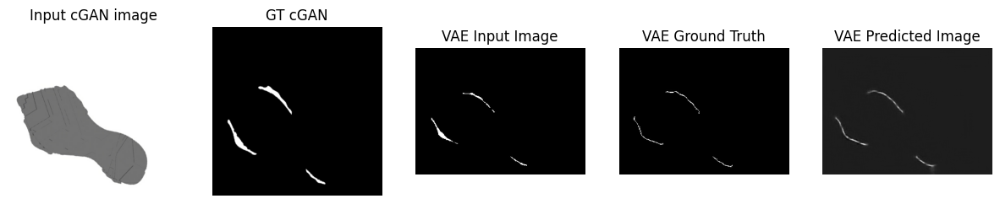

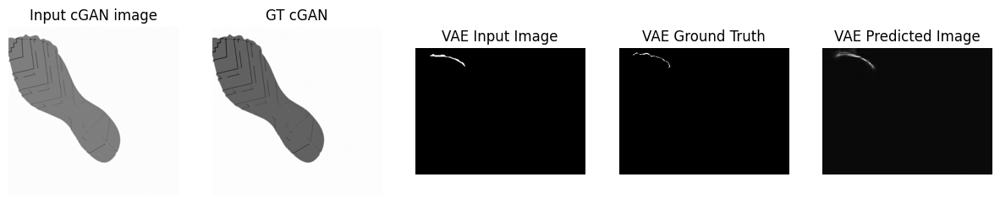

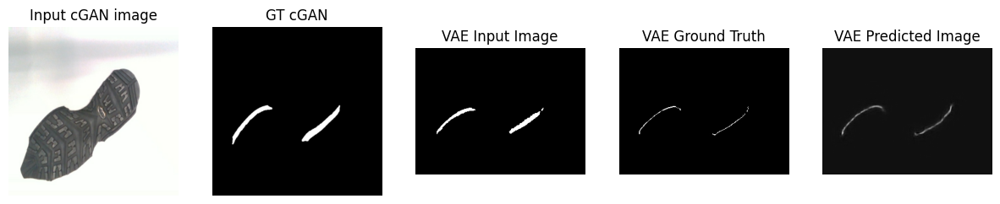

....................................................................................................Time taken for 1000 steps: 2252.24 sec

[Epochs-interval: 6/6]__Step: 111k/123k
Train set ELBO: -0.0013472309801727533


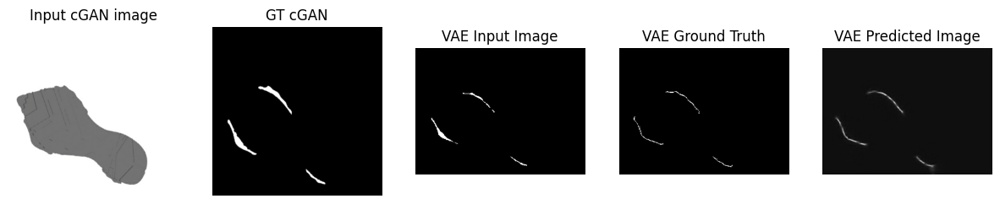

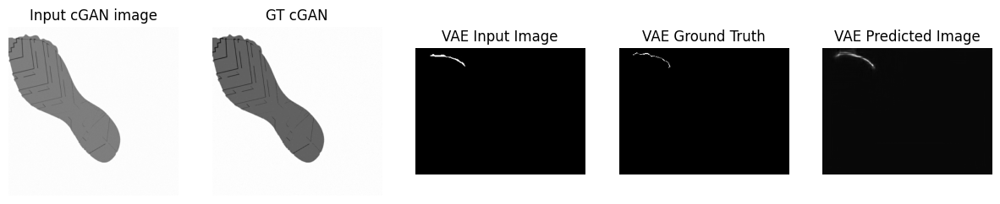

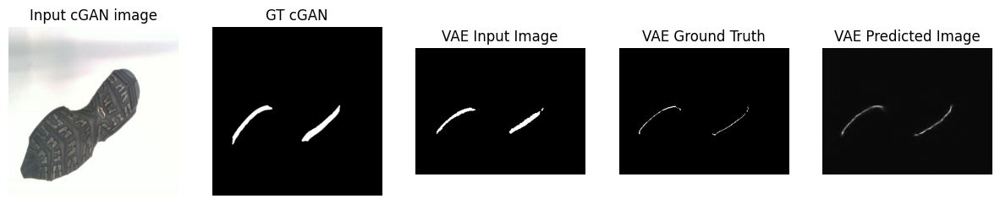

....................................................................................................Time taken for 1000 steps: 2273.11 sec

[Epochs-interval: 6/6]__Step: 112k/123k
Train set ELBO: -0.001341873430646956


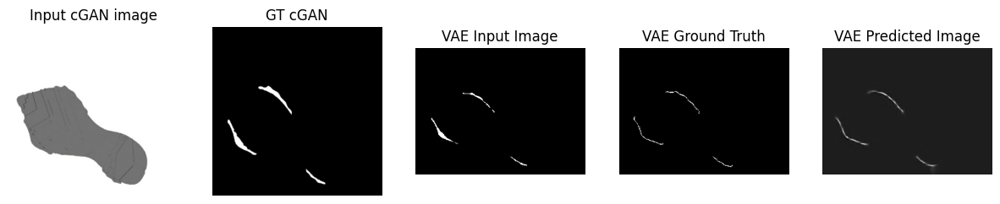

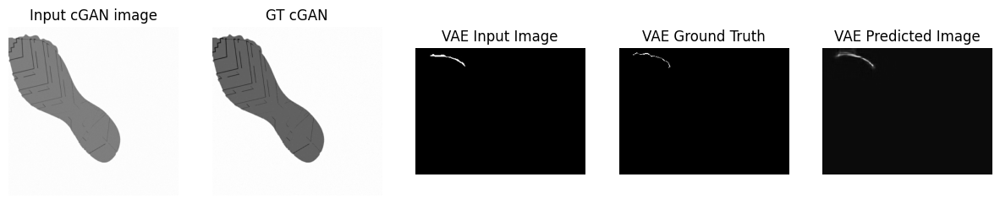

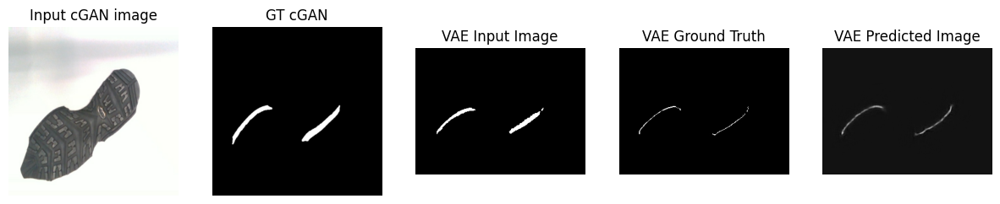

....................................................................................................Time taken for 1000 steps: 2294.60 sec

[Epochs-interval: 6/6]__Step: 113k/123k
Train set ELBO: -0.0013525137910619378


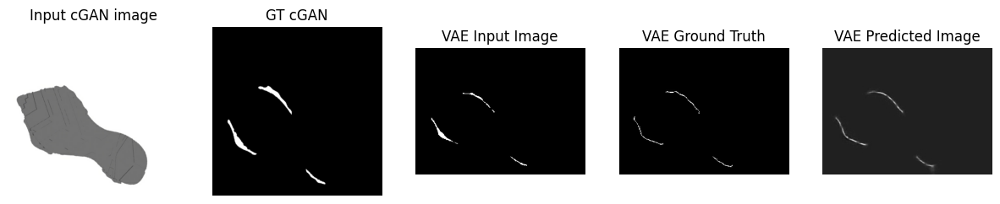

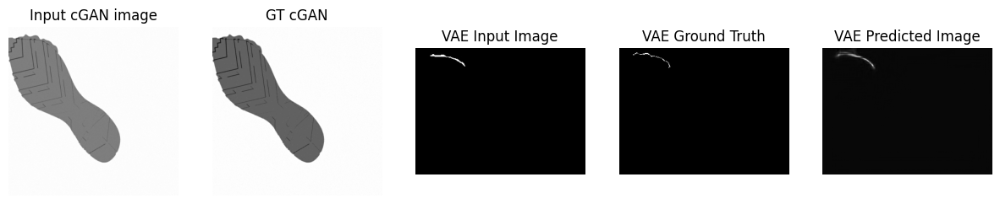

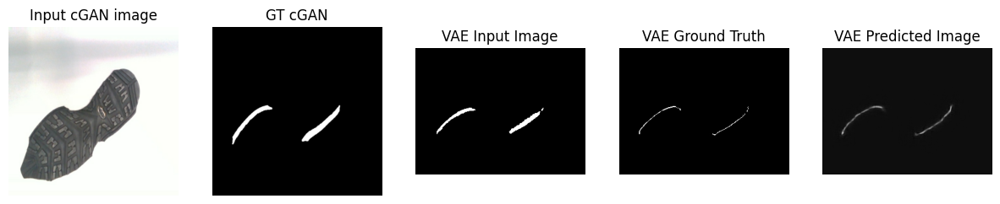

....................................................................................................Time taken for 1000 steps: 2315.28 sec

[Epochs-interval: 6/6]__Step: 114k/123k
Train set ELBO: -0.0013512751320376992


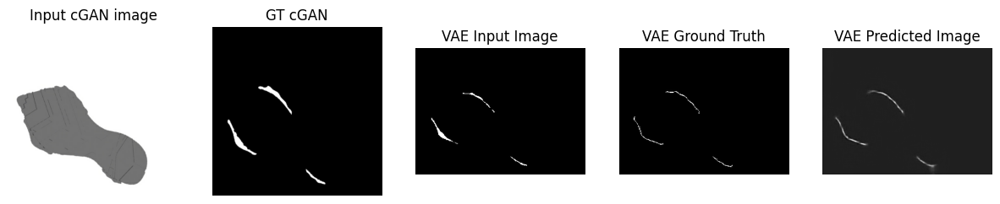

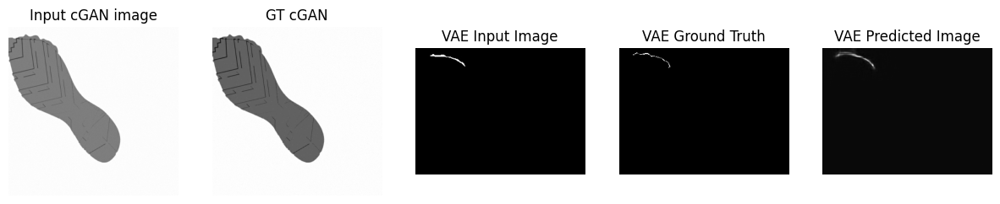

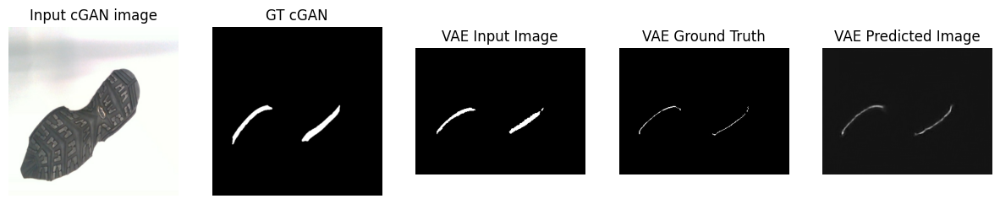

....................................................................................................Time taken for 1000 steps: 2336.06 sec

[Epochs-interval: 6/6]__Step: 115k/123k
Train set ELBO: -0.0013396264985203743


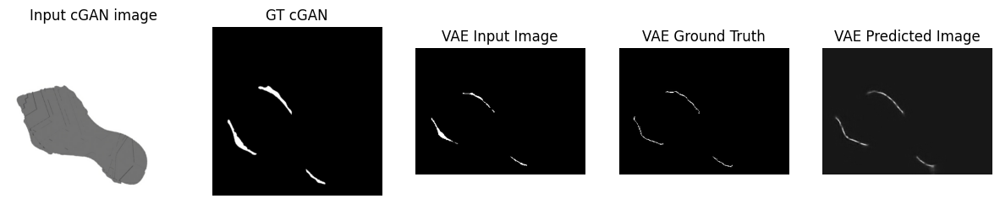

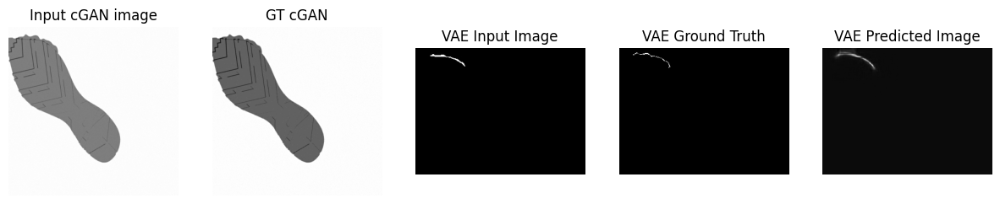

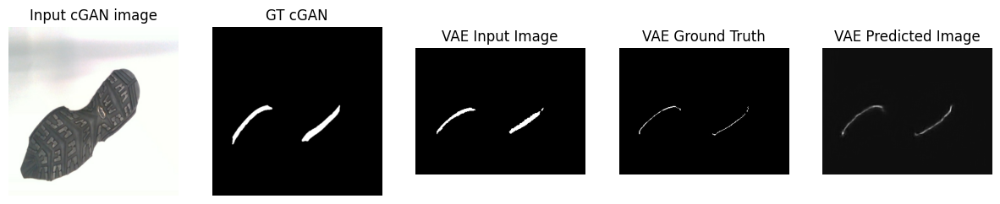

....................................................................................................Time taken for 1000 steps: 2356.78 sec

[Epochs-interval: 6/6]__Step: 116k/123k
Train set ELBO: -0.0013432538835331798


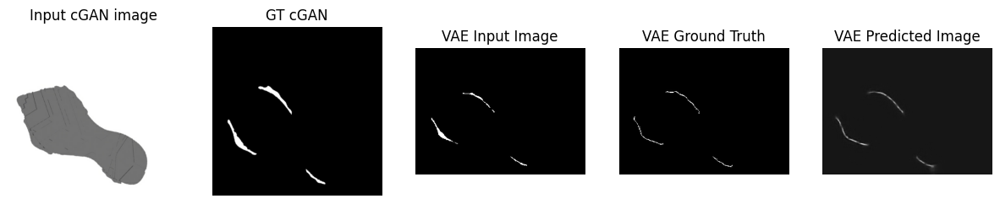

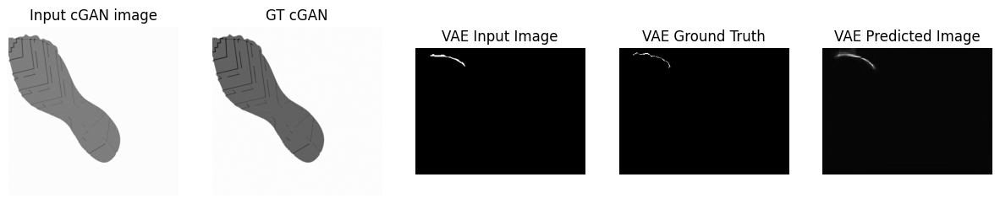

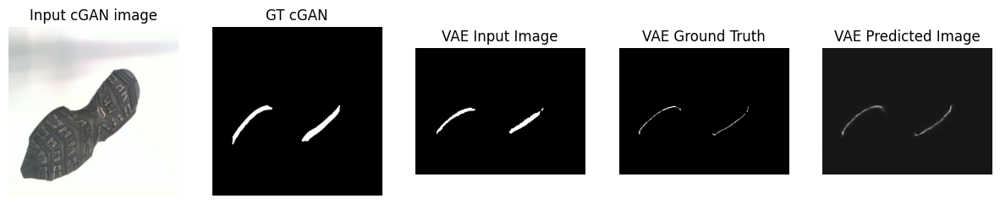

....................................................................................................Time taken for 1000 steps: 2378.18 sec

[Epochs-interval: 6/6]__Step: 117k/123k
Train set ELBO: -0.001331870909780264


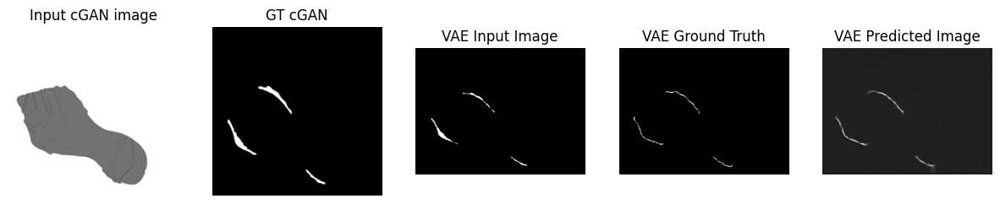

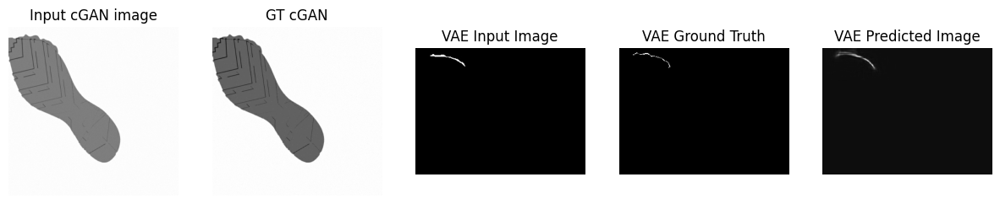

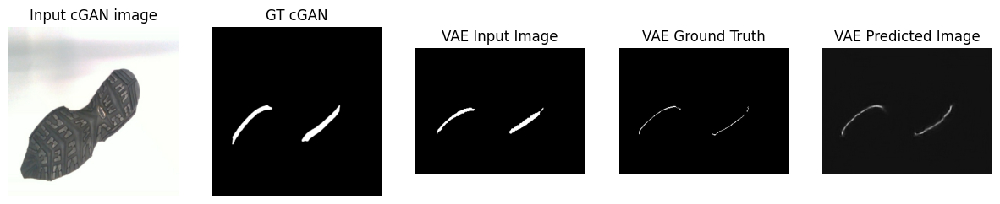

....................................................................................................Time taken for 1000 steps: 2399.34 sec

[Epochs-interval: 6/6]__Step: 118k/123k
Train set ELBO: -0.0013233748031780124


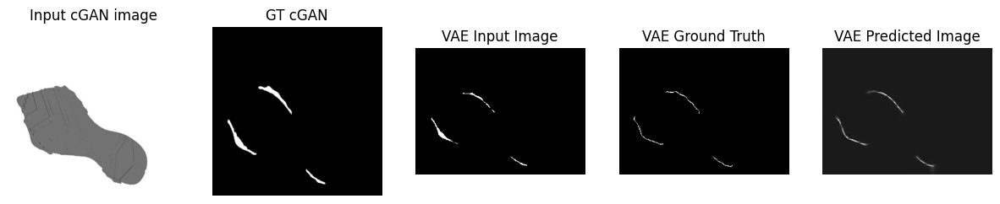

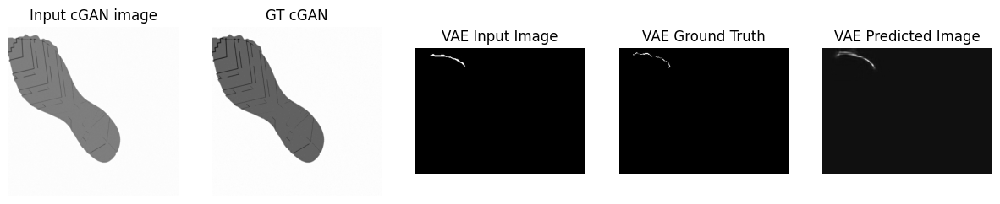

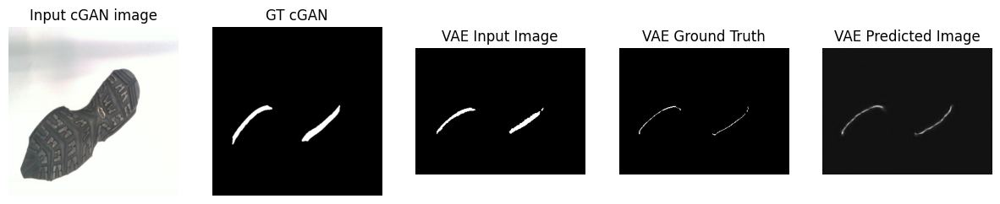

....................................................................................................Time taken for 1000 steps: 2420.03 sec

[Epochs-interval: 6/6]__Step: 119k/123k
Train set ELBO: -0.001318753114901483


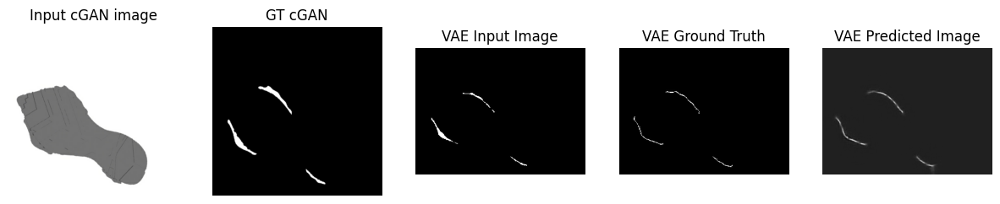

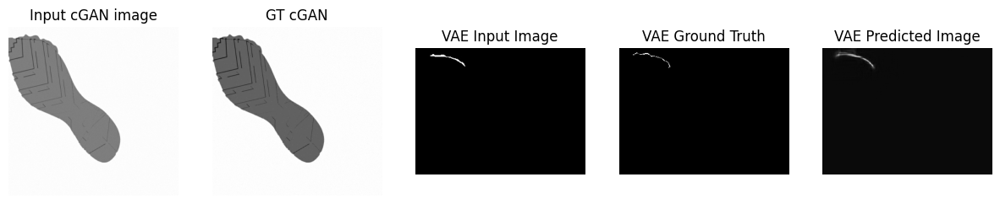

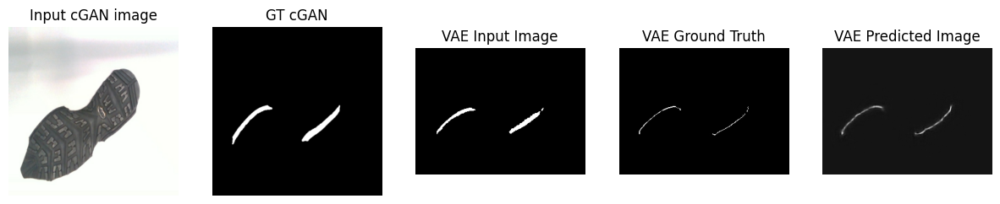

....................................................................................................Time taken for 1000 steps: 2441.03 sec

[Epochs-interval: 6/6]__Step: 120k/123k
Train set ELBO: -0.0013186536962166429


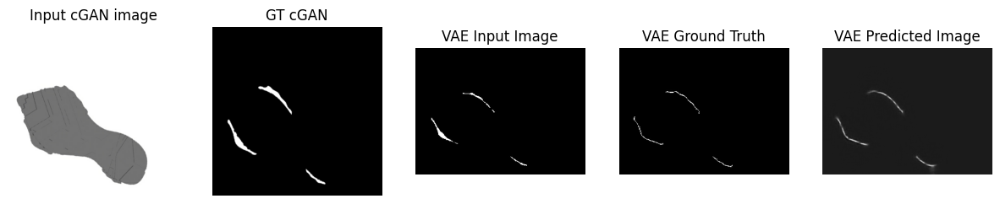

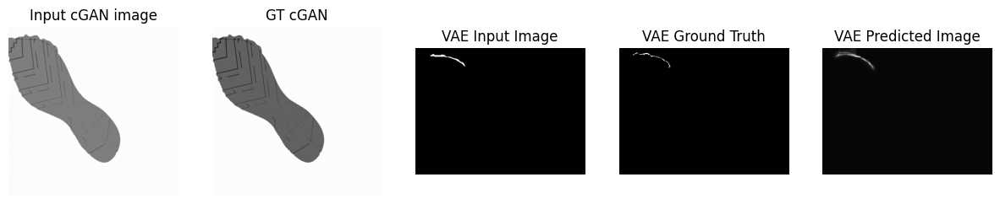

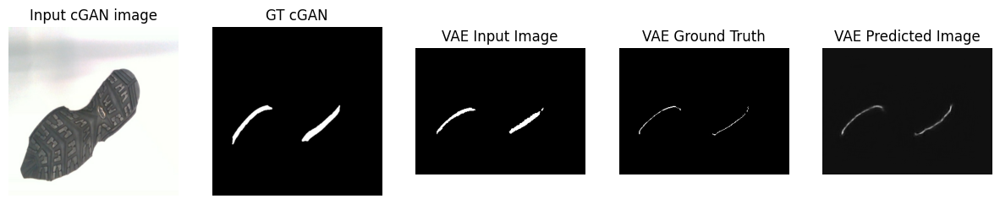

....................................................................................................Time taken for 1000 steps: 2462.40 sec

[Epochs-interval: 6/6]__Step: 121k/123k
Train set ELBO: -0.001313011278398335


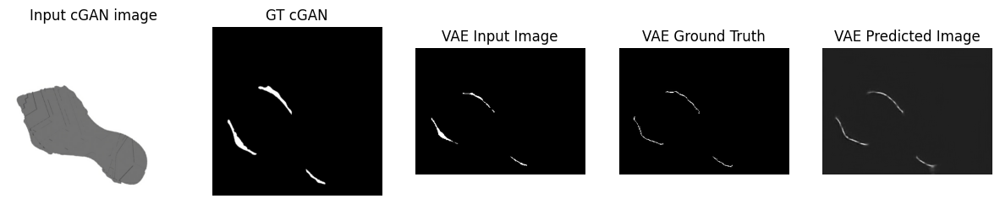

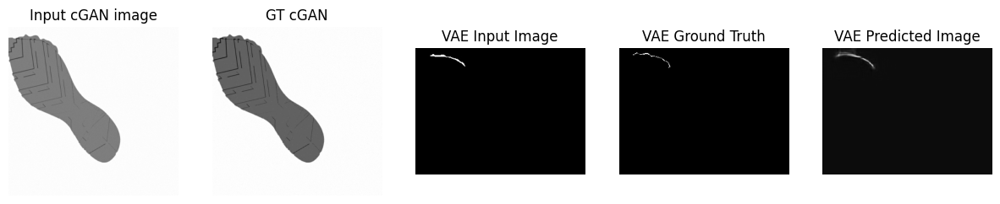

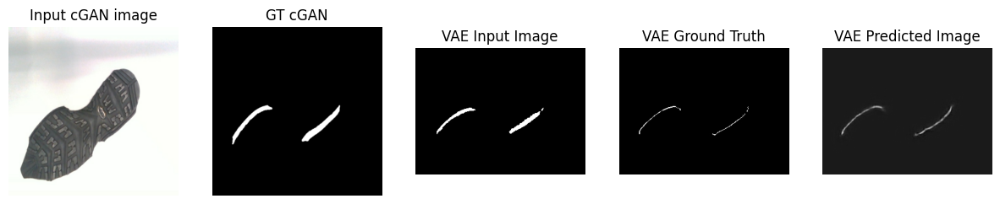

....................................................................................................Time taken for 1000 steps: 2483.16 sec

[Epochs-interval: 6/6]__Step: 122k/123k
Train set ELBO: -0.0013201495166867971


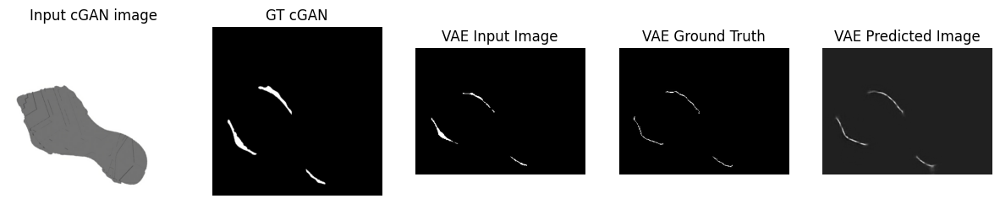

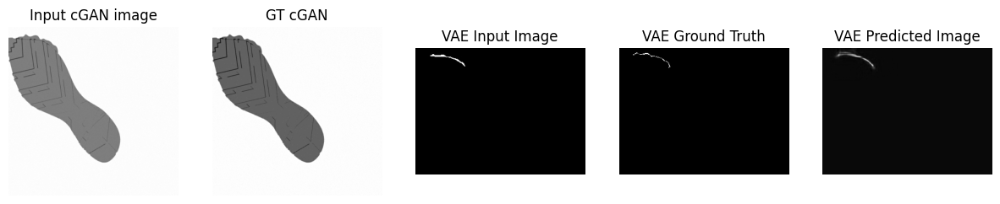

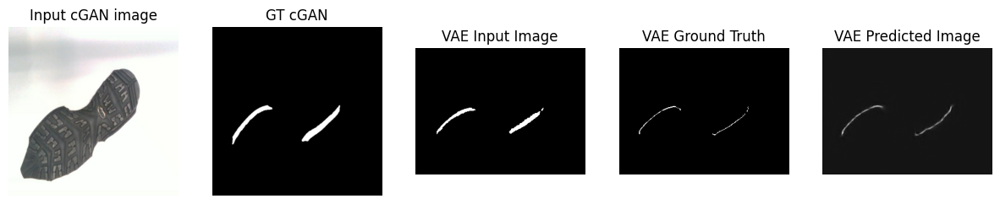

....................................................................................................

In [ ]:
# Call fit function for training the cvae

train_losses, val_losses, gazebo_losses, real_losses = fit(vae_train_dataset, vae_val_dataset, combined_test_sim, combined_test_sim_from_gazebo, combined_test_real, STEPS, epochs, checkpoint_dir, checkpoint_prefix)

# Save losses
save_list_to_pickle(train_losses, checkpoint_dir+"/loss_tot.pickle")
save_list_to_pickle(val_losses, checkpoint_dir+"/val_loss_tot.pickle")
save_list_to_pickle(gazebo_losses, checkpoint_dir+"/gazebo_loss_tot.pickle")
save_list_to_pickle(real_losses, checkpoint_dir+"/real_loss_tot.pickle")

# Save weights and optimizer's state
model.save_weights(checkpoint_prefix)

## Results analysis

### Load checkpoints

In [ ]:
# Restoring the latest checkpoint in checkpoint_dir
saved_path = 'drive/MyDrive/Colab_Notebooks/v8_extra/checkpoints_cae/ckpt_cae_flatten/ckpt_cvae_epoch6'
model.load_weights(saved_path)


### Plot train losses (can be plotted only after complete training)

In [ ]:
# load saved losses
train_losses = load_list_from_pickle(checkpoint_dir + "/loss_tot.pickle")
val_losses = load_list_from_pickle(checkpoint_dir + "/val_loss_tot.pickle")
gazebo_losses = load_list_from_pickle(checkpoint_dir + "/gazebo_loss_tot.pickle")
real_losses = load_list_from_pickle(checkpoint_dir + "/real_loss_tot.pickle")

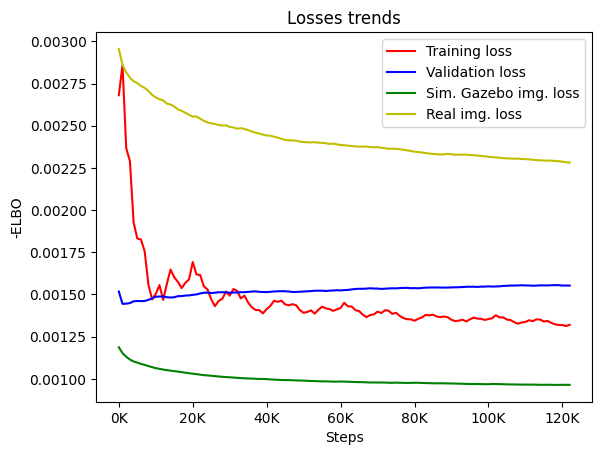

In [ ]:
# Plot losses
from matplotlib.ticker import FuncFormatter

epochs_steps = range(len((train_losses)))
# Create a figure and axis objects
fig, ax1 = plt.subplots()

# Plot original data on ax1
ax1.plot(epochs_steps, train_losses, 'r', label='Training loss')
ax1.plot(epochs_steps, val_losses, 'b', label='Validation loss')
ax1.plot(epochs_steps, gazebo_losses, 'g', label='Sim. Gazebo img. loss')
ax1.plot(epochs_steps, real_losses, 'y', label='Real img. loss')
ax1.set_xlabel('Steps')
ax1.set_ylabel('-ELBO')
ax1.set_title('Losses trends')
ax1.legend()


# Function to format tick labels with 'k'
def format_k(x, pos):
    return '%1.0fK' % (x)

# Apply the formatter to the x-axis of both ax1 and ax2
ax1.xaxis.set_major_formatter(FuncFormatter(format_k))


plt.show()


### Plot test losses

In [ ]:
def compute_losses_for_dataset(dataset, model):
    losses = []

    for input_image, target in dataset:
        loss_value = compute_loss(model, input_image, target)
        elbo = loss_value.numpy()
        losses.append(elbo)

    return losses

In [ ]:
def plot_losses(cae_sim_losses, cae_sim_gazebo_losses, cae_real_losses, title=None):
    # Find the length of the shortest list
    min_length = min(len(cae_sim_losses), len(cae_sim_gazebo_losses), len(cae_real_losses))



    # Calculate means
    mean_cae_sim_losses = sum(cae_sim_losses) / len(cae_sim_losses) if cae_sim_losses else 0
    mean_cae_sim_gazebo_losses = sum(cae_sim_gazebo_losses) / len(cae_sim_gazebo_losses) if cae_sim_gazebo_losses else 0
    mean_cae_real_losses = sum(cae_real_losses) / len(cae_real_losses) if cae_real_losses else 0

    steps = list(range(min_length))
    # Truncate lists to the length of the shortest list
    cae_sim_losses = cae_sim_losses[:min_length]
    cae_sim_gazebo_losses = cae_sim_gazebo_losses[:min_length]
    cae_real_losses = cae_real_losses[:min_length]


    # Plotting the losses
    plt.figure(figsize=(10, 6))

    if title:
        plt.title(title, fontsize=16)

    plt.plot(steps, cae_sim_losses, 'r', label='CAE Sim Losses')
    plt.plot(steps, cae_sim_gazebo_losses, 'g', label='CAE Sim Gazebo Losses')
    plt.plot(steps, cae_real_losses, 'b', label='CAE Real Losses')

    # Plot mean lines
    plt.axhline(y=mean_cae_sim_losses, color='r', linestyle='--', label='Mean CAE Sim Losses')
    plt.axhline(y=mean_cae_sim_gazebo_losses, color='g', linestyle='--', label='Mean CAE Sim Gazebo Losses')
    plt.axhline(y=mean_cae_real_losses, color='b', linestyle='--', label='Mean CAE Real Losses')

    # Annotate mean values
    plt.text(min_length + 1, mean_cae_sim_losses, f'{mean_cae_sim_losses:.4f}', ha='left', va='center', color='r')
    plt.text(min_length + 1, mean_cae_sim_gazebo_losses, f'{mean_cae_sim_gazebo_losses:.4f}', ha='left', va='center', color='g')
    plt.text(min_length + 1, mean_cae_real_losses, f'{mean_cae_real_losses:.4f}', ha='left', va='center', color='b')

    plt.xlabel('Step')
    plt.ylabel('Loss')
    plt.legend(loc='upper right')
    plt.grid(True)


    plt.show()

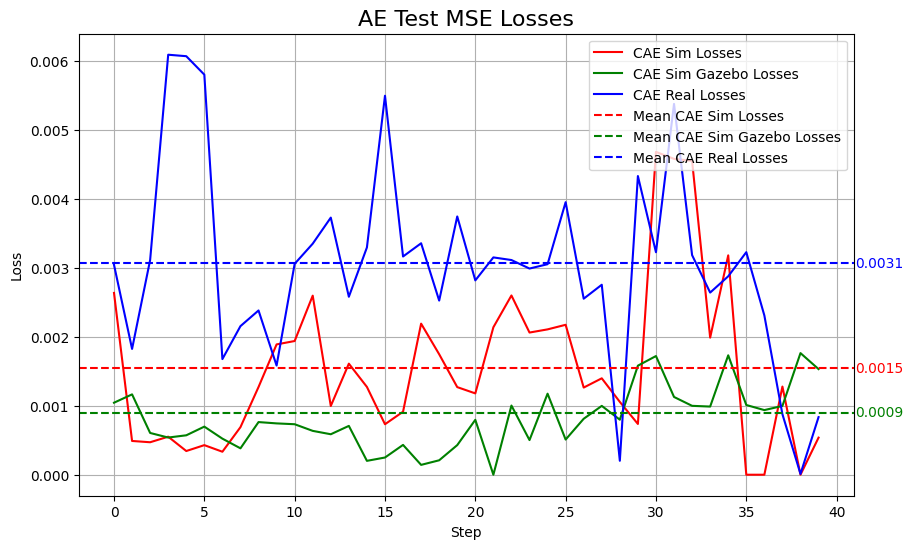

In [ ]:
cae_sim_losses = compute_losses_for_dataset(vae_test_dataset_sim, model)
cae_sim_gazebo_losses = compute_losses_for_dataset(vae_test_dataset_sim_from_gazebo, model)
cae_real_losses = compute_losses_for_dataset(vae_test_dataset_real, model)

plot_losses(cae_sim_losses, cae_sim_gazebo_losses, cae_real_losses, title="AE Test MSE Losses")

### Display some test results

Test the simulated (artificial images)

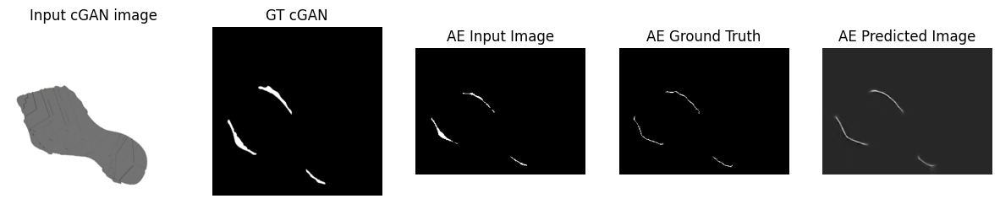

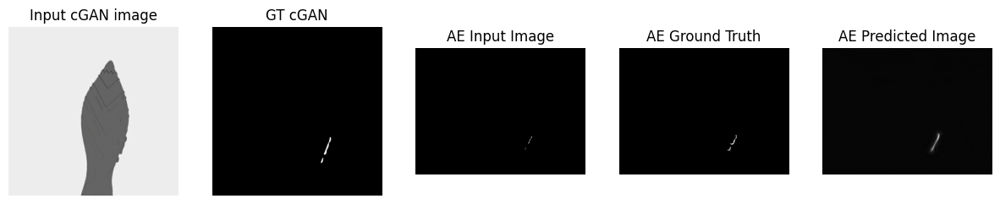

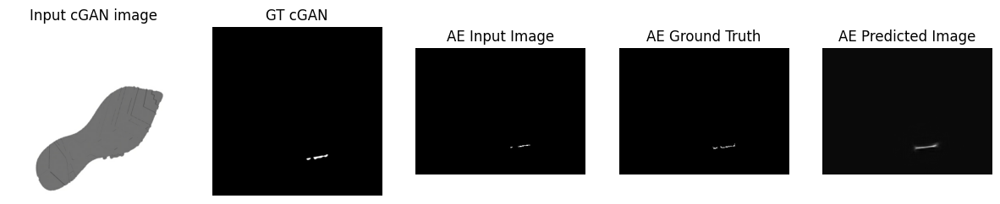

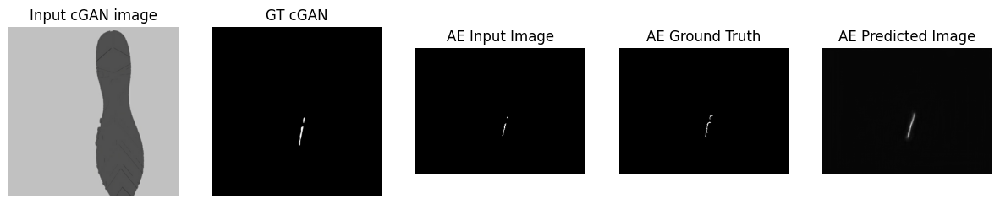

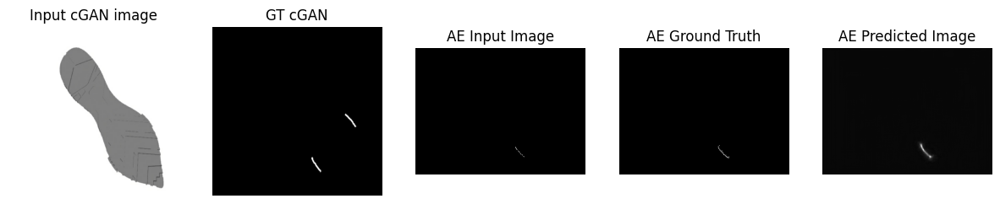

...

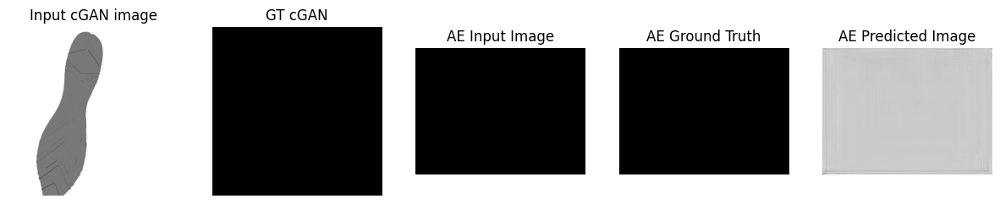

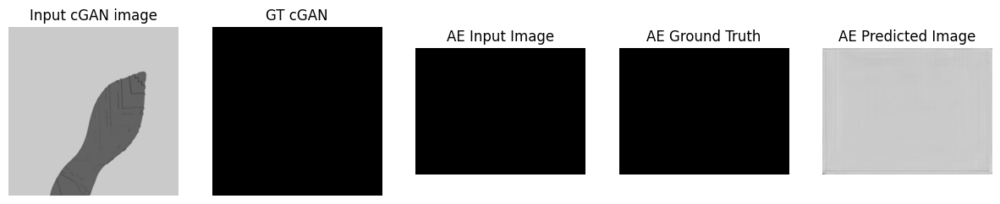

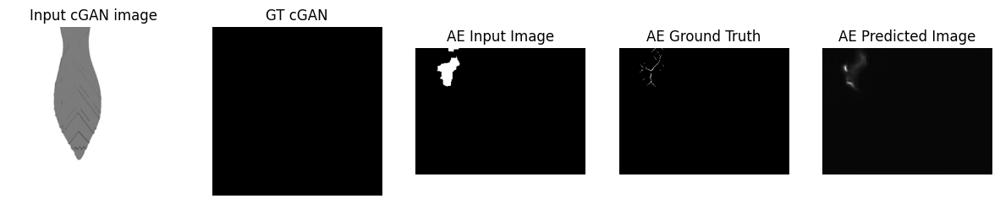

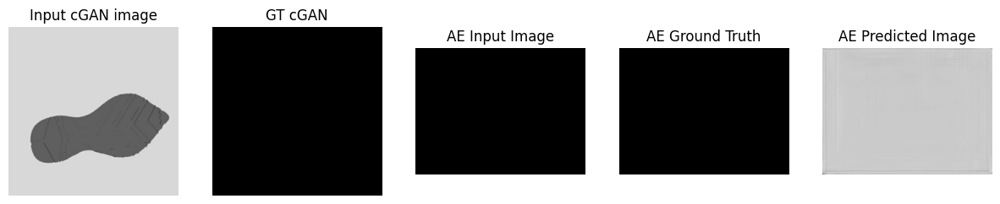

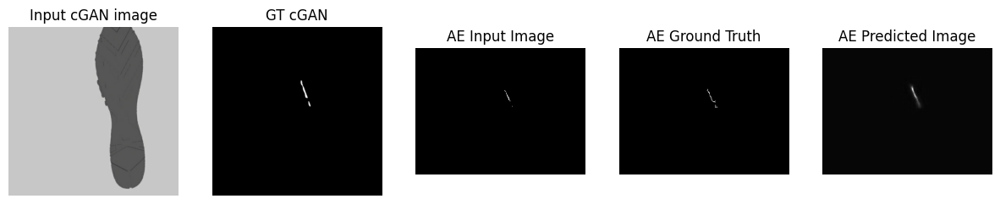

In [ ]:
# Plot test results
# Test the simulation (artificial) images
test_combined_ds = tf.data.Dataset.zip((cgan_test_dataset_sim, vae_test_dataset_sim))

for (data1, data2) in test_combined_ds:
  cgan_input_image, cgan_target = data1
  input_image, target = data2
  generate_images(model,cgan_input_image, cgan_target, input_image, target)

Test the simulated images taken directly from gazebo

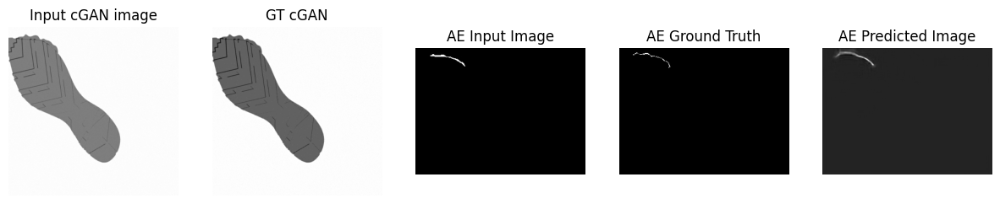

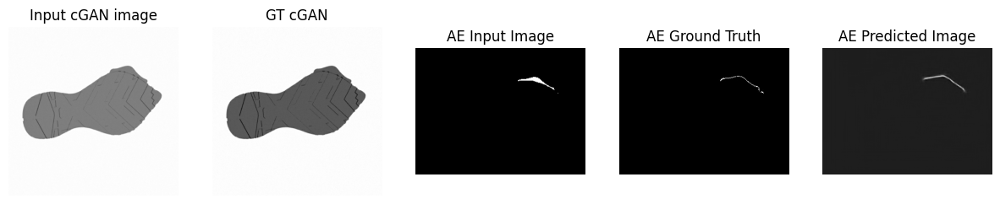

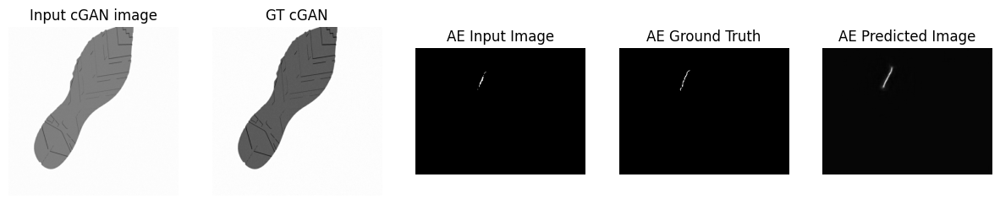

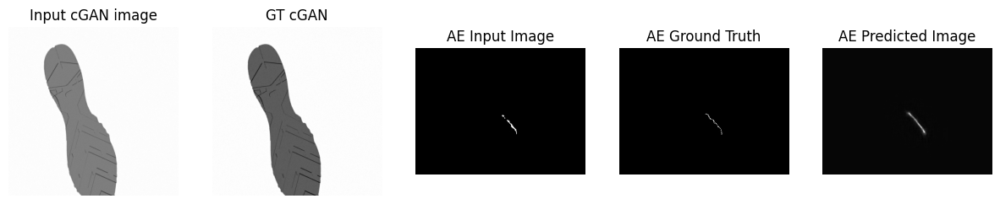

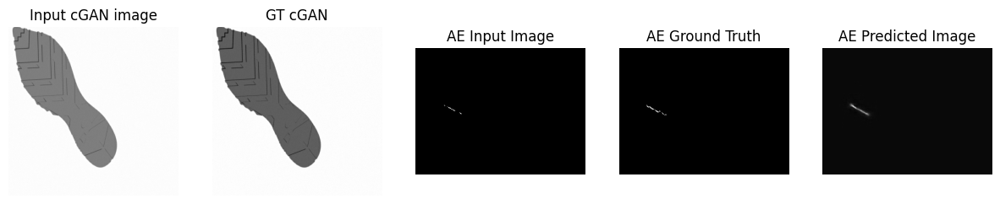

...

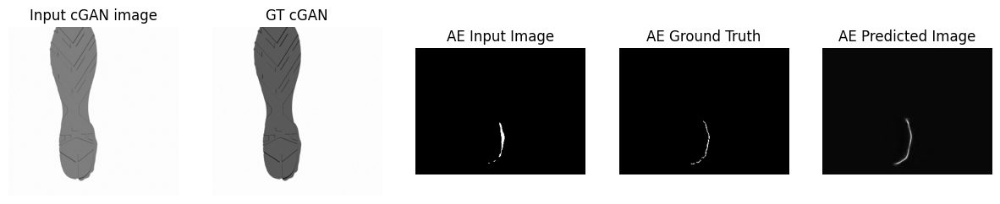

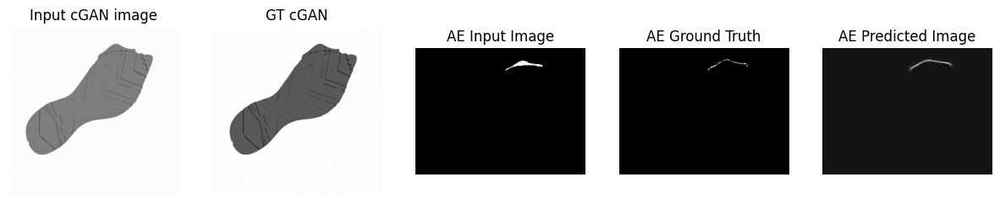

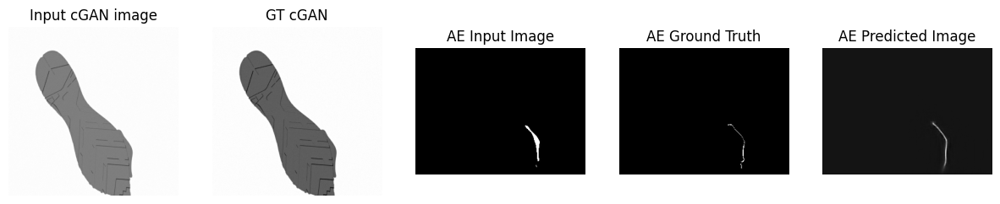

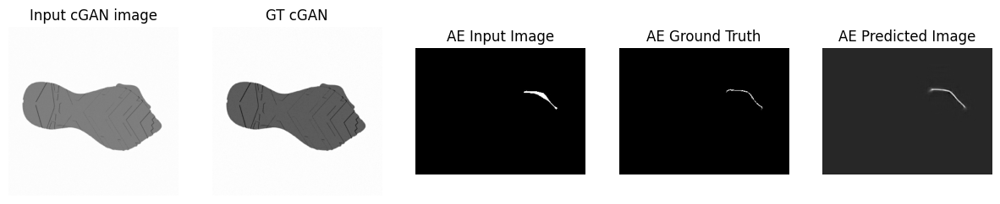

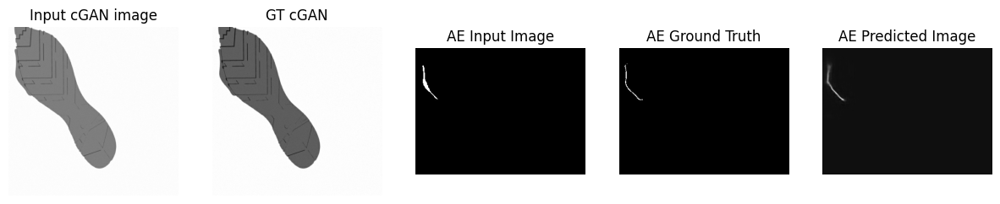

In [ ]:

test_combined_ds = tf.data.Dataset.zip((cgan_test_dataset_sim_from_gazebo, vae_test_dataset_sim_from_gazebo))

for (data1, data2) in test_combined_ds:
  cgan_input_image, cgan_target = data1
  input_image, target = data2
  generate_images(model,cgan_input_image, cgan_target, input_image, target)

Test the real images

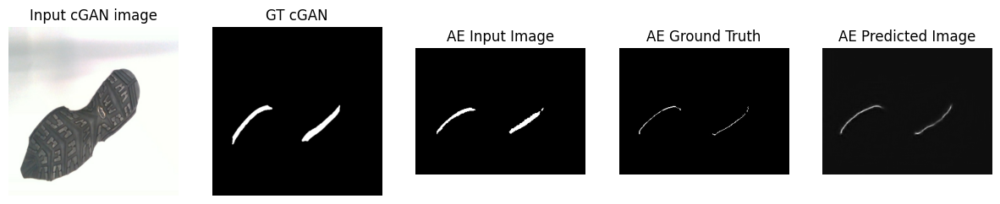

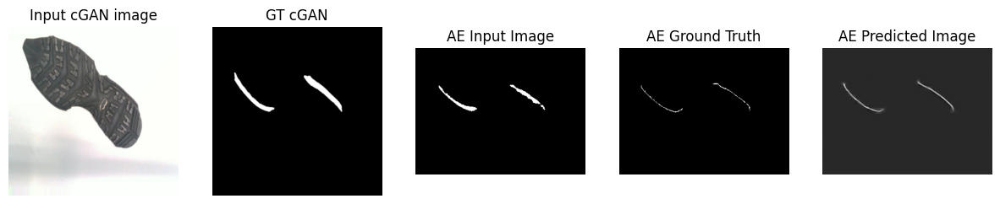

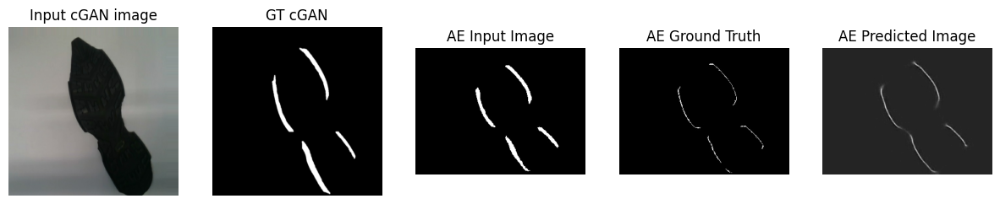

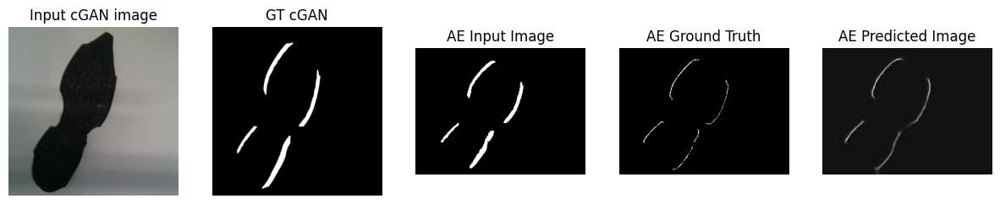

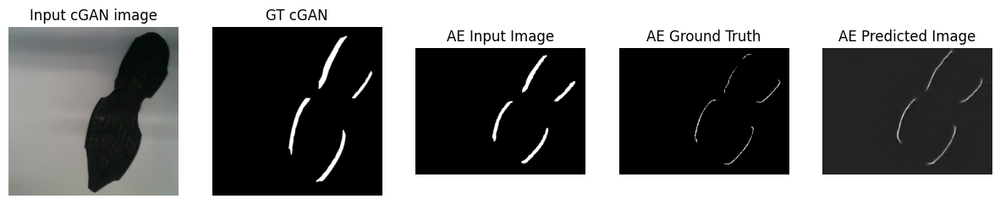

...

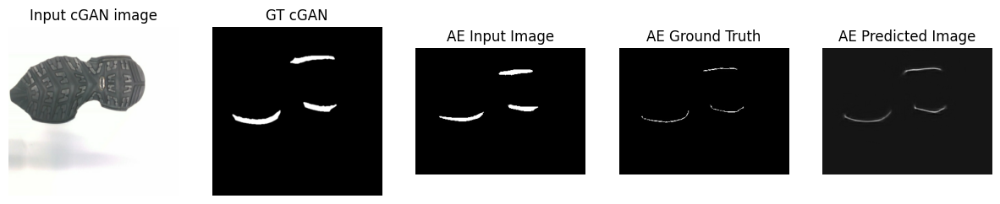

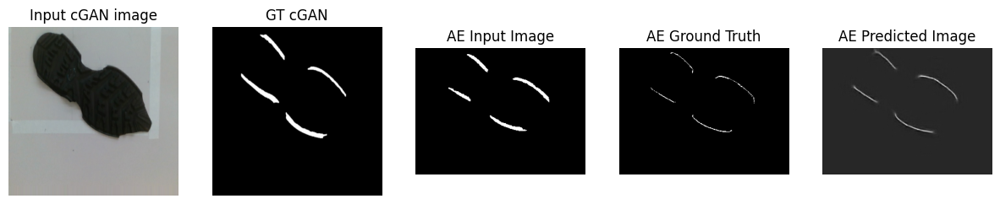

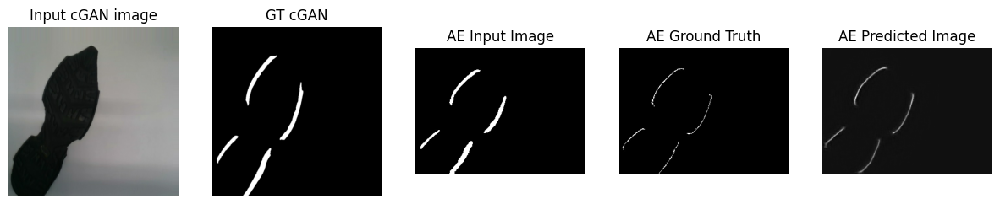

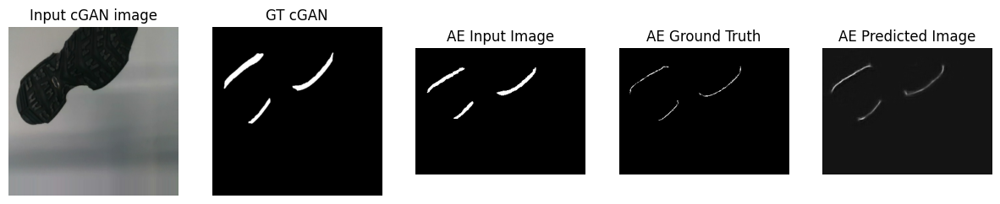

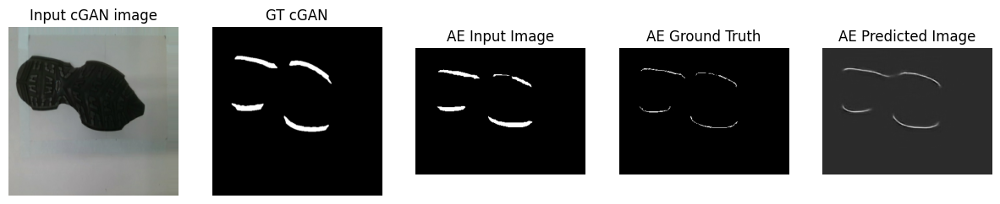

In [ ]:
# Test the real images
test_combined_ds = tf.data.Dataset.zip((cgan_test_dataset_real, vae_test_dataset_real))

for (data1, data2) in test_combined_ds:
  cgan_input_image, cgan_target = data1
  input_image, target = data2
  generate_images(model,cgan_input_image, cgan_target, input_image, target)

# Latent space Analysis
In this case is not really used since the latent space is relatively big (300x1), so it cannot be reduced that much with reduction methods like pca, so the reduced dimension vector are still big and not really informative

In [ ]:
dataset_latent_space = vae_train_dataset #tf.data.Dataset.concatenate(vae_val_dataset, vae_train_dataset_real) #1000 images(500 sim,500 real)
collect_l_vectors = False # (False you load them from previously saved latent_vectors)

### Visualization, encoding and decoding functions

In [ ]:
def collect_latent_vectors(model, dataset):
    latent_vectors = []
    for it, (input_image, _) in dataset.enumerate():
        # Predict latent vector using the model
        latent_vector = model.encode(input_image)
        # Append the predicted latent vector
        latent_vectors.append(latent_vector)
        if it % 1000 == 0 and it!=0:
          print(f"Collected vectors:{it//1000}k")
    # Convert to numpy array
    latent_vectors = np.array(latent_vectors)
    return latent_vectors

In [ ]:
!pip install umap-learn
import umap

def use_pca(n_reduce_comp, latent_vectors=None, latent_reduced=None, pca=None, direction='forward'):
    if direction == 'forward':
        # Apply PCA for dimensionality reduction
        pca = PCA(n_components=n_reduce_comp)
        latent_reduced = pca.fit_transform(latent_vectors)
        return pca, latent_reduced
    elif direction == 'inverse':
        # Apply inverse transformation to restore orginal latent vector dimension
        reconstructed_latent_vector = pca.inverse_transform(latent_reduced)
        return reconstructed_latent_vector

def use_umap(n_reduce_comp,  latent_vectors=None, latent_reduced=None, umap_model=None, direction='forward', n_neighbors=15):
    if direction == 'forward':
        # Apply umap for dimensionality reduction
        umap_model = umap.UMAP(n_components=n_reduce_comp)
        latent_reduced = umap_model.fit_transform(latent_vectors)
        return umap_model, latent_reduced
    elif direction == 'inverse':
        # Apply inverse transformation to restore orginal latent vector dimension
        reconstructed_latent_vector = umap_model.inverse_transform(latent_reduced)
        # Add some noise to avoid singular matrix
        reconstructed_latent_vector += np.random.normal(0, 0.1, size=reconstructed_latent_vector.shape)
        return reconstructed_latent_vector


def plot_latent_space(latent_vectors, n_blocks, n_reduce_comp, method='pca'):

    if method == 'pca':
        red_model, latent_reduced = use_pca(n_reduce_comp, latent_vectors=latent_vectors)
    if method == 'umap':
        red_model, latent_reduced = use_umap(n_reduce_comp, latent_vectors=latent_vectors)
    block_boundaries = []
    if latent_reduced.shape[1] == 2:
        latent_2d = latent_reduced
        # Plot the 2D representation of the latent space
        plt.scatter(latent_2d[:, 0], latent_2d[:, 1])
        plt.title('2D Visualization of Latent Space')
        plt.xlabel('Dimension 1')
        plt.ylabel('Dimension 2')
        plt.gca().set_aspect('equal', adjustable='box')

        # Get boundaries of each block
        x_min, x_max = latent_2d[:, 0].min(), latent_2d[:, 0].max()
        y_min, y_max = latent_2d[:, 1].min(), latent_2d[:, 1].max()

        x_step = (x_max - x_min) / np.sqrt(n_blocks)
        y_step = (y_max - y_min) / np.sqrt(n_blocks)


        for i in range(int(np.sqrt(n_blocks))):
            for j in range(int(np.sqrt(n_blocks))):
                block_boundaries.append((x_min + i * x_step, x_min + (i+1) * x_step,
                                        y_min + j * y_step, y_min + (j+1) * y_step))
                plt.axvline(x=x_min + (i+1) * x_step, color='r', linestyle='--', linewidth=0.5)
                plt.axhline(y=y_min + (j+1) * y_step, color='r', linestyle='--', linewidth=0.5)
        plt.tight_layout()
        plt.show()
    else:
        # Plot each dimension of the reduced latent space separately
        fig, axs = plt.subplots(n_reduce_comp, 1, figsize=(10, 2 * n_reduce_comp))
        for i in range(n_reduce_comp):
            axs[i].plot(latent_reduced[:, i], label=f'Dimension {i+1}')
            axs[i].set_title(f'Dimension {i+1} Spectrum')
            axs[i].set_xlabel('Samples')
            axs[i].set_ylabel('Value')
            axs[i].legend()
        plt.tight_layout()
        plt.show()

    return red_model, block_boundaries, latent_reduced

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 6.3 MB/s eta 0:00:00


In [ ]:
# For 2d case, generate the decoded images for random points taken in each block area of the latent
def generate_gif_for_block(red_model, model, block_boundaries, saving_path, n_frames=10, frame_duration=1000, method='pca'):
    n_reduce_comp = 2 # 2d reduction case
    # Extract block boundaries
    x_min, x_max, y_min, y_max = block_boundaries

    # Generate random 2D points within the block
    random_points = []
    for _ in range(n_frames):
        x = np.random.uniform(x_min, x_max)
        y = np.random.uniform(y_min, y_max)
        random_points.append([x, y])
    random_points = np.array(random_points)

    # Create frames for the animation
    frames = []
    fig, ax = plt.subplots()
    for point in random_points:
        # Perform inverse transformation from reduced to original latent space
        if method == 'pca':
            reconstructed_latent_vector = use_pca(n_reduce_comp, latent_reduced=point.reshape(1, -1), pca=red_model, direction='inverse')
        if method == 'umap':
            reconstructed_latent_vector = use_umap(n_reduce_comp, latent_reduced=point.reshape(1, -1), umap_model=red_model, direction='inverse')

        #reconstructed_latent_vector = reconstructed_latent_vector.reshape(1, reconstructed_latent_vector.shape[0])

        # Decode the reconstructed latent vector into an image
        decoded_image = model.decode(reconstructed_latent_vector)

        # Ensure the decoded image has the correct shape and data type
        decoded_image = decoded_image.numpy()[0] # Convert to numpy array and remove single-dimensional entries

        # Display the decoded image
        ax.imshow(decoded_image, cmap='gray')
        ax.axis('off')

        # Save the current frame as a PIL image
        fig.canvas.draw()
        frame = np.array(fig.canvas.renderer.buffer_rgba())
        frame = Image.fromarray(frame)
        frames.append(frame)
    # Close the figure to prevent it from being displayed later
    plt.close(fig)
    # Save frames as GIF
    frames[0].save(saving_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)
    return random_points

# for pca with num_components >2
def generate_gif_for_spectrum(red_model, model, latent_red, num_components, saving_path, n_frames=10, frame_duration=1000, method='pca'):
    num_samples, total_num_components = latent_red.shape
    mean_values = np.mean(latent_red, axis=0)
    frame_points_dims = []

    for dimension in range(num_components):
        dim_rnd_points = []
        frames = []
        fig, ax = plt.subplots()

        # Generate random values for the current dimension
        min_val = np.min(latent_red[:, dimension])
        max_val = np.max(latent_red[:, dimension])

        for _ in range(n_frames):
            rand_value = np.random.uniform(min_val, max_val)
            dim_rnd_points.append(rand_value)
            frame_latent_red = mean_values.copy()
            frame_latent_red[dimension] = rand_value

            # Invert frame_latent_red to original latent dimension (frame_latent)
            if method == 'pca':
                frame_latent = use_pca(num_components, latent_reduced=frame_latent_red.reshape(1, -1), pca=red_model, direction='inverse')
            if method == 'umap':
                frame_latent = use_umap(num_components, latent_reduced=frame_latent_red.reshape(1, -1), umap_model=red_model, direction='inverse')


            # Decode frame_latent to image
            decoded_image = model.decode(frame_latent)

            # Ensure the decoded image has the correct shape and data type
            decoded_image = decoded_image.numpy()[0]

            # Display the decoded image
            ax.imshow(decoded_image, cmap='gray')
            ax.axis('off')

            # Save the current frame as a PIL image
            fig.canvas.draw()
            frame = np.array(fig.canvas.renderer.buffer_rgba())
            frame = Image.fromarray(frame)
            frames.append(frame)
        # Close the figure to prevent it from being displayed later
        plt.close(fig)
        gif_path = f"{saving_path}_dim_{dimension}.gif"
        # Save frames as GIF
        frames[0].save(gif_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)

        # Save the random values for this dimension
        frame_points_dims.append(dim_rnd_points)

    return frame_points_dims

In [ ]:
# for 2d case
def generate_latent_space_gif(latent_2d, random_points_blocks, saving_path, n_blocks, n_frames=10, frame_duration=1000):
    # Get boundaries of the latent space plot
    x_min, x_max = latent_2d[:, 0].min(), latent_2d[:, 0].max()
    y_min, y_max = latent_2d[:, 1].min(), latent_2d[:, 1].max()

    # Calculate the step size for each block
    x_step = (x_max - x_min) / np.sqrt(n_blocks)
    y_step = (y_max - y_min) / np.sqrt(n_blocks)

    # Create frames for the animation
    frames = []
    fig, ax = plt.subplots()
    for frame_index in range(n_frames):
        ax.clear()  # Clear the axis before plotting for each frame

        # Plot the latent space
        ax.scatter(latent_2d[:, 0], latent_2d[:, 1])

        # Add block boundaries and block numbers
        for i in range(int(np.sqrt(n_blocks))):
            for j in range(int(np.sqrt(n_blocks))):
                ax.axvline(x=x_min + (i+1) * x_step, color='r', linestyle='--', linewidth=0.5)
                ax.axhline(y=y_min + (j+1) * y_step, color='r', linestyle='--', linewidth=0.5)
                text_x = x_min + i * x_step + 0.02 * (x_max - x_min)  # Adjusting the x position
                text_y = y_min + (j+1) * y_step - 0.03 * (y_max - y_min)  # Adjusting the y position
                ax.text(text_x, text_y, f'Block {i * int(np.sqrt(n_blocks)) + j + 1}', fontsize=6)
               # Plot random points for each block for the current frame
        for block_index, random_points in enumerate(random_points_blocks):
            for point_index, (x, y) in enumerate(random_points):
                if point_index == frame_index:  # Only plot points for the current frame
                    ax.scatter(x, y, color='red')

        ax.set_title('2D Visualization of Latent Space')
        ax.set_xlabel('Dimension 1')
        ax.set_ylabel('Dimension 2')
        ax.set_aspect('equal', adjustable='box')
        ax.autoscale(True)

        # Save the current frame as a PIL image
        fig.canvas.draw()
        frame = np.array(fig.canvas.renderer.buffer_rgba())
        frame = Image.fromarray(frame)
        frames.append(frame)
    # Close the figure to prevent it from being displayed later
    plt.close(fig)
    # Save frames as GIF
    frames[0].save(saving_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)

#for pca with more than 2 components
def generate_gif_for_dimensions(latent_reduced, frame_points_dims, saving_path, num_components, num_frames=10, frame_duration=1000):
    for dimension in range(num_components):
        fig, ax = plt.subplots()
        frames = []
        for frame_index in range(num_frames):
            ax.clear()  # Clear the axis before plotting for each frame
            # Plot the original spectrum
            ax.plot(latent_reduced[:, dimension], color='blue', label='Original Spectrum')

            # Plot the changing values on top of the original spectrum
            changing_values = np.full_like(latent_reduced[:, dimension], frame_points_dims[dimension][frame_index])
            ax.scatter(np.arange(len(latent_reduced)), changing_values, color='red', label='Changing Value')

            # Set the title and subtitle as the plot title
            ax.set_title(f'Dimension {dimension + 1}\nFixed mean spectra values for the other latent dimensions')


            ax.set_xlabel('Samples')
            ax.set_ylabel('Value')
            ax.legend()

            # Save the current frame as a PIL image
            fig.canvas.draw()
            frame = np.array(fig.canvas.renderer.buffer_rgba())
            frame = Image.fromarray(frame)
            frames.append(frame)

        # Close the figure to prevent it from being displayed later
        plt.close(fig)

        # Save frames as GIF
        gif_path = f"{saving_path}_dim_{dimension}.gif"
        frames[0].save(gif_path, save_all=True, append_images=frames[1:], loop=0, duration=frame_duration)


In [ ]:
# for 2d components
def display_latent_space_and_block_gifs(latent_space_gif_path, block_gif_paths, n_blocks):
    # Calculate number of rows and columns for the grid
    rows = int(np.ceil(np.sqrt(n_blocks)))
    cols = int(np.ceil(n_blocks / rows))

    # Create HTML content for the latent space GIF and grid of block GIFs
    html_content = f'<div style="display: flex;">'

    # Latent space GIF
    with open(latent_space_gif_path, "rb") as f:
        latent_space_gif_data = base64.b64encode(f.read()).decode("utf-8")
    html_content += f'<div style="margin-right: 20px;"><img src="data:image/gif;base64,{latent_space_gif_data}"></div>'

    # Grid of block GIFs
    html_content += '<div>'
    html_content += '<table style="border-collapse: collapse;">'
    for row in range(rows):
        html_content += '<tr>'
        for col in range(cols):
            block_index = col * rows + (rows - row)
            if block_index <= n_blocks:
                gif_index = block_index - 1
                with open(block_gif_paths[gif_index], "rb") as f:
                    gif_data = base64.b64encode(f.read()).decode("utf-8")
                html_content += f'<td style="border: 1px solid black; text-align: center;">Block {block_index}<br><img src="data:image/gif;base64,{gif_data}" width="200" height="200"></td>'
        html_content += '</tr>'
    html_content += '</table>'
    html_content += '</div>'

    # Close the flex container
    html_content += '</div>'

    # Display the HTML content
    display(HTML(html_content))

# for pca num_components>2
def display_latent_space_and_decoded_gifs(latent_gif_path, decoded_gif_path,  num_components):
    # Create HTML content for the latent space GIFs and decoded GIFs
    html_content = ''

    for i in range(num_components):
        latent_path = f"{latent_gif_path}_dim_{i}.gif"
        decoded_path = f"{decoded_gif_path}_dim_{i}.gif"

        # Latent space GIF
        with open(latent_path, "rb") as f_latent:
            latent_gif_data = base64.b64encode(f_latent.read()).decode("utf-8")

        # Decoded GIF
        with open(decoded_path, "rb") as f_decoded:
            decoded_gif_data = base64.b64encode(f_decoded.read()).decode("utf-8")

        # Construct HTML for the current dimension
        html_content += f'<div style="display: flex; margin-bottom: 20px;">'
        html_content += f'<div style="margin-right: 20px;"><img src="data:image/gif;base64,{latent_gif_data}"></div>'
        html_content += f'<div><img src="data:image/gif;base64,{decoded_gif_data}"></div>'
        html_content += f'</div>'

    # Display the HTML content
    display(HTML(html_content))

In [ ]:
# to check the performance and original reconstruction capability of the pca
def check_reduction(latent_vectors, latent_red, red_model, model, method='pca'):
    # Select a latent vector randomly
    random_index = np.random.randint(len(latent_vectors))
    latent_vector = latent_vectors[random_index]

    # Decode image directly from the selected latent vector
    decoded_direct = model.decode(latent_vector.reshape(1, -1)).numpy()[0]

    # Perform reduction and inverse transform
    latent_red_vec = latent_red[random_index]
    num_red_comp = len(latent_red_vec)
    print('Length of latent_vector before reduction:', len(latent_vector))
    print('Length of latent_vector after reduction:', num_red_comp )

    # Invert reduced latent vector to original latent dimension
    if method == 'pca':
        reconstructed_latent_vector = use_pca(num_red_comp, latent_reduced=latent_red_vec.reshape(1, -1), pca=red_model, direction='inverse')
    if method == 'umap':
        reconstructed_latent_vector = use_umap(num_red_comp, latent_reduced=latent_red_vec.reshape(1, -1), umap_model=red_model, direction='inverse')


    # Decode image from the reconstructed latent vector
    decoded_from_inv_t = model.decode(reconstructed_latent_vector).numpy()[0]

    # Plot images side by side
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(decoded_direct, cmap='gray')
    axes[0].set_title('Decoded Directly from Latent Vector')
    axes[0].axis('off')
    axes[1].imshow(decoded_from_inv_t, cmap='gray')
    axes[1].set_title('Decoded from reduced-transformed Latent Vector')
    axes[1].axis('off')
    plt.show()


Interactive sliders for pca with num_components>2

In [ ]:
def generate_decoded_image(latent_reduced, red_model, model, values, output_widget, method='pca'):

    #print("Values:", values)
    # Create a latent vector using the provided values
    latent_vector = np.array(values)
    # Invert reduced latent vector to original latent dimension
    if method == 'pca':
        reconstructed_latent_vector = use_pca(len(latent_vector), latent_reduced=latent_vector.reshape(1, -1), pca=red_model, direction='inverse')
    if method == 'umap':
        reconstructed_latent_vector = use_umap(len(latent_vector), latent_reduced=latent_vector.reshape(1, -1), umap_model=red_model, direction='inverse')

    # Decode the reconstructed latent vector into an image
    decoded_image = model.decode(reconstructed_latent_vector)

    # Ensure the decoded image has the correct shape and data type
    decoded_image = decoded_image.numpy()[0]

    # Display the decoded image
    with output_widget:
        clear_output(wait=True)
        plt.imshow(decoded_image, cmap='gray')
        plt.axis('off')
        plt.show()

def generate_slider_for_dimension(latent_reduced, red_model, model, num_components, method='pca'):
    # Create initial values for the latent vector (mean values for other dimensions)
    initial_values = [np.mean(latent_reduced[:, d]) for d in range(num_components)]

    # Create a slider widget for each dimension
    sliders = []
    for i in range(num_components):
        slider = widgets.FloatSlider(
            value=initial_values[i],
            min=np.min(latent_reduced[:, i]),
            max=np.max(latent_reduced[:, i]),
            description=f'Dimension {i+1}:',
            continuous_update=True,
            orientation='horizontal'  # Change orientation to horizontal
        )
        sliders.append(slider)

    # Create a box layout to arrange the sliders vertically
    sliders_layout = widgets.VBox(sliders, layout=widgets.Layout(
        display='flex',
        flex_flow='column',
        align_items='stretch',
        width='auto'
    ))

    # Create an output widget to display the decoded image
    output_widget = widgets.Output()

    # Define function to update decoded image based on slider values
    def update_image(*args):
        values = [slider.value for slider in sliders]
        generate_decoded_image(latent_reduced, red_model, model, values, output_widget, method=method)

    # Link sliders to update function
    for slider in sliders:
        slider.observe(update_image, names='value')

    # Display sliders vertically stacked on the left and the image on the right
    display(widgets.HBox([sliders_layout, output_widget], layout=widgets.Layout(
        display='flex',
        flex_flow='row',
        align_items='stretch',
        width='auto'
    )))


### Latent space visualization

In [ ]:
# Collect latent vectors from the dataset (the larger the datset the slower the collection process)
if collect_l_vectors:
  latent_vectors = collect_latent_vectors(model, dataset_latent_space)
  latent_vectors = latent_vectors.reshape(latent_vectors.shape[0], -1)
  save_list_to_pickle(latent_vectors, checkpoint_dir+"/latent_vector_ds.pickle")
else:
  latent_vectors = load_list_from_pickle(checkpoint_dir + "/latent_vector_ds.pickle")

print('Collected latent_vector shape: ', latent_vectors.shape)

Collected latent_vector shape:  (20500, 300)


### Apply reduction method to reduce latent vector dimension

In [ ]:
# Plot latent space and get block boundaries
METHOD='pca' # reduction method (pca, umap) [PCA is faster and better, umap is suggested for a small numebr of components]
n_blocks=25 # divide the plot in n_blocks area for later 2D visualization (only if num_components=2)
n_reduce_comp = 50 # dimension of the reduced latent vectors
red_model, block_boundaries, latent_red = plot_latent_space(latent_vectors, n_blocks, n_reduce_comp, method=METHOD)



Check how the reduced representation affected the latent encoding

Length of latent_vector before reduction: 300
Length of latent_vector after reduction: 50


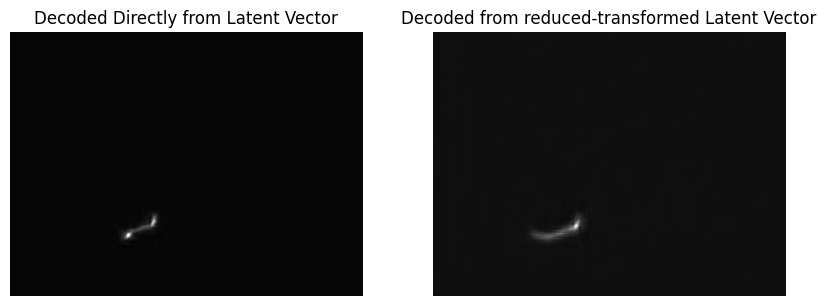

In [ ]:
check_reduction(latent_vectors, latent_red, red_model, model,method=METHOD)

### Generate gifs for visualization

In [ ]:
# Generate GIFs for each block
block_gif_paths = []
random_points_blocks = []
# Generate GIF for latent space
latent_space_gif_path = 'latent_space.gif'
if n_reduce_comp==2: # if it's actually 2d
  for i in range(n_blocks):
      block_gif_path = f'block_{i}.gif'
      random_points_per_block = generate_gif_for_block(red_model, model, block_boundaries[i], block_gif_path, n_frames=10, frame_duration=1000, method=METHOD) # random_point_per_block.shape = (n_frames,2)
      block_gif_paths.append(block_gif_path)
      random_points_blocks.append(random_points_per_block)
  generate_latent_space_gif(latent_red, random_points_blocks, latent_space_gif_path, n_blocks, n_frames=10, frame_duration=1000)
else:
  decode_path_name = 'decoded'
  latent_path_name = 'latent'
  random_values_for_dims = generate_gif_for_spectrum(red_model, model, latent_red, n_reduce_comp, decode_path_name, n_frames=10, frame_duration=1000, method=METHOD)
  generate_gif_for_dimensions(latent_red, random_values_for_dims, latent_path_name, n_reduce_comp,num_frames=10, frame_duration=1000)

In [ ]:
# Display latent space and block GIFs
if n_reduce_comp==2: # if it's actually 2d
  display_latent_space_and_block_gifs(latent_space_gif_path, block_gif_paths, n_blocks)
else:
  display_latent_space_and_decoded_gifs(latent_path_name, decode_path_name,  n_reduce_comp)

### Explore latent space
*(you might have to wait a bot before the image shows after moving on one spectru, expecially if you have a high number of components)*

In [ ]:
if n_reduce_comp>2:
  generate_slider_for_dimension(latent_red, red_model, model, n_reduce_comp, method=METHOD)